In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn import preprocessing
from sklearn.manifold import TSNE
from nltk import word_tokenize
from nltk.corpus import stopwords

import re
import spacy
import sys
import time
from spacy.lang.ru import Russian
from spacy.matcher import Matcher

import gensim, logging
import wget
from gensim.models import KeyedVectors
from gensim import models

In [2]:
data = pd.read_excel('C:/Users/User/Desktop/dtml/documentation_flow.xlsx')
data

,Номер,ТемаОбращения,Обращение,ОтветИсполнителя
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...
...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16830 entries, 0 to 16829
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Номер             16830 non-null  int64 
 1   ТемаОбращения     16830 non-null  object
 2   Обращение         16830 non-null  object
 3   ОтветИсполнителя  16830 non-null  object
dtypes: int64(1), object(3)
memory usage: 526.1+ KB


In [4]:
data.isnull().sum()

Номер               0
ТемаОбращения       0
Обращение           0
ОтветИсполнителя    0
dtype: int64

In [3]:
dataset = data.copy()
dataset

,Номер,ТемаОбращения,Обращение,ОтветИсполнителя
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...
...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...


In [4]:
dataset = dataset.rename(columns={'Номер': 'number',
                        'ТемаОбращения': 'theme_of_appeal',
                        'Обращение': 'appeal',
                        'ОтветИсполнителя': 'executive_reply'})
dataset

,number,theme_of_appeal,appeal,executive_reply
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...
...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...


In [7]:
dataset.describe()

,number
count,16830.000000
mean,255084.836898
std,30997.546831
min,186403.000000
25%,231380.500000
50%,254218.500000
75%,282124.000000
max,308056.000000


In [8]:
dataset.number.nunique()

16830

In [9]:
dataset.theme_of_appeal.nunique()

13423

In [10]:
dataset.theme_of_appeal.value_counts()

ЕГАИС                                                                                               111
Остатки ЕГАИС                                                                                        69
УТМ                                                                                                  68
Лицензия на вид деятельности не действует                                                            49
Акт постановки на баланс                                                                             45
                                                                                                   ... 
Ошибка при пробитии чека                                                                              1
просим разрешение на возможность отправить корректировочную декларацию по Ф-12 за 4 квартал.2016      1
Загрузка номенклатуры из ЕГАИС                                                                        1
Проблема отправки Акта подтверждения накладной TTN-0129197578   

In [11]:
dataset.appeal.nunique()

16681

In [12]:
dataset.appeal.value_counts()

<Пустая строка>                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             16
На домашней странице Лицензия на вид деятельности не действует. Запрос СИО возвращает 0 в тэге Лицензия                                                                                                                                                                                                                                                                                                  

In [13]:
dataset.executive_reply.nunique()

13786

In [14]:
dataset.executive_reply.value_counts()

Заявка закрыта пользователем в ЛК                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           519
Просьба не создавать дублирующих обращений по одной проблеме, а вести переписку в одной заявке.  В ответ на Ваши обращения Вам даются рекомендации и заявка переводиться в статус "выполнено", после выполнения рекомендаций если проблема не решена, Вы можете добавить описание, после этого заявка автоматически будет переоткрыта + будет видна вся история Вашей проблемы.  Также рекомендуем вести

In [15]:
label_encoder = preprocessing.LabelEncoder()
dataset['theme_of_appeal']= label_encoder.fit_transform(dataset['theme_of_appeal'])
dataset['appeal']= label_encoder.fit_transform(dataset['appeal'])
dataset['executive_reply']= label_encoder.fit_transform(dataset['executive_reply'])

In [16]:
quantative_df = dataset
quantative_df

,number,theme_of_appeal,appeal,executive_reply
0,265711,10918,9206,10645
1,265712,11306,4787,10645
2,265714,9030,11137,10645
3,265715,9132,13833,10645
4,265723,5086,14029,1410
...,...,...,...,...
16825,308044,485,7223,1961
16826,308046,3947,5741,6193
16827,308048,9012,3426,1849
16828,308052,8635,12465,1976


In [17]:
quantative_df.number.nunique()

16830

In [18]:
quantative_df.theme_of_appeal.nunique()

13423

In [19]:
quantative_df.appeal.nunique()

16681

In [20]:
quantative_df.executive_reply.nunique()

13786

# число тем обращений в зависимости от количества писем

<AxesSubplot:xlabel='theme_of_appeal'>

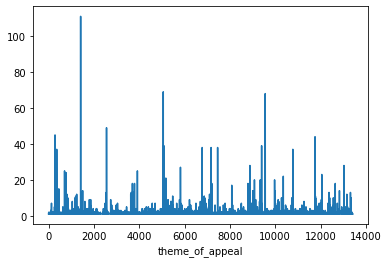

In [21]:
quantative_df.groupby('theme_of_appeal').number.nunique().plot()

<AxesSubplot:xlabel='theme_of_appeal', ylabel='number'>

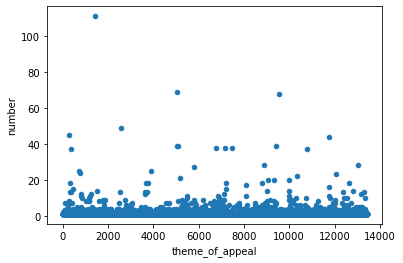

In [22]:
quantative_df_tofn = quantative_df.groupby('theme_of_appeal').number.nunique().to_frame().reset_index()
quantative_df_tofn.plot.scatter(x='theme_of_appeal', y='number')

# число обращений в зависимости от темы письма

<AxesSubplot:xlabel='appeal'>

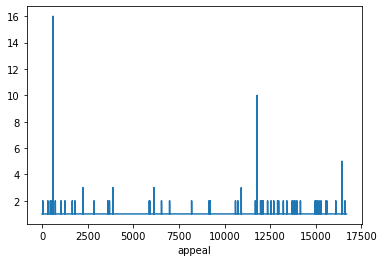

In [23]:
quantative_df.groupby('appeal').theme_of_appeal.nunique().plot()

<AxesSubplot:xlabel='appeal', ylabel='theme_of_appeal'>

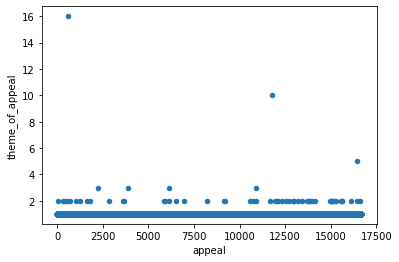

In [24]:
quantative_df_atoa = quantative_df.groupby('appeal').theme_of_appeal.nunique().to_frame().reset_index()
quantative_df_atoa.plot.scatter(x='appeal', y='theme_of_appeal')

# число ответов в зависимости от темы письма

<AxesSubplot:xlabel='executive_reply'>

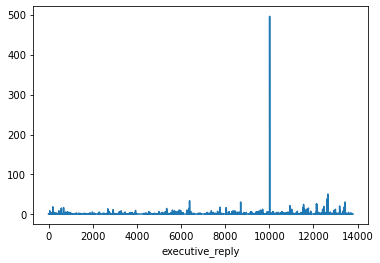

In [25]:
quantative_df.groupby('executive_reply').theme_of_appeal.nunique().plot()

<AxesSubplot:xlabel='executive_reply', ylabel='theme_of_appeal'>

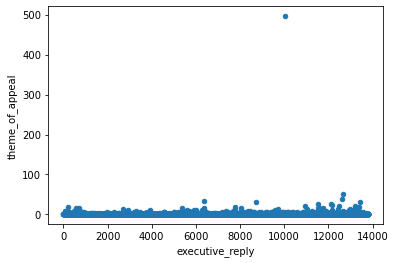

In [26]:
quantative_df_ertoa = quantative_df.groupby('executive_reply').theme_of_appeal.nunique().to_frame().reset_index()
quantative_df_ertoa.plot.scatter(x='executive_reply', y='theme_of_appeal')

# корреляция столбцов

<AxesSubplot:>

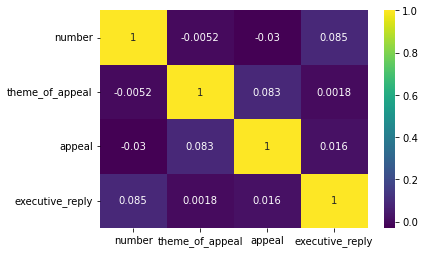

In [27]:
sns.heatmap(quantative_df.corr(), annot=True, cmap='viridis')

# text preprocess

In [3]:
data = data.rename(columns={'Номер': 'number',
                            'ТемаОбращения': 'theme_of_appeal',
                            'Обращение': 'appeal',
                            'ОтветИсполнителя': 'executive_reply'})
df_text = data.copy()
df_text

,number,theme_of_appeal,appeal,executive_reply
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...
...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...


In [4]:
def preprocess(row):
    nlp = spacy.load('ru_core_news_sm')
    matcher = Matcher(nlp.vocab)
    
    pattern = [{'LOWER': {'REGEX':'(январь|февраль|март|апрель|май|июнь|июль|август \
                        |сентябрь|октябрь|ноябрь|декабрь|год|лет|здравствовать|добрый|день|утро|вечер)'}}]
    matcher.add('date_pattern', [pattern])
        
    text_punct = re.sub(r"[!#$%&'()*+,./:;<=>?@[\]^_`{|}~—\"\-]", ' ', row)
    text_clear = re.sub(r'[^а-яА-ЯёЁ]', ' ', text_punct)
    text_token = word_tokenize(text_clear, language='russian')
    stop = set(stopwords.words('russian'))
    text_stop = ' '.join([word for word in text_token if word not in stop])
    
    doc = nlp(text_stop)
    text_lemmed = [token.lemma_ for token in doc if token.pos_!='PROPN']
    doc = nlp(' '.join(text_lemmed))
    
    match = matcher(doc)
    matched, month_year = [], []
    
    for match_id, start, end in match:
        matched_span = doc[start:end]
        matched.append(matched_span.text)

    for token in doc:
        if token.text not in matched:
            month_year.append(token.text)
    
    doc = nlp(' '.join(month_year))
    result = []
    
    for token in doc:
        if token.pos_!='PROPN' and token.pos_!='NUM' and token.text + '_' + token.pos_ not in result:
            result.append(token.text + '_' + token.pos_)
                        
    return result

# test appeal

In [5]:
df_test = df_text.iloc[0:4, 0:5]
df_test

,number,theme_of_appeal,appeal,executive_reply
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...


In [8]:
start_time = time.perf_counter()    
df_test['appeal_handled'] = df_test['appeal'].apply(preprocess)
print("--- {:.3f} ms ---".format(((time.perf_counter() - start_time)*1000)))
df_test

--- 7555.437 ms ---


,number,theme_of_appeal,appeal,executive_reply,appeal_handled
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт..."


In [62]:
# def vectorize(words):
#     for word in words:
#         if word in model:
#             vector = model.get_vector(word, norm=False)
#     return vector

In [63]:
# df_test['appeal_handled'] = df_test['appeal_handled'].apply(vectorize)
df_test['vector'] = df_test['appeal_handled'].apply(vectorize)
df_test

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,vector
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[-0.78918916, -0.18172592, -0.12153929, 0.2485..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[0.5746364, 1.7995328, -0.93927366, 0.3143414,..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[0.5746364, 1.7995328, -0.93927366, 0.3143414,..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.5746364, 1.7995328, -0.93927366, 0.3143414,..."


# actual preprocessing

In [5]:
df_text['appeal_handled'] = df_text['appeal'].apply(preprocess)

In [6]:
df_text

,number,theme_of_appeal,appeal,executive_reply,appeal_handled
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт..."
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,"[при_ADP, запрос_NOUN, остаток_NOUN, приходить..."
...,...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...,"[г_CCONJ, произвести_VERB, запрос_NOUN, отмена..."
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...,"[покупатель_NOUN, ошибочно_ADV, выставить_VERB..."
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref...","[при_ADP, попытка_NOUN, списать_VERB, возвраща..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...,"[нужный_ADJ, регистрировать_VERB, безалкогольн..."


# vectorizing appeal handled

In [7]:
model_path = 'C:/Users/User/Desktop/dtml/practice/model/model.bin'
model = models.KeyedVectors.load_word2vec_format(model_path, binary=True)

In [8]:
def vectorize(words):
    for word in words:
        if word in model:
            vctr = model.get_vector(word, norm=False)
            return vctr

In [9]:
df_text['appeal_vectors'] = df_text['appeal_handled'].apply(vectorize)

In [10]:
df_text

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ..."
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,"[при_ADP, запрос_NOUN, остаток_NOUN, приходить...","[0.99847466, 1.090976, 0.29902545, -1.3471756,..."
...,...,...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...,"[г_CCONJ, произвести_VERB, запрос_NOUN, отмена...","[-0.8410901, 0.7092217, 0.34231523, -0.1982658..."
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...,"[покупатель_NOUN, ошибочно_ADV, выставить_VERB...","[1.3044138, -0.026074613, 0.06581817, 2.135367..."
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref...","[при_ADP, попытка_NOUN, списать_VERB, возвраща...","[2.0353484, 0.6325637, -0.5430524, 0.060984828..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...,"[нужный_ADJ, регистрировать_VERB, безалкогольн...","[2.6247764, -0.4687014, 1.938589, 0.5770947, -..."


# test theme of appeal

In [44]:
df_temp = df_text.copy()
df_temp

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ..."
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,"[при_ADP, запрос_NOUN, остаток_NOUN, приходить...","[0.99847466, 1.090976, 0.29902545, -1.3471756,..."
...,...,...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...,"[г_CCONJ, произвести_VERB, запрос_NOUN, отмена...","[-0.8410901, 0.7092217, 0.34231523, -0.1982658..."
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...,"[покупатель_NOUN, ошибочно_ADV, выставить_VERB...","[1.3044138, -0.026074613, 0.06581817, 2.135367..."
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref...","[при_ADP, попытка_NOUN, списать_VERB, возвраща...","[2.0353484, 0.6325637, -0.5430524, 0.060984828..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...,"[нужный_ADJ, регистрировать_VERB, безалкогольн...","[2.6247764, -0.4687014, 1.938589, 0.5770947, -..."


In [102]:
df_test1 = df_temp.iloc[0:4, 0:6]
df_test1

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ..."


In [103]:
df_test1['theme_handled'] = df_test1['theme_of_appeal'].apply(preprocess)

In [104]:
df_test1

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors,theme_handled
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[корректный_ADJ, остаток_NOUN]"
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[списываться_VERB, крепкий_ADJ, алкоголь_NOUN]"
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[списание_NOUN, алкоголь_NOUN]"
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[списание_NOUN, проданного_VERB, товар_NOUN]"


# theme of appeal preprocessing and vectorizing

In [11]:
df_text['theme_handled'] = df_text['theme_of_appeal'].apply(preprocess)

In [12]:
df_text

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors,theme_handled
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[корректный_ADJ, остаток_NOUN]"
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[списываться_VERB, крепкий_ADJ, алкоголь_NOUN]"
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[списание_NOUN, алкоголь_NOUN]"
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[списание_NOUN, проданного_VERB, товар_NOUN]"
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,"[при_ADP, запрос_NOUN, остаток_NOUN, приходить...","[0.99847466, 1.090976, 0.29902545, -1.3471756,...",[остаток_NOUN]
...,...,...,...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...,"[г_CCONJ, произвести_VERB, запрос_NOUN, отмена...","[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[аннулирование_NOUN, отмена_NOUN, проведение_N..."
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...,"[покупатель_NOUN, ошибочно_ADV, выставить_VERB...","[1.3044138, -0.026074613, 0.06581817, 2.135367...","[не_PART, распроводится_VERB, акт_NOUN]"
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref...","[при_ADP, попытка_NOUN, списать_VERB, возвраща...","[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[списание_NOUN, регистр_NOUN]"
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...,"[нужный_ADJ, регистрировать_VERB, безалкогольн...","[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[регистрация_NOUN, безалкогольный_ADJ, пиво_NOUN]"


In [13]:
df_text['theme_vectors'] = df_text['theme_handled'].apply(vectorize)

In [14]:
df_text

,number,theme_of_appeal,appeal,executive_reply,appeal_handled,appeal_vectors,theme_handled,theme_vectors
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,"[иметь_VERB, торговый_ADJ, точка_NOUN, окончан...","[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[корректный_ADJ, остаток_NOUN]","[-3.8374505, -0.6890573, -0.82930475, -1.14456..."
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,"[перестать_VERB, списываться_VERB, крепкий_ADJ...","[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[списываться_VERB, крепкий_ADJ, алкоголь_NOUN]","[0.057155523, 0.15958121, 0.21566954, -0.20913..."
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,"[получить_VERB, ответ_NOUN, остаток_NOUN, алко...","[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[списание_NOUN, алкоголь_NOUN]","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,"[последний_ADJ, проданное_ADJ, товар_NOUN, авт...","[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[списание_NOUN, проданного_VERB, товар_NOUN]","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,"[при_ADP, запрос_NOUN, остаток_NOUN, приходить...","[0.99847466, 1.090976, 0.29902545, -1.3471756,...",[остаток_NOUN],"[1.98287, 2.015517, 1.1796441, -0.06054496, 0...."
...,...,...,...,...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...,"[г_CCONJ, произвести_VERB, запрос_NOUN, отмена...","[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[аннулирование_NOUN, отмена_NOUN, проведение_N...","[0.21544431, -0.8563433, 0.7082847, -0.5841852..."
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...,"[покупатель_NOUN, ошибочно_ADV, выставить_VERB...","[1.3044138, -0.026074613, 0.06581817, 2.135367...","[не_PART, распроводится_VERB, акт_NOUN]","[1.0758052, -0.018568238, -2.2764711, -2.73765..."
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref...","[при_ADP, попытка_NOUN, списать_VERB, возвраща...","[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[списание_NOUN, регистр_NOUN]","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...,"[нужный_ADJ, регистрировать_VERB, безалкогольн...","[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[регистрация_NOUN, безалкогольный_ADJ, пиво_NOUN]","[-2.2577205, 0.39125493, -0.7241018, 0.0826437..."


In [129]:
df_text.to_parquet('df_prepr_vect.parquet.gzip', compression='gzip')

## new df with vectors columns

In [15]:
vectors = df_text[['number','appeal_vectors','theme_vectors']].copy()
vectors

,number,appeal_vectors,theme_vectors
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456..."
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913..."
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0...."
...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852..."
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765..."
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437..."


# deal w/ na values 

In [16]:
vectors1 = vectors.copy()
vectors1

,number,appeal_vectors,theme_vectors
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456..."
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913..."
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0...."
...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852..."
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765..."
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437..."


In [74]:
vectors1.head(30)

,number,appeal_vectors,theme_vectors
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456..."
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913..."
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0...."
5,265724,"[-0.10531808, 1.8668524, -0.5609431, 0.854738,...","[1.7904179, 0.20355925, 0.4163824, -3.5637174,..."
6,265741,"[1.3209813, -1.7539799, 2.738232, -2.549735, 0...","[-0.29302666, 0.37775055, -0.3715782, -0.13764..."
7,265749,"[0.68348336, -0.08681489, -0.96591514, -0.2623...","[0.15747015, -1.4667547, -2.5294244, 1.6178174..."
8,265750,"[0.91902304, 0.23160839, -1.3767406, -0.055478...","[1.0758052, -0.018568238, -2.2764711, -2.73765..."
9,265754,"[0.2692829, 0.898276, -0.42122656, -0.10044615...","[0.15747015, -1.4667547, -2.5294244, 1.6178174..."


In [66]:
vectors1.appeal_vectors.isna().value_counts()

False    16746
True        84
Name: appeal_vectors, dtype: int64

In [67]:
vectors1.theme_vectors.isna().value_counts()

False    15877
True       953
Name: theme_vectors, dtype: int64

In [68]:
na_list_appeal = np.where(vectors1['appeal_vectors'].isnull())
na_list_appeal

(array([   97,   173,   305,   610,   695,   833,  1465,  1491,  1603,
         1615,  1616,  1647,  1774,  1815,  1840,  1843,  1864,  1879,
         2114,  2266,  2406,  2776,  2782,  2982,  2996,  3996,  4620,
         5365,  5549,  5996,  6081,  6130,  6157,  6725,  6736,  7083,
         7344,  7742,  8053,  8371,  8710,  8851,  8882,  8990,  9248,
         9664,  9868,  9876, 10082, 10129, 10182, 10908, 10931, 10977,
        11021, 11088, 11428, 11431, 11644, 11685, 11690, 11698, 11702,
        11712, 11944, 12032, 12696, 12870, 13118, 13225, 13229, 13417,
        13663, 13804, 13968, 14516, 15102, 15681, 15694, 15792, 16473,
        16610, 16649, 16709], dtype=int64),)

In [69]:
na_list_theme = np.where(vectors1['theme_vectors'].isnull())
na_list_theme

(array([   21,    26,    81,    83,   153,   180,   216,   225,   262,
          273,   352,   367,   378,   387,   390,   414,   473,   510,
          577,   582,   583,   618,   626,   642,   664,   705,   722,
          727,   730,   738,   741,   752,   779,   785,   815,   846,
          851,   882,   893,   895,   924,   933,   948,   954,   955,
          978,   987,   990,  1008,  1016,  1132,  1148,  1169,  1172,
         1184,  1224,  1240,  1250,  1258,  1290,  1314,  1315,  1318,
         1322,  1347,  1359,  1368,  1388,  1398,  1423,  1429,  1434,
         1460,  1476,  1479,  1491,  1500,  1549,  1551,  1562,  1675,
         1709,  1714,  1765,  1801,  1802,  1814,  1815,  1827,  1830,
         1859,  1899,  1913,  1915,  1917,  1940,  1951,  1964,  1967,
         1985,  2002,  2026,  2027,  2028,  2061,  2089,  2127,  2143,
         2199,  2255,  2263,  2265,  2266,  2288,  2292,  2297,  2314,
         2325,  2330,  2347,  2357,  2386,  2433,  2434,  2435,  2439,
      

In [70]:
na_list = np.where(vectors1.isnull())
na_list

(array([   21,    26,    81, ..., 16757, 16780, 16803], dtype=int64),
 array([2, 2, 2, ..., 2, 2, 2], dtype=int64))

In [16]:
vectors.shape

(16830, 3)

In [16]:
vectors = vectors.dropna()
vectors

,number,appeal_vectors,theme_vectors
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456..."
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913..."
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0...."
...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852..."
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765..."
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995..."
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437..."


In [127]:
vectors.to_parquet('df_vectors.parquet.gzip', compression='gzip')

## arrays of vectors

In [77]:
len(vectors)

15808

In [17]:
appeal_vecs_arr = [vectors.iloc[i]['appeal_vectors'].tolist() for i in range(len(vectors))]
appeal_vecs_arr

[[1.2040363550186157,
  0.025989476591348648,
  3.53788685798645,
  -2.005908727645874,
  -4.105312824249268,
  -0.6368656754493713,
  -0.5914725065231323,
  2.7201688289642334,
  0.014126553200185299,
  -0.41031062602996826,
  -0.5149650573730469,
  -0.8156659603118896,
  0.2143644094467163,
  0.05224013701081276,
  0.5773990154266357,
  1.1124595403671265,
  3.3109076023101807,
  0.5725933909416199,
  -1.223571538925171,
  -0.5158008933067322,
  1.876680612564087,
  -2.043815851211548,
  1.3746687173843384,
  -1.4279865026474,
  0.8782446384429932,
  1.7668325901031494,
  -3.5916075706481934,
  -3.906318187713623,
  -0.6386239528656006,
  -1.4718090295791626,
  -0.31263381242752075,
  -3.644619941711426,
  0.7932236790657043,
  -5.610710620880127,
  -1.1760447025299072,
  2.3838353157043457,
  1.3344646692276,
  -2.413846731185913,
  2.6975252628326416,
  0.07071801275014877,
  0.5714132189750671,
  0.7760500907897949,
  0.34172892570495605,
  4.566463470458984,
  -1.6358104944229126

In [18]:
theme_vecs_arr = [vectors.iloc[i]['theme_vectors'].tolist() for i in range(len(vectors))]
theme_vecs_arr

[[-3.8374505043029785,
  -0.6890572905540466,
  -0.8293047547340393,
  -1.1445645093917847,
  -1.3267813920974731,
  -3.8871304988861084,
  -0.2932802438735962,
  2.0254836082458496,
  0.944348156452179,
  0.534233808517456,
  -1.6119155883789062,
  -0.25853216648101807,
  -0.09335377812385559,
  1.1865428686141968,
  -0.10048071295022964,
  1.288224458694458,
  0.8672908544540405,
  -0.8512331247329712,
  1.7448643445968628,
  -0.5634219646453857,
  1.1413599252700806,
  -0.6957752704620361,
  -1.857828974723816,
  -1.0041085481643677,
  -0.24668221175670624,
  -0.05342997610569,
  -1.2950010299682617,
  -1.3176276683807373,
  -0.3555923104286194,
  1.9474667310714722,
  -2.2443549633026123,
  -0.9173514246940613,
  -2.170396566390991,
  -0.08489148318767548,
  0.8476040363311768,
  -0.7599053978919983,
  1.099023461341858,
  0.7077016234397888,
  -1.2650256156921387,
  0.6943880915641785,
  1.2829890251159668,
  -0.2877005338668823,
  0.3345685601234436,
  1.0197495222091675,
  -0.74

## scaler

In [20]:
from sklearn.preprocessing import MinMaxScaler

In [23]:
X = theme_vecs_arr
X

[[-3.8374505043029785,
  -0.6890572905540466,
  -0.8293047547340393,
  -1.1445645093917847,
  -1.3267813920974731,
  -3.8871304988861084,
  -0.2932802438735962,
  2.0254836082458496,
  0.944348156452179,
  0.534233808517456,
  -1.6119155883789062,
  -0.25853216648101807,
  -0.09335377812385559,
  1.1865428686141968,
  -0.10048071295022964,
  1.288224458694458,
  0.8672908544540405,
  -0.8512331247329712,
  1.7448643445968628,
  -0.5634219646453857,
  1.1413599252700806,
  -0.6957752704620361,
  -1.857828974723816,
  -1.0041085481643677,
  -0.24668221175670624,
  -0.05342997610569,
  -1.2950010299682617,
  -1.3176276683807373,
  -0.3555923104286194,
  1.9474667310714722,
  -2.2443549633026123,
  -0.9173514246940613,
  -2.170396566390991,
  -0.08489148318767548,
  0.8476040363311768,
  -0.7599053978919983,
  1.099023461341858,
  0.7077016234397888,
  -1.2650256156921387,
  0.6943880915641785,
  1.2829890251159668,
  -0.2877005338668823,
  0.3345685601234436,
  1.0197495222091675,
  -0.74

In [24]:
scaler = MinMaxScaler()

In [25]:
X_scaled = scaler.fit_transform(X)

# Running k-means and computing inter-cluster distance score for various k values

In [26]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

In [27]:
from sklearn.mixture import GaussianMixture

## km-scores for 2-50 clusters

In [81]:
km_scores= []
km_silhouette = []
db_score = []
for i in range(2, 71):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    preds = km.predict(X_scaled)
    
    print("Score for number of clusters {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))
    
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of clusters {}: {}".format(i,silhouette))
    
    db = davies_bouldin_score(X_scaled,preds)
    db_score.append(db)
    print("Davies Bouldin score for number of clusters {}: {}".format(i,db))
    print("-"*100)

Score for number of clusters 2: -95136.34205641672
Silhouette score for number of clusters 2: 0.1543577956191517
Davies Bouldin score for number of clusters 2: 2.624792484269694
----------------------------------------------------------------------------------------------------
Score for number of clusters 3: -89161.94043239886
Silhouette score for number of clusters 3: 0.15391332241304886
Davies Bouldin score for number of clusters 3: 1.5322839360873814
----------------------------------------------------------------------------------------------------
Score for number of clusters 4: -85270.22258598135
Silhouette score for number of clusters 4: 0.16393119384573054
Davies Bouldin score for number of clusters 4: 2.642441577269457
----------------------------------------------------------------------------------------------------
Score for number of clusters 5: -81765.5492680384
Silhouette score for number of clusters 5: 0.15260681805273119
Davies Bouldin score for number of clusters 5: 

Silhouette score for number of clusters 31: 0.40070092869156954
Davies Bouldin score for number of clusters 31: 1.5859311888827416
----------------------------------------------------------------------------------------------------
Score for number of clusters 32: -43816.8699512429
Silhouette score for number of clusters 32: 0.40670701293625233
Davies Bouldin score for number of clusters 32: 1.3601764997432226
----------------------------------------------------------------------------------------------------
Score for number of clusters 33: -43515.14224993801
Silhouette score for number of clusters 33: 0.4049511463463463
Davies Bouldin score for number of clusters 33: 1.5023693586616507
----------------------------------------------------------------------------------------------------
Score for number of clusters 34: -42892.92612573615
Silhouette score for number of clusters 34: 0.40724067898382077
Davies Bouldin score for number of clusters 34: 1.4417715515103904
-------------------

Silhouette score for number of clusters 60: 0.532106211026909
Davies Bouldin score for number of clusters 60: 1.308446927202453
----------------------------------------------------------------------------------------------------
Score for number of clusters 61: -31369.65200288897
Silhouette score for number of clusters 61: 0.5275001089100662
Davies Bouldin score for number of clusters 61: 1.465269238191333
----------------------------------------------------------------------------------------------------
Score for number of clusters 62: -30820.167070910775
Silhouette score for number of clusters 62: 0.5073152205305413
Davies Bouldin score for number of clusters 62: 1.3802415471584457
----------------------------------------------------------------------------------------------------
Score for number of clusters 63: -31001.517066999197
Silhouette score for number of clusters 63: 0.505146751678801
Davies Bouldin score for number of clusters 63: 1.3471198349335365
-----------------------

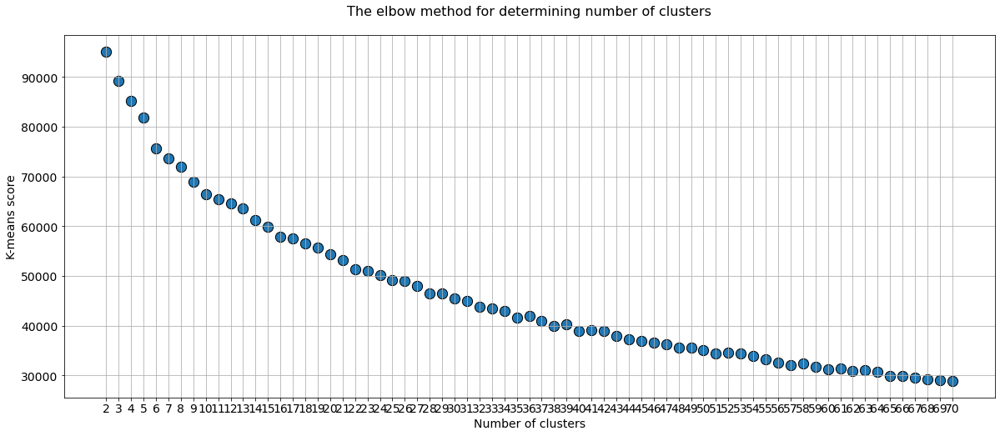

In [93]:
plt.figure(figsize=(20,8))
plt.title("The elbow method for determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2, 71)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("K-means score",fontsize=14)
plt.xticks([i for i in range(2, 71)],fontsize=14)
plt.yticks(fontsize=14)
plt.show()

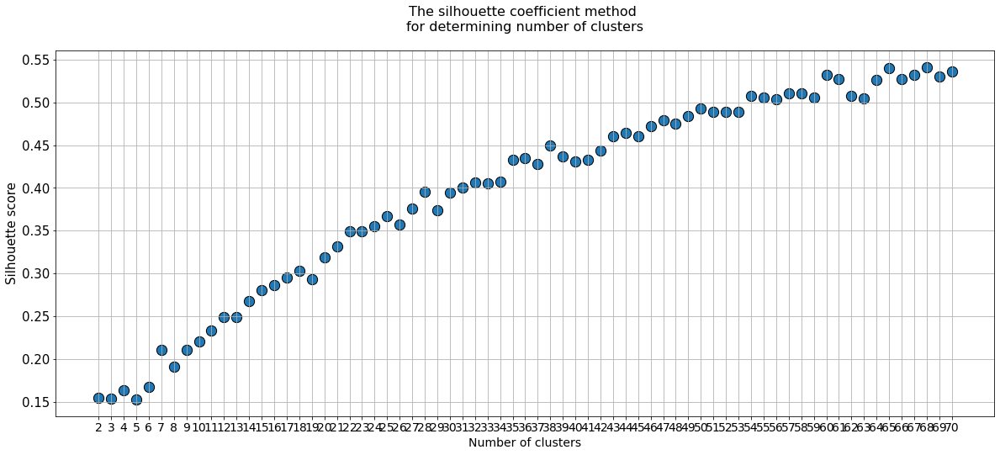

In [94]:
plt.figure(figsize=(20,8))
plt.title("The silhouette coefficient method \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2, 71)],y=km_silhouette,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Silhouette score",fontsize=15)
plt.xticks([i for i in range(2, 71)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

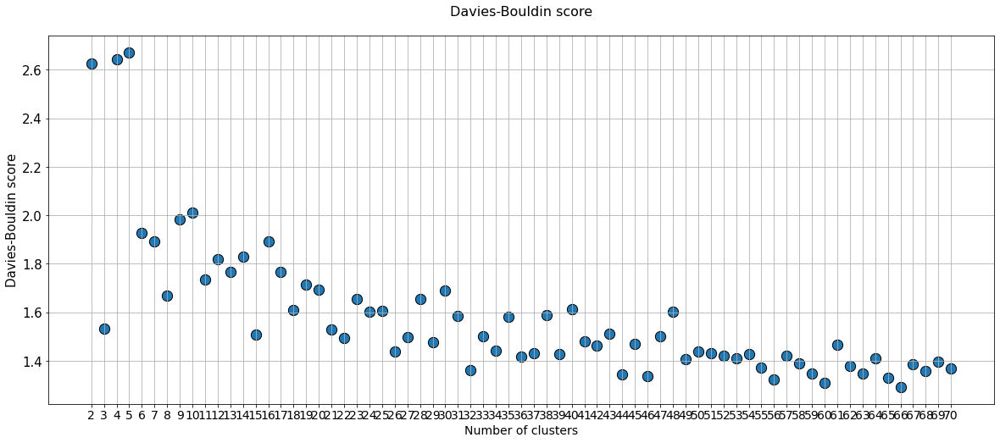

In [95]:
plt.figure(figsize=(20,8))
plt.title("Davies-Bouldin score\n",fontsize=16)
plt.scatter(x=[i for i in range(2,71)],y=db_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Davies-Bouldin score",fontsize=15)
plt.xticks([i for i in range(2, 71)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

## BIC n Log-likelihood score for 2-19 clusters

In [160]:
gm_bic= []
gm_score=[]
for i in range(2, 20):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_scaled)
    print("BIC for number of clusters {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of clusters {}: {}".format(i,gm.score(X_scaled)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_scaled))
    gm_score.append(gm.score(X_scaled))

BIC for number of clusters 2: -16393098.196136588
Log-likelihood score for number of clusters 2: 546.3042047218145
----------------------------------------------------------------------------------------------------
BIC for number of clusters 3: -20394045.41275691
Log-likelihood score for number of clusters 3: 686.7514409607497
----------------------------------------------------------------------------------------------------
BIC for number of clusters 4: -23685936.5156359
Log-likelihood score for number of clusters 4: 804.7715480960246
----------------------------------------------------------------------------------------------------
BIC for number of clusters 5: -26438350.907804582
Log-likelihood score for number of clusters 5: 905.7282471243186
----------------------------------------------------------------------------------------------------
BIC for number of clusters 6: -27992433.316331558
Log-likelihood score for number of clusters 6: 968.7822391801395
------------------------

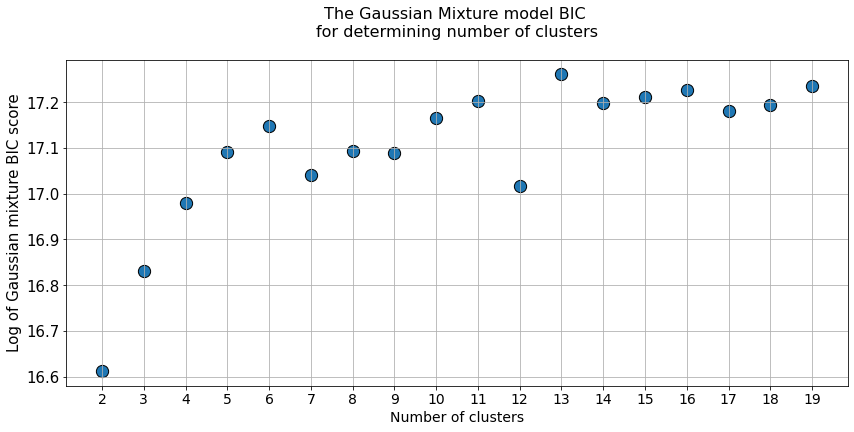

In [164]:
plt.figure(figsize=(14,6))
plt.title("The Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2, 20)],y=np.log(gm_bic),s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Log of Gaussian mixture BIC score",fontsize=15)
plt.xticks([i for i in range(2, 20)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

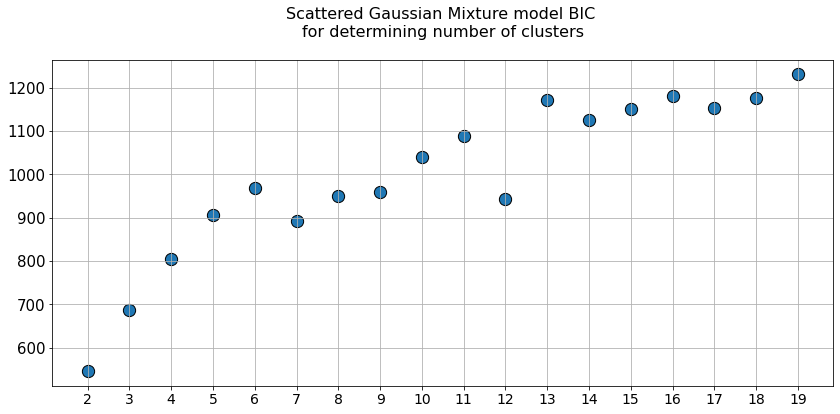

In [165]:
plt.figure(figsize=(14,6))
plt.title("Scattered Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2, 20)],y=gm_score,s=150,edgecolor='k')
plt.grid(True)
plt.xticks([i for i in range(2, 20)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

## km-scores for 50-100 clusters

In [30]:
n, m = 50,101

In [33]:
km_scores= []
km_silhouette = []
db_score = []
for i in range(n, m):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    preds = km.predict(X_scaled)
    
    print("Score for number of clusters {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))
    
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of clusters {}: {}".format(i,silhouette))
    
    db = davies_bouldin_score(X_scaled,preds)
    db_score.append(db)
    print("Davies Bouldin score for number of clusters {}: {}".format(i,db))
    print("-"*100)

Score for number of clusters 50: -35036.87947083806
Silhouette score for number of clusters 50: 0.4926094838416301
Davies Bouldin score for number of clusters 50: 1.4390260234888124
----------------------------------------------------------------------------------------------------
Score for number of clusters 51: -34411.02424990422
Silhouette score for number of clusters 51: 0.48862699296325673
Davies Bouldin score for number of clusters 51: 1.4304512345983085
----------------------------------------------------------------------------------------------------
Score for number of clusters 52: -34619.83559985341
Silhouette score for number of clusters 52: 0.4893007603666376
Davies Bouldin score for number of clusters 52: 1.419367432383584
----------------------------------------------------------------------------------------------------
Score for number of clusters 53: -34331.86604140061
Silhouette score for number of clusters 53: 0.48913970835143883
Davies Bouldin score for number of 

Score for number of clusters 79: -26315.01323641464
Silhouette score for number of clusters 79: 0.5649227477823883
Davies Bouldin score for number of clusters 79: 1.318319624081046
----------------------------------------------------------------------------------------------------
Score for number of clusters 80: -26075.482980548983
Silhouette score for number of clusters 80: 0.5619757018372271
Davies Bouldin score for number of clusters 80: 1.3713728873527045
----------------------------------------------------------------------------------------------------
Score for number of clusters 81: -26097.063967699454
Silhouette score for number of clusters 81: 0.5718734371065353
Davies Bouldin score for number of clusters 81: 1.279092424241272
----------------------------------------------------------------------------------------------------
Score for number of clusters 82: -25590.980422653694
Silhouette score for number of clusters 82: 0.5790153060916021
Davies Bouldin score for number of 

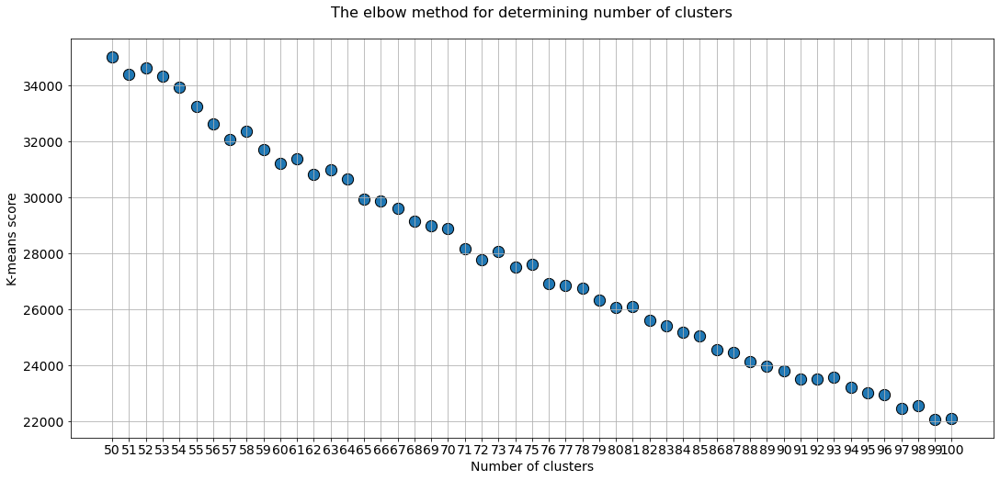

In [34]:
plt.figure(figsize=(18,8))
plt.title("The elbow method for determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(n, m)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("K-means score",fontsize=14)
plt.xticks([i for i in range(n, m)],fontsize=14)
plt.yticks(fontsize=14)
plt.show()

In [ ]:
# possible: 65 76 86

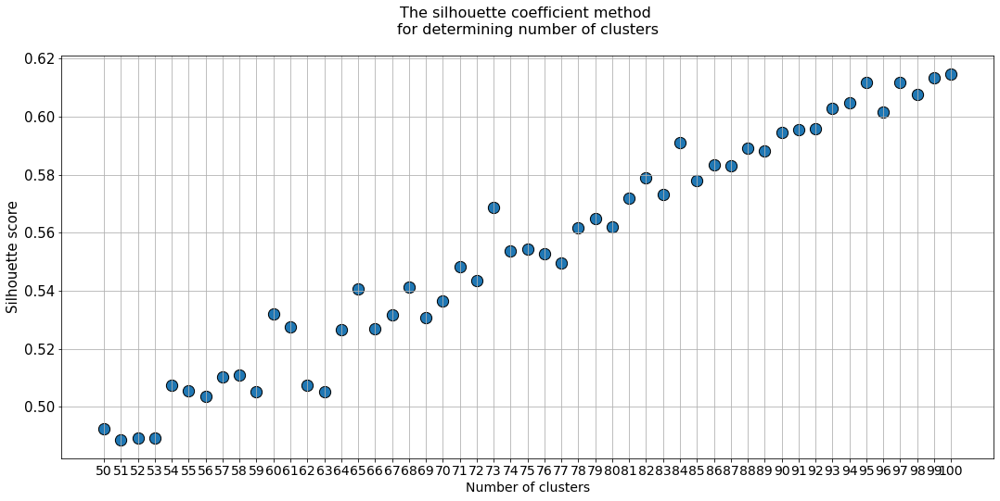

In [35]:
plt.figure(figsize=(18,8))
plt.title("The silhouette coefficient method \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(n, m)],y=km_silhouette,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Silhouette score",fontsize=15)
plt.xticks([i for i in range(n, m)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [ ]:
# highest point 100
# possible 54 60 65 73 84 95 

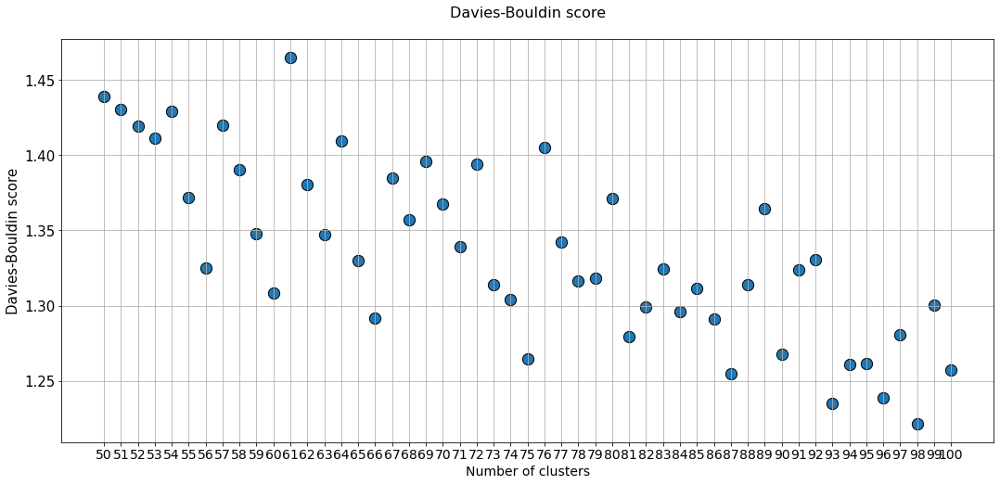

In [36]:
plt.figure(figsize=(18,8))
plt.title("Davies-Bouldin score\n",fontsize=16)
plt.scatter(x=[i for i in range(n, m)],y=db_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Davies-Bouldin score",fontsize=15)
plt.xticks([i for i in range(n, m)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [ ]:
# lowest point 98
# possible 56 60 66 75

In [37]:
gm_bic= []
gm_score=[]
for i in range(n, m):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_scaled)
    print("BIC for number of clusters {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of clusters {}: {}".format(i,gm.score(X_scaled)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_scaled))
    gm_score.append(gm.score(X_scaled))

BIC for number of clusters 50: -23631111.880482137
Log-likelihood score for number of clusters 50: 1442.394117779088
----------------------------------------------------------------------------------------------------
BIC for number of clusters 51: -24100181.064944804
Log-likelihood score for number of clusters 51: 1471.1296247620246
----------------------------------------------------------------------------------------------------
BIC for number of clusters 52: -22610226.337802064
Log-likelihood score for number of clusters 52: 1437.9020778606812
----------------------------------------------------------------------------------------------------
BIC for number of clusters 53: -23282432.67031141
Log-likelihood score for number of clusters 53: 1473.0627223703978
----------------------------------------------------------------------------------------------------
BIC for number of clusters 54: -21565196.976277553
Log-likelihood score for number of clusters 54: 1432.6463797045326
--------

BIC for number of clusters 88: -10671755.509203263
Log-likelihood score for number of clusters 88: 1560.6596350012462
----------------------------------------------------------------------------------------------------
BIC for number of clusters 89: -10527523.415975884
Log-likelihood score for number of clusters 89: 1569.9966957009703
----------------------------------------------------------------------------------------------------
BIC for number of clusters 90: -10046502.26635947
Log-likelihood score for number of clusters 90: 1568.6812685341386
----------------------------------------------------------------------------------------------------
BIC for number of clusters 91: -9737339.360768512
Log-likelihood score for number of clusters 91: 1572.801641089772
----------------------------------------------------------------------------------------------------
BIC for number of clusters 92: -9535186.53105174
Log-likelihood score for number of clusters 92: 1580.3066946889965
-----------

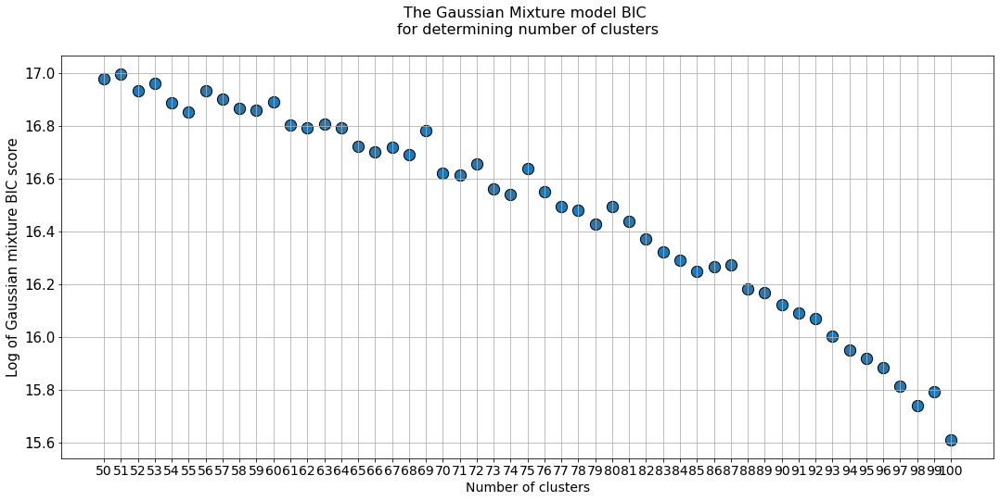

In [38]:
plt.figure(figsize=(18,8))
plt.title("The Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(n, m)],y=np.log(gm_bic),s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Log of Gaussian mixture BIC score",fontsize=15)
plt.xticks([i for i in range(n, m)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [ ]:
# highest point 51
# possible 56 60 75

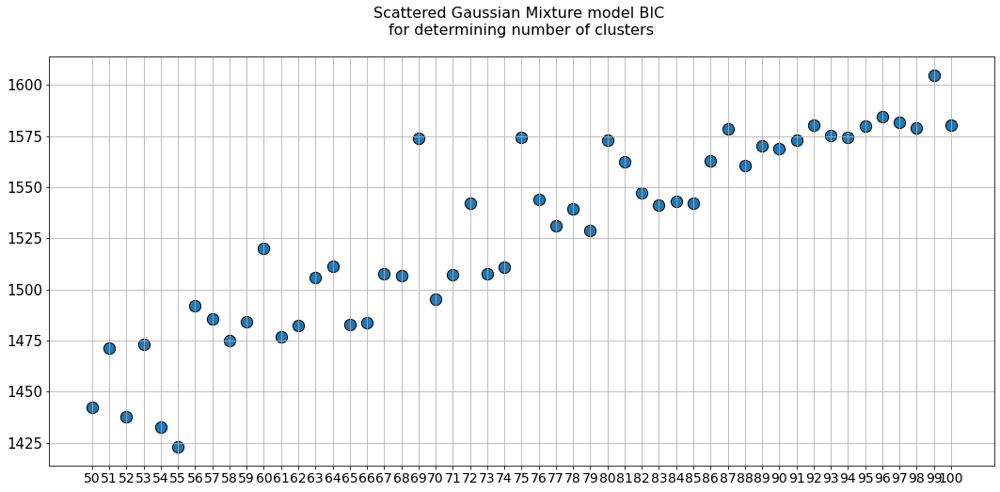

In [39]:
plt.figure(figsize=(18,8))
plt.title("Scattered Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(n, m)],y=gm_score,s=150,edgecolor='k')
plt.grid(True)
plt.xticks([i for i in range(n, m)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [ ]:
# reversed elbow method
# possible 72 92

In [ ]:
# possible: 65 76 86
# possible 54 60 65 73 84 95 
# possible 56 60 66 75
# possible 56 60 75 

In [ ]:
# frequency
2: 56 65 75
3: 60  

### km-scores for 100-140 clusters

In [133]:
km_scores= []
for i in range(100,141):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    
    print("Score for number of clusters {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))

Score for number of clusters 100: -22097.55662960131
Score for number of clusters 101: -22101.438963559583
Score for number of clusters 102: -21615.271975085645
Score for number of clusters 103: -21654.793577661883
Score for number of clusters 104: -21408.234900730175
Score for number of clusters 105: -21056.691629094774
Score for number of clusters 106: -21126.081105111458
Score for number of clusters 107: -20905.467375354718


KeyboardInterrupt: 

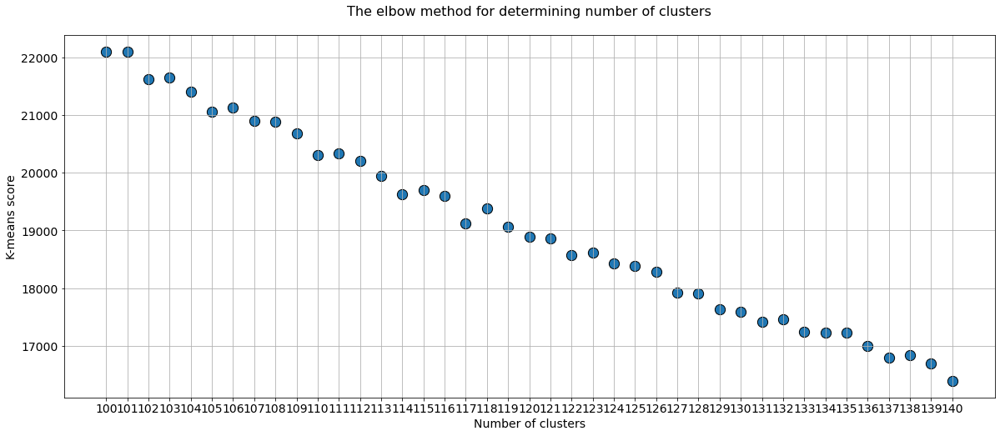

In [131]:
plt.figure(figsize=(20,8))
plt.title("The elbow method for determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(100,141)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("K-means score",fontsize=14)
plt.xticks([i for i in range(100,141)],fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# Density-Based Spatial Clustering of Applications with Noise - плотностной алгоритм пространственной кластеризации с присутствием шума
## for themes of appeals

In [ ]:
dbscan = DBSCAN()

# t-SNE (t-distributed stochastic neighbor embedding)

## for themes of appeals

In [147]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC

# K-Means clustering

## for themes of appeals

In [27]:
from collections import Counter
import statistics
from scipy.spatial.distance import cdist
from scipy.optimize import linear_sum_assignment

In [28]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [ ]:
def get_even_clusters(X, cluster_size):
    n_clusters = int(np.ceil(len(X)/cluster_size))
    kmeans = KMeans(n_clusters)
    kmeans.fit(X)
    centers = kmeans.cluster_centers_
    centers = centers.reshape(-1, 1, X.shape[-1]).repeat(cluster_size, 1).reshape(-1, X.shape[-1])
    distance_matrix = cdist(X, centers)
    clusters = linear_sum_assignment(distance_matrix)[1]//cluster_size
    return clusters

In [205]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
reduced_data

array([[-0.16771997,  0.07672025],
       [-0.53883562,  0.20690223],
       [-0.28575818, -0.29761772],
       ...,
       [-0.28575818, -0.29761772],
       [-0.02637979, -1.19891603],
       [-0.61359559,  0.16005684]])

In [ ]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km7 = KMeans(n_clusters=13, init="k-means++", n_init=10).fit(reduced_data)
centers = kmeans.cluster_centers_
centers = centers.reshape(-1, 1, X_scaled.shape[-1]).repeat(cluster_size, 1).reshape(-1, X_scaled.shape[-1])
distance_matrix = cdist(X_scaled, centers)
clusters = linear_sum_assignment(distance_matrix)[1]//cluster_size

## 7 clusters

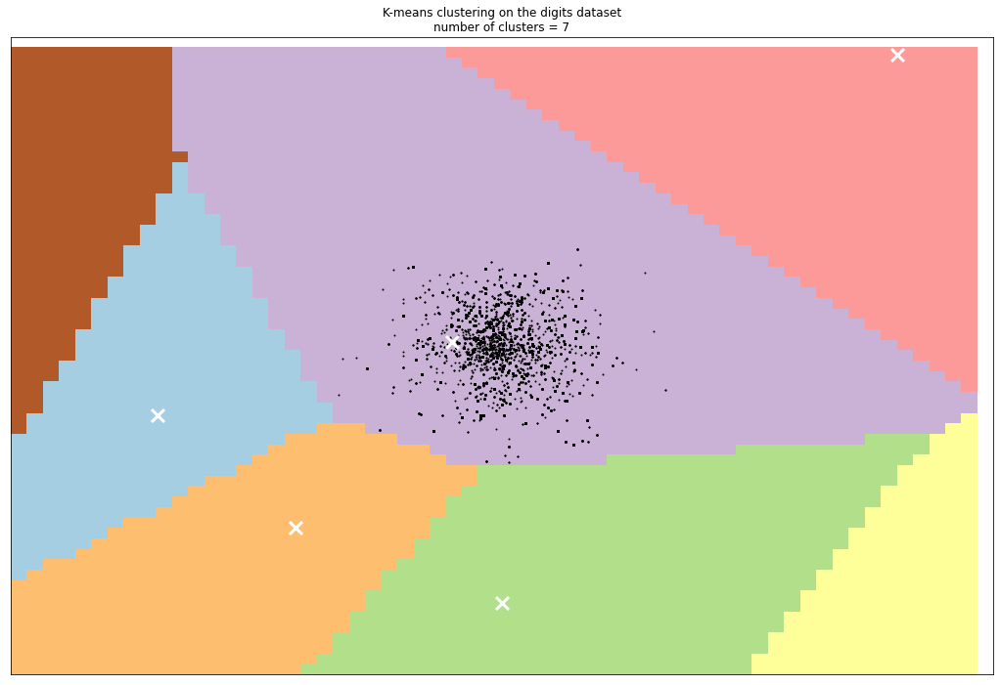

In [166]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km7 = KMeans(n_clusters=7, init="k-means++", n_init=10).fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = 0.05  # point in the mesh [x_min, x_max]x[y_min, y_max].
plt.figure(figsize=(18,12))

# Plot the decision boundary assigning a color to each
x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = km7.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

centroids = km7.cluster_centers_
# Plot the centroids as a white X
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 7"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_7.png')
plt.show()

In [167]:
km_labels = km7.labels_.tolist()
km_labels

[3,
 0,
 3,
 3,
 0,
 4,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 3,
 1,
 4,
 1,
 3,
 3,
 1,
 3,
 3,
 3,
 6,
 0,
 6,
 1,
 0,
 0,
 0,
 1,
 3,
 1,
 1,
 0,
 0,
 3,
 4,
 2,
 3,
 6,
 0,
 1,
 0,
 3,
 0,
 0,
 2,
 3,
 3,
 3,
 0,
 0,
 2,
 3,
 0,
 3,
 0,
 4,
 3,
 3,
 0,
 3,
 1,
 3,
 0,
 0,
 2,
 0,
 2,
 5,
 1,
 1,
 3,
 6,
 0,
 6,
 3,
 0,
 1,
 1,
 3,
 4,
 1,
 6,
 5,
 3,
 1,
 6,
 6,
 4,
 3,
 0,
 3,
 3,
 3,
 1,
 3,
 3,
 0,
 1,
 5,
 3,
 3,
 1,
 0,
 0,
 0,
 0,
 3,
 0,
 4,
 1,
 2,
 3,
 3,
 4,
 0,
 3,
 1,
 3,
 4,
 0,
 0,
 0,
 3,
 3,
 2,
 0,
 4,
 0,
 3,
 0,
 2,
 0,
 0,
 1,
 2,
 3,
 1,
 3,
 3,
 6,
 3,
 4,
 4,
 3,
 3,
 1,
 2,
 2,
 4,
 1,
 3,
 4,
 1,
 1,
 4,
 0,
 3,
 4,
 1,
 0,
 1,
 0,
 0,
 3,
 3,
 1,
 0,
 0,
 3,
 2,
 6,
 3,
 6,
 0,
 1,
 0,
 4,
 0,
 3,
 3,
 2,
 3,
 0,
 0,
 0,
 3,
 0,
 3,
 3,
 3,
 0,
 3,
 3,
 5,
 3,
 3,
 0,
 1,
 4,
 0,
 3,
 3,
 3,
 3,
 3,
 1,
 3,
 3,
 0,
 2,
 3,
 6,
 1,
 4,
 4,
 5,
 0,
 0,
 0,
 0,
 3,
 1,
 3,
 0,
 3,
 3,
 3,
 1,
 0,
 5,
 1,
 6,
 0,
 3,
 3,
 1,
 3,
 1,
 6,
 0,
 0,
 1,
 3,
 0,
 0,


In [168]:
labels_count = Counter(km_labels)
labels_count

Counter({3: 4909, 0: 4729, 4: 1072, 1: 2401, 6: 1049, 2: 986, 5: 662})

In [ ]:
# max/min = 7

## 10 clusters

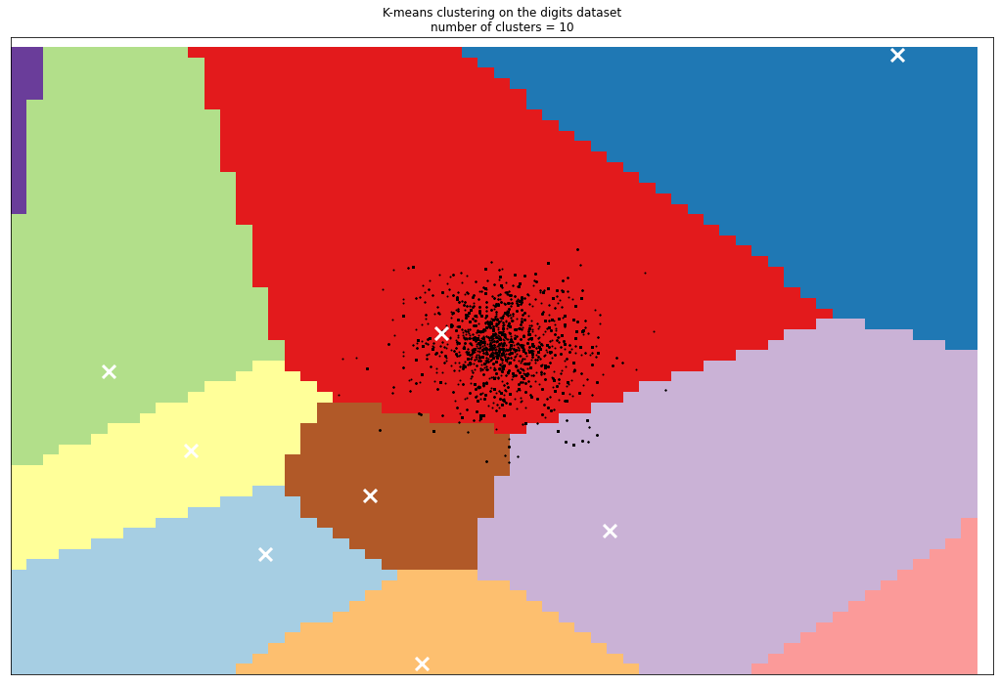

In [169]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km10 = KMeans(n_clusters=10, init="k-means++", n_init=10).fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = 0.05  # point in the mesh [x_min, x_max]x[y_min, y_max].
plt.figure(figsize=(18,12))

# Plot the decision boundary assigning a color to each
x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = km10.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

# Plot the centroids as a white X
centroids = km10.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 10"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_10.png')
plt.show()

In [170]:
km_labels = km10.labels_.tolist()
km_labels

[8,
 8,
 0,
 0,
 2,
 4,
 8,
 2,
 6,
 2,
 6,
 2,
 6,
 2,
 8,
 0,
 9,
 4,
 6,
 0,
 0,
 5,
 0,
 0,
 0,
 2,
 8,
 7,
 6,
 2,
 8,
 2,
 9,
 9,
 5,
 5,
 8,
 8,
 0,
 4,
 1,
 9,
 7,
 2,
 6,
 8,
 9,
 2,
 8,
 1,
 8,
 9,
 0,
 8,
 8,
 1,
 0,
 2,
 9,
 2,
 4,
 0,
 0,
 8,
 0,
 5,
 0,
 8,
 8,
 1,
 2,
 1,
 3,
 5,
 5,
 9,
 2,
 8,
 7,
 9,
 8,
 6,
 6,
 9,
 4,
 5,
 7,
 3,
 9,
 5,
 7,
 7,
 4,
 0,
 8,
 0,
 9,
 0,
 5,
 9,
 0,
 8,
 6,
 3,
 0,
 0,
 6,
 8,
 8,
 8,
 8,
 0,
 8,
 4,
 6,
 1,
 0,
 0,
 4,
 2,
 0,
 6,
 0,
 4,
 8,
 2,
 2,
 0,
 9,
 1,
 8,
 4,
 8,
 0,
 2,
 1,
 2,
 2,
 5,
 1,
 0,
 5,
 0,
 8,
 2,
 0,
 4,
 4,
 0,
 9,
 5,
 1,
 1,
 4,
 5,
 0,
 4,
 6,
 6,
 4,
 8,
 8,
 4,
 5,
 2,
 6,
 8,
 8,
 0,
 9,
 5,
 8,
 2,
 9,
 1,
 7,
 0,
 7,
 2,
 5,
 8,
 4,
 2,
 0,
 0,
 1,
 9,
 8,
 2,
 8,
 0,
 2,
 9,
 8,
 9,
 2,
 5,
 9,
 3,
 9,
 0,
 8,
 5,
 4,
 8,
 9,
 0,
 0,
 9,
 0,
 6,
 8,
 9,
 8,
 1,
 0,
 2,
 6,
 4,
 4,
 3,
 8,
 2,
 2,
 8,
 0,
 6,
 9,
 2,
 9,
 0,
 0,
 9,
 8,
 3,
 5,
 7,
 8,
 0,
 9,
 5,
 0,
 6,
 7,
 8,
 2,
 6,
 8,
 8,
 8,


In [171]:
labels_count = Counter(km_labels)
labels_count

Counter({8: 3366,
         0: 2541,
         2: 2288,
         4: 992,
         6: 938,
         9: 1964,
         5: 1404,
         7: 667,
         1: 986,
         3: 662})

In [172]:
labels_count.most_common()

[(8, 3366),
 (0, 2541),
 (2, 2288),
 (9, 1964),
 (5, 1404),
 (4, 992),
 (1, 986),
 (6, 938),
 (7, 667),
 (3, 662)]

In [ ]:
# max/min = 5 

## 13 clusters

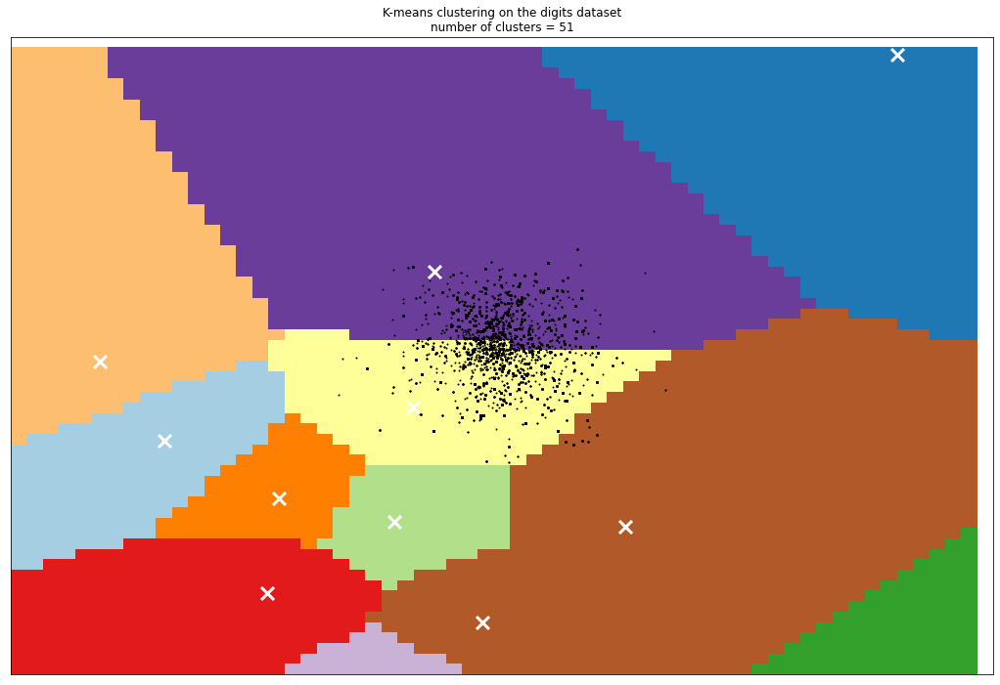

In [177]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km13 = KMeans(n_clusters=13, init="k-means++", n_init=10).fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = 0.05  # point in the mesh [x_min, x_max]x[y_min, y_max].
plt.figure(figsize=(18,12))

# Plot the decision boundary assigning a color to each
x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = km13.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

# Plot the centroids as a white X
centroids = km13.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 51"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_13.png')
plt.show()

In [178]:
km_labels = km13.labels_.tolist()
km_labels

[7,
 0,
 7,
 7,
 6,
 10,
 0,
 6,
 12,
 6,
 2,
 6,
 12,
 0,
 0,
 5,
 2,
 10,
 12,
 7,
 7,
 8,
 7,
 7,
 7,
 6,
 0,
 4,
 12,
 6,
 0,
 6,
 2,
 2,
 11,
 11,
 10,
 10,
 5,
 9,
 1,
 2,
 4,
 6,
 12,
 0,
 10,
 6,
 0,
 1,
 7,
 7,
 7,
 0,
 0,
 1,
 5,
 6,
 2,
 6,
 9,
 5,
 5,
 0,
 7,
 8,
 7,
 0,
 0,
 1,
 6,
 1,
 3,
 11,
 11,
 2,
 6,
 0,
 4,
 7,
 0,
 12,
 12,
 7,
 10,
 11,
 4,
 3,
 2,
 11,
 4,
 4,
 9,
 7,
 0,
 7,
 7,
 5,
 8,
 7,
 5,
 7,
 12,
 3,
 7,
 7,
 12,
 0,
 0,
 0,
 0,
 5,
 0,
 9,
 12,
 1,
 7,
 7,
 9,
 6,
 5,
 12,
 7,
 10,
 0,
 6,
 6,
 5,
 2,
 1,
 0,
 10,
 7,
 7,
 0,
 1,
 6,
 6,
 11,
 1,
 7,
 8,
 7,
 7,
 6,
 7,
 9,
 9,
 5,
 2,
 8,
 1,
 1,
 9,
 8,
 5,
 9,
 2,
 12,
 10,
 0,
 7,
 10,
 11,
 0,
 12,
 0,
 0,
 7,
 10,
 11,
 0,
 6,
 10,
 1,
 4,
 5,
 4,
 6,
 8,
 10,
 10,
 6,
 7,
 7,
 1,
 2,
 0,
 6,
 0,
 7,
 6,
 7,
 7,
 7,
 0,
 5,
 7,
 3,
 2,
 7,
 0,
 8,
 10,
 10,
 2,
 5,
 7,
 2,
 7,
 12,
 7,
 10,
 0,
 1,
 7,
 6,
 12,
 9,
 10,
 3,
 0,
 6,
 6,
 0,
 7,
 12,
 7,
 6,
 7,
 7,
 7,
 2,
 0,
 3,
 11,
 4,
 0,
 5,


In [179]:
labels_count = Counter(km_labels)
labels_count

Counter({7: 2512,
         0: 3105,
         6: 1806,
         10: 1047,
         12: 798,
         2: 1032,
         5: 1410,
         8: 640,
         4: 663,
         11: 715,
         9: 432,
         1: 986,
         3: 662})

In [180]:
labels_count.most_common()

[(0, 3105),
 (7, 2512),
 (6, 1806),
 (5, 1410),
 (10, 1047),
 (2, 1032),
 (1, 986),
 (12, 798),
 (11, 715),
 (4, 663),
 (3, 662),
 (8, 640),
 (9, 432)]

In [ ]:
# max/min = 7 

## 51 clusters

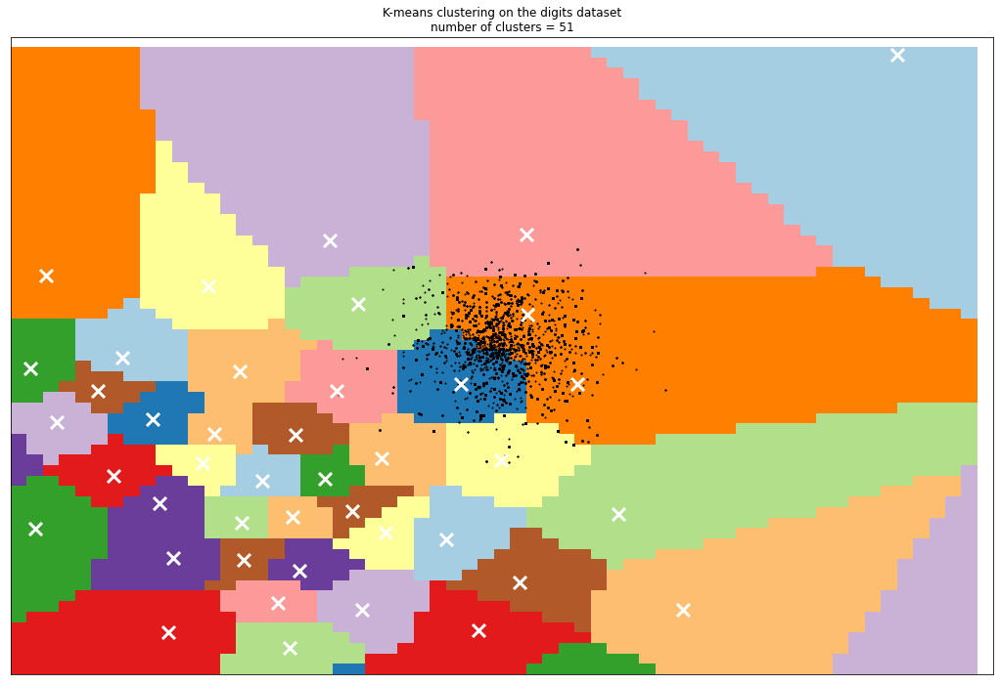

In [181]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km51 = KMeans(n_clusters=51, init="k-means++", n_init=10).fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = 0.05  # point in the mesh [x_min, x_max]x[y_min, y_max].
plt.figure(figsize=(18,12))

# Plot the decision boundary assigning a color to each
x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = km51.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

# Plot the centroids as a white X
centroids = km51.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 51"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_51.png')
plt.show()

In [182]:
km_labels = km51.labels_.tolist()
km_labels

[49,
 8,
 12,
 12,
 1,
 7,
 27,
 46,
 10,
 46,
 45,
 46,
 10,
 36,
 27,
 38,
 0,
 31,
 10,
 12,
 12,
 5,
 12,
 12,
 12,
 16,
 8,
 19,
 10,
 1,
 44,
 46,
 0,
 42,
 24,
 24,
 20,
 20,
 18,
 17,
 2,
 42,
 40,
 46,
 10,
 27,
 26,
 46,
 21,
 2,
 4,
 14,
 25,
 8,
 21,
 2,
 38,
 46,
 26,
 1,
 9,
 38,
 38,
 29,
 12,
 23,
 25,
 39,
 8,
 2,
 43,
 2,
 3,
 37,
 37,
 26,
 16,
 8,
 19,
 14,
 27,
 28,
 10,
 14,
 7,
 24,
 6,
 34,
 14,
 24,
 40,
 40,
 9,
 25,
 13,
 12,
 14,
 38,
 37,
 14,
 18,
 49,
 10,
 3,
 25,
 25,
 10,
 8,
 21,
 27,
 13,
 47,
 21,
 30,
 10,
 2,
 12,
 25,
 35,
 29,
 22,
 10,
 12,
 7,
 29,
 36,
 46,
 38,
 42,
 2,
 8,
 20,
 49,
 12,
 8,
 2,
 1,
 46,
 24,
 2,
 12,
 23,
 12,
 4,
 16,
 12,
 17,
 17,
 38,
 26,
 23,
 2,
 2,
 35,
 23,
 38,
 9,
 45,
 28,
 20,
 8,
 4,
 31,
 24,
 8,
 10,
 27,
 21,
 12,
 26,
 0,
 8,
 46,
 49,
 2,
 33,
 38,
 6,
 36,
 23,
 49,
 7,
 46,
 12,
 12,
 2,
 42,
 21,
 16,
 8,
 25,
 1,
 14,
 4,
 14,
 29,
 11,
 14,
 34,
 48,
 12,
 27,
 5,
 7,
 20,
 26,
 22,
 12,
 48,
 12,
 

In [183]:
labels_count = Counter(km_labels)
labels_count

Counter({49: 220,
         8: 1119,
         12: 559,
         1: 879,
         7: 237,
         27: 664,
         46: 235,
         10: 640,
         45: 85,
         36: 260,
         38: 461,
         0: 273,
         31: 153,
         5: 234,
         16: 306,
         19: 91,
         44: 425,
         42: 318,
         24: 492,
         20: 238,
         18: 222,
         17: 131,
         2: 986,
         40: 135,
         26: 423,
         21: 296,
         4: 472,
         14: 456,
         25: 774,
         9: 137,
         29: 265,
         23: 334,
         39: 195,
         43: 92,
         3: 469,
         37: 246,
         28: 115,
         6: 358,
         34: 193,
         13: 133,
         47: 150,
         30: 79,
         35: 88,
         22: 160,
         33: 129,
         11: 165,
         48: 296,
         15: 63,
         41: 125,
         32: 82,
         50: 150})

In [184]:
labels_count.most_common()

[(8, 1119),
 (2, 986),
 (1, 879),
 (25, 774),
 (27, 664),
 (10, 640),
 (12, 559),
 (24, 492),
 (4, 472),
 (3, 469),
 (38, 461),
 (14, 456),
 (44, 425),
 (26, 423),
 (6, 358),
 (23, 334),
 (42, 318),
 (16, 306),
 (21, 296),
 (48, 296),
 (0, 273),
 (29, 265),
 (36, 260),
 (37, 246),
 (20, 238),
 (7, 237),
 (46, 235),
 (5, 234),
 (18, 222),
 (49, 220),
 (39, 195),
 (34, 193),
 (11, 165),
 (22, 160),
 (31, 153),
 (47, 150),
 (50, 150),
 (9, 137),
 (40, 135),
 (13, 133),
 (17, 131),
 (33, 129),
 (41, 125),
 (28, 115),
 (43, 92),
 (19, 91),
 (35, 88),
 (45, 85),
 (32, 82),
 (30, 79),
 (15, 63)]

In [ ]:
# max/min = 17

## 56 clusters

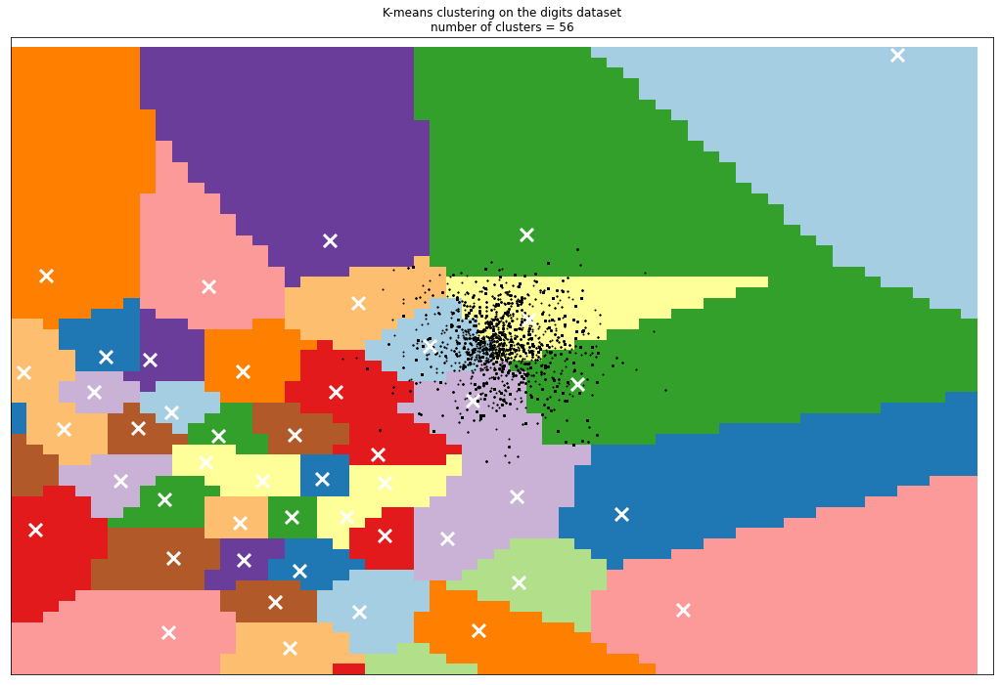

In [185]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km56 = KMeans(n_clusters=56, init="k-means++", n_init=10).fit(reduced_data)

h = 0.05  
plt.figure(figsize=(18,12))

x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = km56.predict(np.c_[xx.ravel(), yy.ravel()])

Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

centroids = km56.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 56"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_56.png')
plt.show()

In [186]:
km_labels = km56.labels_.tolist()
km_labels

[55,
 2,
 29,
 29,
 9,
 40,
 17,
 39,
 6,
 39,
 37,
 39,
 6,
 31,
 17,
 8,
 38,
 16,
 6,
 29,
 29,
 27,
 29,
 29,
 29,
 28,
 52,
 13,
 6,
 9,
 49,
 39,
 23,
 23,
 35,
 35,
 26,
 26,
 51,
 15,
 3,
 23,
 7,
 39,
 6,
 17,
 24,
 39,
 41,
 3,
 47,
 5,
 18,
 52,
 52,
 3,
 8,
 39,
 50,
 9,
 30,
 8,
 8,
 36,
 29,
 12,
 18,
 14,
 52,
 3,
 19,
 3,
 4,
 1,
 1,
 50,
 28,
 2,
 13,
 5,
 17,
 22,
 37,
 5,
 40,
 35,
 10,
 21,
 50,
 35,
 7,
 7,
 30,
 18,
 25,
 29,
 5,
 8,
 1,
 5,
 51,
 55,
 6,
 4,
 18,
 18,
 6,
 2,
 41,
 17,
 25,
 42,
 41,
 48,
 6,
 3,
 29,
 18,
 43,
 44,
 20,
 6,
 29,
 0,
 36,
 31,
 39,
 8,
 23,
 3,
 52,
 26,
 55,
 29,
 2,
 3,
 9,
 39,
 35,
 3,
 29,
 12,
 29,
 47,
 28,
 29,
 15,
 15,
 8,
 50,
 12,
 3,
 3,
 43,
 12,
 8,
 30,
 37,
 22,
 26,
 52,
 47,
 16,
 35,
 2,
 6,
 17,
 41,
 29,
 24,
 38,
 2,
 39,
 55,
 3,
 45,
 8,
 10,
 31,
 12,
 55,
 40,
 39,
 29,
 29,
 3,
 23,
 41,
 28,
 52,
 18,
 44,
 5,
 47,
 5,
 36,
 32,
 5,
 21,
 46,
 29,
 17,
 27,
 40,
 26,
 50,
 20,
 29,
 46,
 29,
 6,
 47,


In [187]:
labels_count = Counter(km_labels)
labels_count

Counter({55: 216,
         2: 658,
         29: 529,
         9: 623,
         40: 224,
         17: 575,
         39: 263,
         6: 611,
         37: 79,
         31: 239,
         8: 463,
         38: 268,
         16: 153,
         27: 214,
         28: 268,
         52: 563,
         13: 91,
         49: 382,
         23: 327,
         35: 498,
         26: 239,
         51: 207,
         15: 131,
         3: 986,
         7: 88,
         24: 354,
         41: 260,
         47: 471,
         5: 422,
         18: 804,
         50: 174,
         30: 135,
         36: 254,
         12: 351,
         14: 225,
         19: 91,
         4: 469,
         1: 248,
         22: 115,
         10: 358,
         21: 193,
         25: 131,
         42: 151,
         48: 85,
         43: 88,
         44: 315,
         20: 160,
         0: 50,
         45: 128,
         32: 165,
         46: 233,
         53: 71,
         34: 63,
         54: 124,
         33: 82,
         11: 143})

In [188]:
labels_count.most_common()

[(3, 986),
 (18, 804),
 (2, 658),
 (9, 623),
 (6, 611),
 (17, 575),
 (52, 563),
 (29, 529),
 (35, 498),
 (47, 471),
 (4, 469),
 (8, 463),
 (5, 422),
 (49, 382),
 (10, 358),
 (24, 354),
 (12, 351),
 (23, 327),
 (44, 315),
 (38, 268),
 (28, 268),
 (39, 263),
 (41, 260),
 (36, 254),
 (1, 248),
 (31, 239),
 (26, 239),
 (46, 233),
 (14, 225),
 (40, 224),
 (55, 216),
 (27, 214),
 (51, 207),
 (21, 193),
 (50, 174),
 (32, 165),
 (20, 160),
 (16, 153),
 (42, 151),
 (11, 143),
 (30, 135),
 (15, 131),
 (25, 131),
 (45, 128),
 (54, 124),
 (22, 115),
 (13, 91),
 (19, 91),
 (7, 88),
 (43, 88),
 (48, 85),
 (33, 82),
 (37, 79),
 (53, 71),
 (34, 63),
 (0, 50)]

In [ ]:
# max/min = 19

## 65 clusters

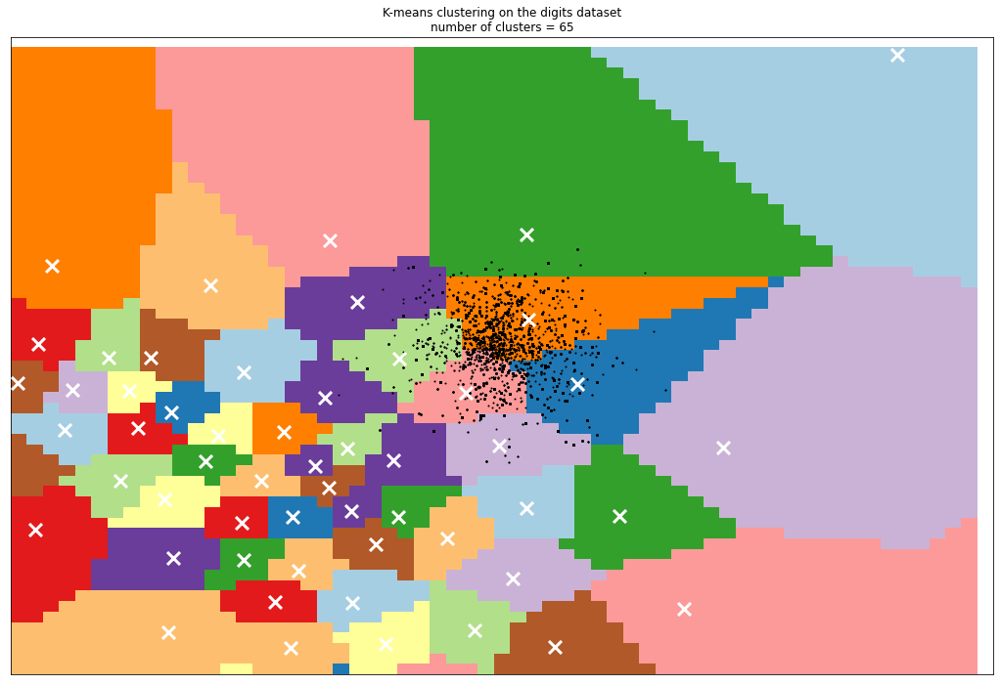

In [189]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km65 = KMeans(n_clusters=65, init="k-means++", n_init=10).fit(reduced_data)

h = 0.05  
plt.figure(figsize=(18,12))

x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = km65.predict(np.c_[xx.ravel(), yy.ravel()])

Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

centroids = km65.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 65"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_65.png')
plt.show()

In [190]:
km_labels = km65.labels_.tolist()
km_labels

[38,
 10,
 29,
 29,
 13,
 26,
 58,
 43,
 18,
 43,
 3,
 43,
 18,
 5,
 58,
 34,
 36,
 7,
 18,
 29,
 29,
 9,
 29,
 29,
 29,
 31,
 28,
 19,
 18,
 13,
 20,
 43,
 64,
 16,
 11,
 11,
 51,
 51,
 27,
 21,
 2,
 16,
 46,
 57,
 18,
 58,
 50,
 57,
 14,
 2,
 35,
 63,
 6,
 28,
 28,
 2,
 34,
 43,
 50,
 13,
 48,
 34,
 34,
 0,
 29,
 24,
 6,
 55,
 28,
 2,
 33,
 2,
 4,
 56,
 56,
 50,
 60,
 10,
 19,
 52,
 58,
 25,
 3,
 63,
 26,
 11,
 8,
 22,
 63,
 11,
 46,
 46,
 48,
 6,
 30,
 29,
 63,
 34,
 56,
 63,
 27,
 38,
 18,
 4,
 6,
 6,
 18,
 10,
 14,
 58,
 30,
 17,
 14,
 42,
 18,
 2,
 29,
 6,
 23,
 62,
 37,
 18,
 29,
 12,
 0,
 5,
 43,
 34,
 64,
 2,
 28,
 12,
 38,
 29,
 10,
 2,
 13,
 57,
 11,
 2,
 29,
 24,
 29,
 35,
 60,
 29,
 21,
 21,
 34,
 50,
 24,
 2,
 2,
 23,
 24,
 34,
 48,
 3,
 25,
 51,
 28,
 35,
 7,
 11,
 10,
 18,
 58,
 14,
 29,
 50,
 36,
 10,
 43,
 15,
 2,
 40,
 34,
 8,
 5,
 24,
 38,
 26,
 57,
 29,
 29,
 2,
 64,
 14,
 43,
 28,
 6,
 62,
 63,
 35,
 52,
 0,
 32,
 63,
 22,
 53,
 29,
 58,
 9,
 26,
 51,
 50,
 37,
 2

In [191]:
labels_count = Counter(km_labels)
labels_count

Counter({38: 158,
         10: 644,
         29: 559,
         13: 577,
         26: 185,
         58: 573,
         43: 191,
         18: 597,
         3: 58,
         5: 232,
         34: 451,
         36: 259,
         7: 153,
         9: 209,
         31: 137,
         28: 568,
         19: 91,
         20: 372,
         64: 233,
         16: 142,
         11: 459,
         51: 186,
         27: 207,
         21: 131,
         2: 986,
         46: 86,
         57: 133,
         50: 299,
         14: 260,
         35: 481,
         63: 266,
         6: 774,
         48: 132,
         0: 250,
         24: 304,
         55: 225,
         33: 89,
         4: 469,
         56: 97,
         60: 182,
         52: 196,
         25: 113,
         8: 358,
         22: 193,
         30: 131,
         17: 151,
         42: 85,
         23: 88,
         62: 300,
         37: 160,
         12: 106,
         15: 179,
         40: 129,
         32: 163,
         53: 274,
         61: 87,
         

In [192]:
labels_count.most_common()

[(2, 986),
 (6, 774),
 (10, 644),
 (18, 597),
 (13, 577),
 (58, 573),
 (28, 568),
 (29, 559),
 (35, 481),
 (4, 469),
 (11, 459),
 (34, 451),
 (20, 372),
 (8, 358),
 (24, 304),
 (62, 300),
 (50, 299),
 (53, 274),
 (63, 266),
 (14, 260),
 (36, 259),
 (0, 250),
 (64, 233),
 (5, 232),
 (55, 225),
 (9, 209),
 (27, 207),
 (52, 196),
 (22, 193),
 (43, 191),
 (51, 186),
 (26, 185),
 (60, 182),
 (1, 182),
 (15, 179),
 (32, 163),
 (37, 160),
 (38, 158),
 (7, 153),
 (17, 151),
 (16, 142),
 (31, 137),
 (57, 133),
 (48, 132),
 (21, 131),
 (30, 131),
 (40, 129),
 (47, 125),
 (49, 124),
 (25, 113),
 (12, 106),
 (56, 97),
 (19, 91),
 (33, 89),
 (23, 88),
 (61, 87),
 (46, 86),
 (42, 85),
 (39, 65),
 (59, 61),
 (45, 60),
 (3, 58),
 (41, 32),
 (54, 27),
 (44, 14)]

In [ ]:
# max/min = 70

## 60 clusters

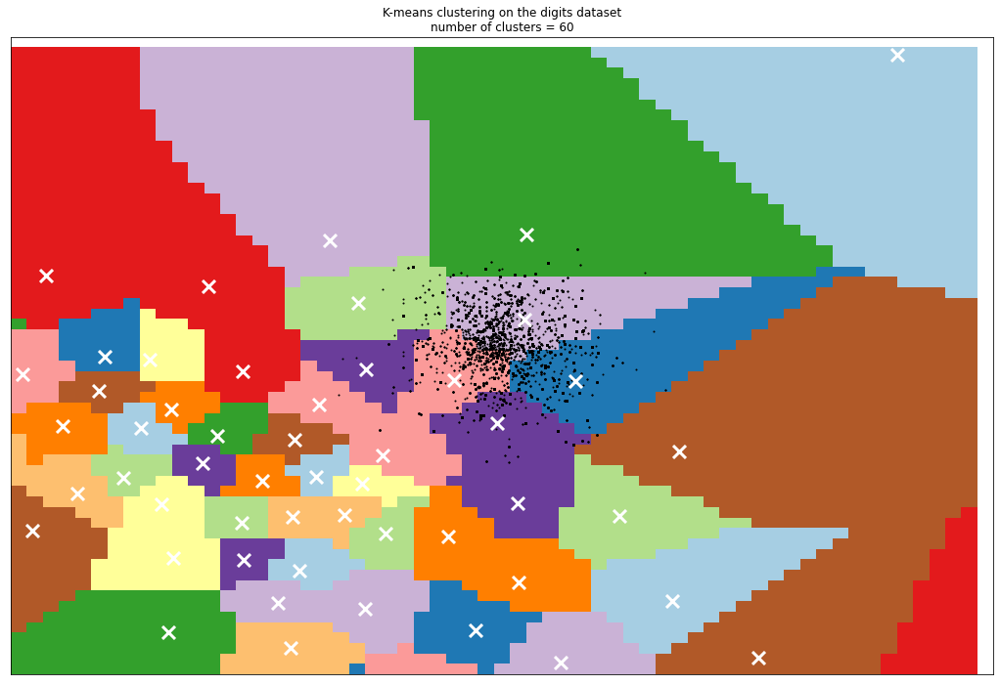

In [29]:
reduced_data = PCA(n_components=2).fit_transform(X_scaled)
km60 = KMeans(n_clusters=60, init="k-means++", n_init=10).fit(reduced_data)

h = 0.05  
plt.figure(figsize=(18,12))

x_min, x_max = X_scaled[:, 0].min() - 1, X_scaled[:, 0].max() + 1
y_min, y_max = X_scaled[:, 1].min() - 1, X_scaled[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = km60.predict(np.c_[xx.ravel(), yy.ravel()])

Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(
    Z,
    interpolation="nearest",
    extent=(xx.min(), xx.max(), yy.min(), yy.max()),
    cmap=plt.cm.Paired,
    aspect="auto",
    origin="lower",
)

plt.plot(X_scaled[:, 0], X_scaled[:, 1], "k.", markersize=2)

centroids = km60.cluster_centers_
plt.scatter(
    centroids[:, 0],
    centroids[:, 1],
    marker="x",
    s=169,
    linewidths=3,
    color="w",
    zorder=10,
)
plt.title(
    "K-means clustering on the digits dataset\n"
    "number of clusters = 60"
)
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.savefig('clusters_60.png')
plt.show()

In [110]:
km_centers = km60.cluster_centers_
km_centers

array([[ 1.64837954e-01, -4.76688963e-03],
       [ 1.70685492e+00,  1.91611774e+00],
       [-6.05889419e-01,  1.61516873e-01],
       [ 2.06733461e+00, -1.14642470e+00],
       [-1.23154939e-01, -5.32781158e-01],
       [ 8.58685459e-01, -2.52868126e-01],
       [-2.56664636e-02,  1.04363552e+00],
       [-1.43230936e+00,  6.63379574e-01],
       [ 4.23858642e-01, -7.93466788e-01],
       [ 2.62397796e-01, -1.11117174e+00],
       [ 7.30055511e-01,  3.67733966e-01],
       [-1.38896719e-01, -2.56548881e-01],
       [-7.09990734e-01,  4.96055856e-01],
       [-4.01834232e-01, -1.73228860e-03],
       [ 1.95617286e+00, -1.53262033e+00],
       [-9.24868345e-01, -3.17929563e-01],
       [ 3.15563032e-01, -3.75874803e-01],
       [ 8.56499696e-02,  4.35770639e-01],
       [-2.00805736e+00,  1.55412903e-01],
       [ 5.73602234e-01,  1.06951784e+00],
       [-5.26865552e-01, -8.00822532e-01],
       [-9.54798088e-01, -1.53149227e-02],
       [-4.52899649e-01,  1.91669995e-01],
       [-5.

In [111]:
centroids = pd.DataFrame(km60.cluster_centers_)
centroids['cluster'] = centroids.index
centroids

,0,1,cluster
0,0.164838,-0.004767,0
1,1.706855,1.916118,1
2,-0.605889,0.161517,2
3,2.067335,-1.146425,3
4,-0.123155,-0.532781,4
5,0.858685,-0.252868,5
6,-0.025666,1.043636,6
7,-1.432309,0.663380,7
8,0.423859,-0.793467,8
9,0.262398,-1.111172,9


In [238]:
km60.labels_[0:60]

array([58,  9,  3,  3, 42, 57, 36, 54,  7, 54, 46, 54,  7, 24, 36, 31, 46,
       25,  7,  3,  3, 14,  3,  3,  3, 37, 39, 15,  7, 42, 27, 54, 16, 45,
       23, 23, 50, 50, 48, 10,  2, 45, 12, 40,  7, 36, 30, 40, 20,  2, 43,
       53, 33, 39, 39,  2, 31, 54, 30, 42])

In [30]:
# add to dataframe
km_labels = km60.labels_.tolist()
km_labels

[59,
 38,
 13,
 13,
 10,
 48,
 19,
 56,
 12,
 56,
 46,
 56,
 12,
 37,
 19,
 5,
 39,
 7,
 12,
 13,
 13,
 9,
 13,
 13,
 13,
 22,
 3,
 17,
 12,
 10,
 49,
 56,
 14,
 14,
 8,
 8,
 24,
 24,
 42,
 20,
 2,
 14,
 32,
 56,
 12,
 19,
 21,
 56,
 15,
 2,
 36,
 53,
 34,
 3,
 3,
 2,
 5,
 56,
 21,
 10,
 11,
 5,
 5,
 29,
 13,
 23,
 34,
 52,
 3,
 2,
 28,
 2,
 0,
 41,
 41,
 21,
 22,
 38,
 17,
 1,
 19,
 4,
 46,
 53,
 48,
 8,
 6,
 27,
 53,
 8,
 32,
 32,
 11,
 34,
 57,
 13,
 1,
 5,
 41,
 1,
 42,
 59,
 12,
 0,
 34,
 34,
 12,
 38,
 15,
 19,
 57,
 45,
 15,
 43,
 12,
 2,
 13,
 34,
 44,
 54,
 16,
 12,
 13,
 25,
 29,
 37,
 56,
 5,
 14,
 2,
 3,
 47,
 59,
 13,
 38,
 2,
 10,
 56,
 8,
 2,
 13,
 23,
 13,
 36,
 22,
 13,
 20,
 20,
 5,
 21,
 23,
 2,
 2,
 44,
 23,
 5,
 11,
 46,
 55,
 24,
 3,
 36,
 7,
 8,
 38,
 12,
 19,
 31,
 13,
 21,
 41,
 38,
 56,
 59,
 2,
 18,
 5,
 6,
 37,
 23,
 59,
 25,
 56,
 13,
 13,
 2,
 14,
 15,
 22,
 3,
 34,
 54,
 1,
 36,
 1,
 29,
 30,
 1,
 27,
 33,
 13,
 19,
 9,
 25,
 24,
 21,
 16,
 13,
 33,
 13,


In [38]:
labels = pd.DataFrame(km60.labels_, columns=['labels'])
labels

,labels
0,59
1,38
2,13
3,13
4,10
...,...
15803,49
15804,12
15805,13
15806,9


In [39]:
labels.to_parquet('cluster60_labels.parquet.gzip',compression='gzip')

In [40]:
vectors['number_of_cluster'] = km_labels
vectors

C:\Users\User\AppData\Local\Temp/ipykernel_6164/2696992925.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vectors['number_of_cluster'] = km_labels


,number,appeal_vectors,theme_vectors,number_of_cluster
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10
...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9


In [ ]:
## save df w/ attached classes

In [41]:
vectors.to_parquet('df_clustered_vecs.parquet.gzip', compression='gzip')

In [57]:
labels_count = Counter(km_labels)
labels_count

Counter({58: 162,
         9: 342,
         3: 559,
         42: 638,
         57: 99,
         36: 570,
         54: 201,
         7: 611,
         46: 259,
         24: 258,
         31: 461,
         25: 153,
         14: 234,
         37: 249,
         39: 576,
         15: 91,
         27: 440,
         16: 88,
         45: 286,
         23: 462,
         50: 227,
         48: 207,
         10: 131,
         2: 986,
         12: 132,
         40: 409,
         30: 276,
         20: 410,
         43: 471,
         53: 267,
         33: 774,
         17: 137,
         26: 117,
         29: 304,
         34: 89,
         5: 469,
         55: 96,
         11: 339,
         28: 113,
         6: 358,
         19: 193,
         35: 133,
         52: 151,
         44: 79,
         47: 88,
         1: 290,
         21: 160,
         4: 189,
         49: 103,
         18: 128,
         59: 153,
         8: 165,
         22: 251,
         32: 49,
         41: 131,
         0: 70,
         13

In [58]:
labels_count.most_common()

[(2, 986),
 (33, 774),
 (42, 638),
 (7, 611),
 (39, 576),
 (36, 570),
 (3, 559),
 (43, 471),
 (5, 469),
 (23, 462),
 (31, 461),
 (27, 440),
 (20, 410),
 (40, 409),
 (6, 358),
 (9, 342),
 (11, 339),
 (29, 304),
 (1, 290),
 (45, 286),
 (30, 276),
 (53, 267),
 (46, 259),
 (24, 258),
 (22, 251),
 (37, 249),
 (14, 234),
 (50, 227),
 (48, 207),
 (54, 201),
 (19, 193),
 (4, 189),
 (13, 183),
 (8, 165),
 (58, 162),
 (21, 160),
 (25, 153),
 (59, 153),
 (52, 151),
 (17, 137),
 (35, 133),
 (12, 132),
 (10, 131),
 (41, 131),
 (18, 128),
 (51, 126),
 (26, 117),
 (28, 113),
 (49, 103),
 (57, 99),
 (55, 96),
 (15, 91),
 (34, 89),
 (16, 88),
 (47, 88),
 (38, 82),
 (44, 79),
 (0, 70),
 (32, 49),
 (56, 33)]

In [47]:
# max/min = 65

In [62]:
labels_count.values()

dict_values([162, 342, 559, 638, 99, 570, 201, 611, 259, 258, 461, 153, 234, 249, 576, 91, 440, 88, 286, 462, 227, 207, 131, 986, 132, 409, 276, 410, 471, 267, 774, 137, 117, 304, 89, 469, 96, 339, 113, 358, 193, 133, 151, 79, 88, 290, 160, 189, 103, 128, 153, 165, 251, 49, 131, 70, 183, 82, 33, 126])

# manually shrinking the number of clusters by uniting similar clusters

In [42]:
# cluster_analysis_df = pd.read_parquet('df_clustered_vecs.parquet.gzip')
cluster_analysis_df = vectors.copy()
cluster_analysis_df

,number,appeal_vectors,theme_vectors,number_of_cluster
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10
...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9


In [111]:
vector_text_match_df = data.copy()
vector_text_match_df

,number,theme_of_appeal,appeal,executive_reply
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...
...,...,...,...,...
16825,308044,Аннулирование отмены проведения.,Добрый день13.06.2019г. был произведен запрос ...,Добрый день! Дежурная линия не осуществляет до...
16826,308046,Не распроводится акт.,Добрый день. Покупатель ошибочно выставил акт ...,Добрый день. Накладная TTN-0284124400 была сфо...
16827,308048,Списание АП с регистра 1,Добрый день При попытке списать АП возвращаетс...,"Добрый день! В отправляемом акте, в теге <pref..."
16828,308052,Регистрация безалкогольного пива.,Нужно ли регистрировать безалкогольное пиво в ...,Добрый день! Дежурная линия осуществляет техни...


# cluster 0

In [239]:
cluster_analysis_df0 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 0]
cluster_analysis_df0

,number,appeal_vectors,theme_vectors,number_of_cluster
344,269703,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 0.32280168 2.8211641 1.5133665 -0.581187...,0
782,274651,[-2.7202551e+00 1.3184811e+00 7.0596850e-01 ...,[-0.40862218 -2.3270886 0.76382744 2.730044...,0
1190,279224,[ 2.1343496e+00 3.2267874e-01 -7.5700891e-01 ...,[-0.40862218 -2.3270886 0.76382744 2.730044...,0
1635,283379,[ 1.62014759e+00 2.50435472e-01 -2.07753778e+...,[ 0.32280168 2.8211641 1.5133665 -0.581187...,0
1721,284260,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 1.3209813 -1.7539799 2.738232 -2.549735...,0
...,...,...,...,...
13218,249072,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[-0.40862218 -2.3270886 0.76382744 2.730044...,0
13797,257635,[ 2.54398918e+00 3.11478019e-01 -7.54051626e-...,[-0.40862218 -2.3270886 0.76382744 2.730044...,0
13957,261263,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 0.32280168 2.8211641 1.5133665 -0.581187...,0
14903,219878,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 1.3209813 -1.7539799 2.738232 -2.549735...,0


In [240]:
cluster0_df = pd.concat([vector_text_match_df,cluster_analysis_df0['number_of_cluster']], 
               axis=1, join='inner')
cluster0_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
344,269703,Данные дкл в ЕГАИС не совпадают по документам,"Добрый день, 12.01.2018г поставщик ООО ТД НПК-...",Здравствуйте! По накладной TTN-0172405709 Вами...,0
782,274651,Программа ЕГАИС,"как работать в программе ЕГАИС, установлена ЕЦ...",Добрый день.|Дежурная служба осуществляет толь...,0
1190,279224,Программа работает неправильно,Пытаемся делать перемещение и списание остатко...,Добрый день.|По последнему документу передачи ...,0
1635,283379,Данные по остаткам в ЕГАИС,Здравствуйте. Нами была подана декларация по п...,Добрый день.|В УТМ отсутствует техническая воз...,0
1721,284260,нет связи,Добрый вечер. Мы не можем получить от поставщи...,Здравствуйте!Накладная TTN-0216245440 имеет ст...,0
...,...,...,...,...,...
13218,249072,Программа декларант алко пуста,"Ни делали копий, нет даже остатков",Дежурная служба осуществляет только техническу...,0
13797,257635,егаис в программе учета Айко,Здравствуйте.Вопрос связан с егаис.Ситуация сл...,Добрый день. С целью недопущения нарушения сро...,0
13957,261263,Данные справки А,Получили от поставщика ООО Алкион продукцию по...,"TTN-0157734836 накладная находится в статусе ""...",0
14903,219878,нет связи с егаис,не можем подтвердить закупку. одна фактура пос...,Добрый день. Просьба сообщить идентификатор на...,0


In [253]:
cluster0_df.theme_of_appeal.value_counts()
# main themes: ЕГАИС, ДАННЫЕ

Ограничения при переходе на 2 версию документаоборота                                                   2
нет связи с ЕГАИС                                                                                       2
объект общественного питания (признак включен), фиксирующий закуп, имеет статус Не подключен к ЕГАИС    2
связь с ЕГАИС                                                                                           2
нет связи с МРУ Росалкогольрегулирования по Южному федеральному округу                                  2
                                                                                                       ..
Данные в поле BOTTINGDATE                                                                               1
некоректные данные от контрагента                                                                       1
Программа ЕГАИС                                                                                         1
Связь с ЕГАИС                                 

# cluster 1

In [87]:
cluster_analysis_df1 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 1]
cluster_analysis_df1

,number,appeal_vectors,theme_vectors,number_of_cluster
124,266764,[-1.0231357 2.0441885 1.2465307 0.347476...,[ 6.31181955e-01 -1.38229981e-01 1.48385942e+...,1
199,267875,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1
233,268245,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1
255,268430,[ 5.37817478e-01 1.41182113e+00 1.30648124e+...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1
278,268678,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1
...,...,...,...,...
16637,307386,[-2.7202551e+00 1.3184811e+00 7.0596850e-01 ...,[-6.9628626e-02 1.0934482e+00 -1.5218399e+00 ...,1
16638,307390,[-2.7202551e+00 1.3184811e+00 7.0596850e-01 ...,[-6.9628626e-02 1.0934482e+00 -1.5218399e+00 ...,1
16708,307657,[-8.5664906e-02 1.3161936e+00 5.5927563e-01 ...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1
16756,307805,[-0.96332896 -0.43757126 4.08913 1.421571...,[ 1.6016511 0.04524533 1.4200857 0.206225...,1


In [114]:
cluster1_df = pd.concat([vector_text_match_df,cluster_analysis_df1['number_of_cluster']], 
               axis=1, join='inner')
cluster1_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
124,266764,Дважды проведено списание пивной продукции 30....,"Добрый день, на нашей торговой точке Геологиче...",Добрый день. Отменить акт списания из торговог...,1
199,267875,Нет технической возможности перемещения остатк...,Здравствуйте. Просим помочь решить проблему: п...,Добрый день. Дежурная линия осуществляет тольк...,1
233,268245,Нет подтверждения накладной TTN-0175056448.,Здравствуйте26 января 2018 года была получена ...,Добрый день. На накладную TTN-0175056448 на се...,1
255,268430,Нет фиксации в УТМ,ООО Бальзам ID 010000005323. В УТМ не фиксирую...,Рекомендуем проверить актуальность проблемы.|Е...,1
278,268678,Нет подтверждения накладной TTN-0175056448.,ЗдравствуйтеЯ не могу подтвердить ТТN-01750564...,Добрый день. Для анализа работы УТМ просьба пр...,1
...,...,...,...,...,...
16637,307386,В УТМ пишет что Лицензия на вид деятельности н...,"Не работает загрузка ТТН, в УТМ пишет что Лице...",Заявка закрыта пользователем в ЛК,1
16638,307390,Утм пишет Лицензия не действует,"Не работает загрузка ТТН, в УТМ пишет что Лице...",Рекомендации даны в обращении 00307386,1
16708,307657,Нет возможности подтвердить накладную в ЕГАИС,Добрый день в ООО Тесто закончилась лицензия н...,Добрый день! При обращении в линию поддержки п...,1
16756,307805,Нет информации о регистрации/отказе отчета по ...,"Добрый день Более 2 часов, не фиксируется отче...","Добрый день. При фиксации отчета об импорте, о...",1


In [255]:
cluster1_df.theme_of_appeal.value_counts()
# main theme: ОТСУТСТВИЕ 

Нет ответа от ЕГАИС                                                  7
Нет справки 2                                                        4
Нет действующей лицензии                                             4
Нет контрагента, а заявка висит не подтвержденная.                   2
Нет остатков                                                         2
                                                                    ..
Нет сверки с поставщиками за 2 кв.2017г                              1
В УТМ пишется , что лицензия на вид деятельности не действует        1
Нет протокола за 2 квартал.                                          1
Нет сверки с контрагентами                                           1
Нет ответа от ЕГАИС об отмене проведения накладной TTN-0295289904    1
Name: theme_of_appeal, Length: 260, dtype: int64

# cluster 2

In [115]:
cluster_analysis_df2 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 2]
cluster_analysis_df2

,number,appeal_vectors,theme_vectors,number_of_cluster
42,265973,[-2.7147808e+00 -1.8500066e-01 -6.2336123e-01 ...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
51,266102,[ 6.51858270e-01 2.07857966e-01 2.41726565e+...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
57,266154,[ 2.3457794 0.9051798 -2.887885 0.074127...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
71,266293,[ 0.15991978 0.6363864 0.570498 -0.309296...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
73,266333,[ 2.1536963 -3.089513 -0.52204186 2.236546...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
...,...,...,...,...
16722,307702,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
16734,307741,[ 0.38457698 -0.59401083 1.2674314 -0.215942...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
16802,307983,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2
16804,307987,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,2


In [116]:
cluster2_df = pd.concat([vector_text_match_df,cluster_analysis_df2['number_of_cluster']], 
               axis=1, join='inner')
cluster2_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
42,265973,Ошибка при списании продукции,Добрый день.Наша компания - ООО Хотей+ ИНН 026...,Добрый день.|В соответствии с методологией РАР...,2
51,266102,Ошибка при списании с 1 регистра на 2,Добрый вечер. При перемещении трех бочек пива ...,Добрый вечер. |По акту списания с первого реги...,2
57,266154,Ошибка в получении ттн,- Название организации: ООО ИВЕРИЯ- ИНН и КПП ...,C целью получения информации о состоянии докум...,2
71,266293,Ошибка при передаче возврата поставщикам,Здравствуйте. При отправке возврата поставщику...,"Здравствуйте,|По накладной TTN-0172185211 приш...",2
73,266333,Ошибка при передаче акта списания по причине Р...,Срок помарочного учета установлен с 15.01.18г....,Здравствуйте! Для фасованной продукции ее коли...,2
...,...,...,...,...,...
16722,307702,ошибка при приемке накладных,При приемке накладных за 2017 год в программе ...,"Добрый день! Данная ошибка указывает на то, чт...",2
16734,307741,Ошибка ТТН,Добрый день. Не правильно приняли TTN-02932129...,Добрый день. Накладная TTN-0293212942 зафиксир...,2
16802,307983,Ошибка отправки накладной в ЕГАИС,Добрый деньОтправили накладную с алкоголем TTN...,Добрый день. На накладную TTN-0296448695 в Ваш...,2
16804,307987,ошибка отчета об импорте,"В УТМ был отправлен отчет об импорте, в ответ ...",Добрый день. Рекомендуем выполнить запрос спра...,2


In [256]:
cluster2_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА 

Ошибка                                                                                                                                           27
ошибка                                                                                                                                           23
Ошибка при распаковке криптографического сообщения                                                                                                9
Ошибка ЕГАИС                                                                                                                                      7
Ошибка проводки акта списания                                                                                                                     6
                                                                                                                                                 ..
Ошибка при выгрузке Отчета об импорте в дате розлива                                                            

# cluster 3

In [117]:
cluster_analysis_df3 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 3]
cluster_analysis_df3

,number,appeal_vectors,theme_vectors,number_of_cluster
2,265714,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
3,265715,[ 0.3365929 0.2847829 0.43938455 -1.696166...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
19,265781,[ 1.98287 2.015517 1.1796441 -0.060544...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
20,265788,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
23,265797,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
...,...,...,...,...
16793,307964,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
16799,307980,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
16801,307982,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3
16817,308021,[ 0.15991978 0.6363864 0.570498 -0.309296...,[ 0.15350649 -1.0472113 0.58983564 0.689999...,3


In [118]:
cluster3_df = pd.concat([vector_text_match_df,cluster_analysis_df3['number_of_cluster']], 
               axis=1, join='inner')
cluster3_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
2,265714,Списание алкоголя,"ЗдравствуйтеСегодня утром ,получив ответ от ЕГ...",Здравствуйте! Рекомендуем запросить актуальные...,3
3,265715,Списание проданного товара,Последнее 2-3дня проданное товар автоматическо...,Здравствуйте! Рекомендуем запросить актуальные...,3
19,265781,Списание с оптового склада,Добрый день. У нас на остатках в оптовом скла...,Добрый вечер.|По акту вернулся тикет: Ошибка п...,3
20,265788,Списание ошибочно оставшегося крепкого алкогол...,Подтверждение накладных в ЕГАИС отправляли чер...,Здравствуйте! В соответствии с методологией РА...,3
23,265797,Списание с первого регистра алкогольной продукции,Наша организация имеет на первом регистре (опт...,За разъяснениями по фиксации данного документа...,3
...,...,...,...,...,...
16793,307964,Списание помарочной алкогольной продукции,"Здравствуйте, организация закрывает торговую т...",Добрый день. Актуальную информацию об остатках...,3
16799,307980,Списание остатков в ЕГАИС,"Добрый день Подскажите пожалуйста, какие меры...",Добрый день! Перемещение алкогольной продукции...,3
16801,307982,Списание остатков ЕГАИС,"Добрый день Подскажите пожалуйста, какие меры ...",Добрый день. Остатки АП необходимо перемещать/...,3
16817,308021,списание алкоголя,При отправке запроса через личный кабинет на с...,"Добрый день. ""www.rar.ru"" не является сайтом, ...",3


In [257]:
cluster3_df.theme_of_appeal.value_counts()
# main theme: СПИСАНИЕ 

Списание остатков                             20
Списание                                      14
списание                                      12
Списание продукции                             9
Списание алкоголя                              8
                                              ..
отгрузка алкоголя после окончания лицензии     1
Списание товара в ЕГАИС                        1
Списание алкоголя в егаис.                     1
Списание товара по продажам                    1
Списание АП с регистра 1                       1
Name: theme_of_appeal, Length: 456, dtype: int64

# cluster 4

In [119]:
cluster_analysis_df4 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 4]
cluster_analysis_df4

,number,appeal_vectors,theme_vectors,number_of_cluster
128,266776,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 2.2945056 -1.6302273 2.3392224 0.628570...,4
189,267822,[ 0.7822102 0.47062433 1.5413467 0.397717...,[ 0.6269251 -1.670895 0.3212225 2.819896...,4
211,268038,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-3.57414901e-01 2.95804083e-01 3.46383476e+...,4
229,268194,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 3.3576610e+00 -1.2107431e+00 4.0757445e-01 ...,4
263,268470,[-2.3035507 -0.3486303 -0.03266336 2.371099...,[ 1.1371824 -0.89603627 0.22889437 1.166494...,4
...,...,...,...,...
16170,304920,[-0.18123531 -1.2405652 2.2777617 -0.548598...,[-0.18123531 -1.2405652 2.2777617 -0.548598...,4
16199,305169,[-4.94493216e-01 4.20283288e-01 4.75975132e+...,[ 0.6269251 -1.670895 0.3212225 2.819896...,4
16490,306778,[-0.15058199 -0.483704 -1.5347761 -4.284469...,[ 0.6269251 -1.670895 0.3212225 2.819896...,4
16535,306975,[-1.0751438 1.1524711 -0.909823 -1.038206...,[ 0.6269251 -1.670895 0.3212225 2.819896...,4


In [120]:
cluster4_df = pd.concat([vector_text_match_df,cluster_analysis_df4['number_of_cluster']], 
               axis=1, join='inner')
cluster4_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
128,266776,невозможно отклонить ттн,"Добрый день, 16.09.2017 г в УТМ нашей организа...","Добрый день. Рекомендуем ознакомиться с п. ""2....",4
189,267822,Сбой в работе ЕГАИС,Поступила жалоба от поставщика ООО Растяпино И...,С целью получения информации о состоянии докум...,4
211,268038,Правильный идентификатор списания товаров,Добрый день24 января 2018 отправили документ с...,Добрый день.|Отменить акт списания с торгового...,4
229,268194,Можно ли восстановить акты списания алкогольно...,В связи с несвоевременным обновлением программ...,Добрый день. По вопросам работы Вашей учётной ...,4
263,268470,Невозможность проводить продукцию ООО Диметра,ЗдравствуйтеОбнаружили на регистре 1 неперевед...,Здравствуйте.|За разъяснениями по фиксации дан...,4
...,...,...,...,...,...
16170,304920,Не правильно прошла выгрузка товарно транспртн...,Не правильно прошла выгрузка товарно транспртн...,Добрый день! При обращениях в линию поддержки ...,4
16199,305169,сбой во время инвентаризации. расхождения в ос...,добрый день При проведении инвентаризации в си...,"Здравствуйте, Отменить акт списания со 2 регис...",4
16490,306778,Сбой при подтверждении получения поставки пива,11.04.2019 года в адрес ИП поступила продукция...,Добрый день. Накладная TTN-0280433050 была под...,4
16535,306975,сбой при отгрузке,Добрый день 8 мая 2019 года заносили сведения ...,Добрый день! Накладная TTN-0287657047 имеет ст...,4


In [258]:
cluster4_df.theme_of_appeal.value_counts()
# main theme: ОТСУТСТВИЕ НЕПРАВИЛЬНО СБОЙ

Несоответствие остатков                                                            4
Невозможно проверить функцию отзыва, т.к. сервер отзыва сертификатов недоступен    4
Сбой в ЕГАИС                                                                       2
Сбой в фиксации времени перевозки.                                                 2
Можно ли повторно запросить все ТТН которые приходили для организации?             2
                                                                                  ..
Потеря остатков                                                                    1
Не правильная версия УТМ?                                                          1
Потери спирта при транспортировке                                                  1
сбой в программе.                                                                  1
сбой ККМ при расчете за АП                                                         1
Name: theme_of_appeal, Length: 178, dtype: int64

# cluster 5

In [121]:
cluster_analysis_df5 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 5]
cluster_analysis_df5

,number,appeal_vectors,theme_vectors,number_of_cluster
74,266334,[ 6.83483362e-01 -8.68148878e-02 -9.65915143e-...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
108,266649,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
244,268316,[ 2.1343496e+00 3.2267874e-01 -7.5700891e-01 ...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
341,269645,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
348,269765,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
...,...,...,...,...
16699,307628,[ 0.09944739 0.7552139 2.2029107 0.979527...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
16710,307667,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
16740,307754,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5
16752,307794,[-1.3443369 0.953808 -0.85972565 -1.862012...,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,5


In [122]:
cluster5_df = pd.concat([vector_text_match_df,cluster_analysis_df5['number_of_cluster']], 
               axis=1, join='inner')
cluster5_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
74,266334,Проблема с отображением остатков на складе ЕГАИС,ООО САН-С ИНН 6165005315 КПП 616601001 Сви...,Добрый день. Рекомендуем ознакомиться:Ограниче...,5
108,266649,Проблема со списанием алкоголя с регистра 2.,ЗдравствуйтеУ нас (организация общественного п...,Добрый день. |Для фасованной продукции ее коли...,5
244,268316,Проблема с остатками в магазине.,Здравствуйте Пытаемся навести порядок в остатк...,Добрый вечер.|За разъяснениями по фиксации дан...,5
341,269645,проблемы с возвратом,При попытке отозвать отказ 6ab9cb56-a077-446e-...,Добрый день.|Для успешной отмены проведения на...,5
348,269765,Проблема с ТТН,Доброго дняВозникла проблема с ТТН-0170494500 ...,Добрый день.|Накладная TTN-0170494500 отозвана...,5
...,...,...,...,...,...
16699,307628,Проблема при оформлении пересортицы,Здравствуйте.31 мая на розничной торговой точк...,"Добрый день. Номер документа AWOS-0311222995, ...",5
16710,307667,Проблемы с ТТН,"Здравствуйте, у нас проблема с TTN-0278097492 ...",Добрый день! Если документооборот по ТТН уже з...,5
16740,307754,Проблема с переотправкой акта,Добрый день.Подскажите пожалуйста мы ошибочно ...,Добрый день! Если документооборот по ТТН уже з...,5
16752,307794,Проблемы с отправкой документа в ЕГАИС,Добрый день. У нас возникла проблема. Пришел а...,Добрый день! Накладная TTN-0294922305 имеет ст...,5


In [259]:
cluster5_df.theme_of_appeal.value_counts()
# main theme: ПРОБЛЕМА

проблема                                                                   7
Проблема с УТМ                                                             7
Проблема с ТТН                                                             6
Проблема                                                                   6
Проблема с ЕГАИС                                                           5
                                                                          ..
Проблемы с приемом и загрузкой документов.                                 1
Проблема отправки Акта подтверждения накладной TTN-0129197578              1
Проблема со сдечей декларации                                              1
Проблема  ЕГАИС с КПП после обновления PKI сертификата на JaCarta ключе    1
Проблема с переносом остатков со старого КПП на новый                      1
Name: theme_of_appeal, Length: 404, dtype: int64

# cluster 6

In [123]:
cluster_analysis_df6 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 6]
cluster_analysis_df6

,number,appeal_vectors,theme_vectors,number_of_cluster
90,266427,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
185,267806,[-5.05853236e-01 1.72045362e+00 -4.53501135e-...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
253,268417,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
260,268466,[-0.3821059 0.2932861 0.03227814 1.126830...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
325,269449,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
...,...,...,...,...
16388,306371,[-1.0231357 2.0441885 1.2465307 0.347476...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
16462,306643,[-5.2793616e-01 1.6675297e+00 -8.3505595e-01 ...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
16471,306667,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6
16584,307124,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,[ 9.55635071e-01 2.55875540e+00 3.99088822e-...,6


In [124]:
cluster6_df = pd.concat([vector_text_match_df,cluster_analysis_df6['number_of_cluster']], 
               axis=1, join='inner')
cluster6_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
90,266427,Не приходят ТТН .,Добрый день .Не можем получить ТТН .При повтор...,Добрый день.|Вы стали участником системы:2018-...,6
185,267806,Не приходят накладные,Добрый день. Появилась проблема с накладными н...,Добрый день.|Накладная TTN-0174210391 находитс...,6
253,268417,Не приходит квитанция о фиксации к накладной,Добрый день.Fsrar id 010000006250. Отправили в...,Добрый день.|Рекомендуем проверить входящие до...,6
260,268466,не приходят квитанции с ответами,Приволжский Федеральный округНе приходят тикет...,Добрый вечер.|По указанным документам тикеты и...,6
325,269449,Не приходят из УТМ накладные от поставщика,Добрый деньПоставщик (id 030000274173) отправи...,Добрый день. Накладные TTN-0176476625 и TTN-01...,6
...,...,...,...,...,...
16388,306371,Не приходят акты расхождения,Здравствуйте Подскажите по торговой точке не п...,Добрый день. TTN-0284038248 - данная накладная...,6
16462,306643,В УТМ Приходят сотнями Ticket,Тип документа TraceКак нам быть cd794152-d85d-...,"Данная ошибка ""не соответствует заявленному ф...",6
16471,306667,Не приходит ответ от ЕГАИС,7.05.2019 На ООО Бальзам ИД010000005323 Была о...,Добрый день! данная накладная TTN-0287120910 и...,6
16584,307124,Не приходят ТТН,Добрый день Нам не приходят TTN-0289891331 и T...,Добрый день. Обе указанные накладные имеют ст...,6


In [260]:
cluster6_df.theme_of_appeal.value_counts()
# main theme: ОТСУТСТВИЕ ЧЕГО-ЛИБО

Не приходят ТТН                                                                    17
Не приходят накладные                                                              13
Не приходит накладная                                                              13
Не приходит ТТН                                                                    12
не приходят ТТН                                                                     6
                                                                                   ..
Не возвращаются остатки в регистр 1.                                                1
Не приходят ответы на QueryAP                                                       1
В УТМ не приходит Акт расхождения от получателя                                     1
Не приходят ответы со вчерашнего дня. Режим высокой нагрузки                        1
Приходит отказ фиксации отгрузочной ТТН, если заполнен штрихкод продукции EAN13     1
Name: theme_of_appeal, Length: 262, dtype: int64

# cluster 7

In [125]:
cluster_analysis_df7 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 7]
cluster_analysis_df7

,number,appeal_vectors,theme_vectors,number_of_cluster
8,265750,[ 9.1902304e-01 2.3160839e-01 -1.3767406e+00 ...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
12,265757,[ 9.02892470e-01 2.35668868e-02 -1.23561096e+...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
18,265776,[-0.99464357 1.519386 -0.13362546 2.025266...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
30,265883,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
46,266063,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
...,...,...,...,...
16732,307735,[-1.39473152e+00 -2.03484282e-01 6.52492166e-...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
16743,307772,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
16747,307785,[ 1.3044138 -0.02607461 0.06581817 2.135367...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7
16774,307874,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,7


In [127]:
cluster7_df = pd.concat([vector_text_match_df,cluster_analysis_df7['number_of_cluster']], 
               axis=1, join='inner')
cluster7_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
8,265750,Акт постановки на баланс,Добрый день Снова ругается на фиксации при за...,Здравствуйте! WBF-201700116956421 -Сведения об...,7
12,265757,акт расхождения,Добрый день Передали акт расхождения с поставщ...,"Здравствуйте! С технической точки зрения, для ...",7
18,265776,Акт постановки на баланс больше 100 штук,Добрый день.У нас в магазине по ряду причин по...,Здравствуйте. Лимит при постановке на баланс п...,7
30,265883,Акт постановки на баланс по причине пересортица,"Добрый день Сегодня по ИНН 9103013103, КПП 910...",Ограничения при постановке на баланс|Для фасов...,7
46,266063,акт списания 6 (WOF-0051938726),Добрый день.13.12.2017 нами был ошибочно отпра...,Добрый день.|Согласно движению по справке FB-0...,7
...,...,...,...,...,...
16732,307735,Акт постановки на баланс,Где и как можно увидеть что бутылка после спис...,Добрый день! Рекомендуем сформировать запрос о...,7
16743,307772,Акт отказа,Добрый день. Нами была отправлена покупателю T...,Добрый день. С целью получения информации о с...,7
16747,307785,Акт расхождений без указания марок,Добрый день.Покупатель отправил акт разногласи...,Добрый день. Согласно методологии http://egais...,7
16774,307874,распровести акт подтверждения,Добрый день К ТТН- 0286831975 от 07.05.19 ошиб...,Добрый день! Вами был отправлен запрос на отме...,7


In [261]:
cluster7_df.theme_of_appeal.value_counts()
# main theme: АКТ

Акт постановки на баланс                                                        45
Акт списания                                                                    37
акт постановки на баланс                                                        20
Акт расхождения                                                                 18
акт списания                                                                    14
                                                                                ..
Необходимо разрешение на списание крепкого алкоголя                              1
Акт списания из торгового зала от 23 июня 2017 года (Розничная продажа пива)     1
Не зарегистрированна точка на продажу                                            1
Акт подтвенрждения ттн                                                           1
Не распроводится акт.                                                            1
Name: theme_of_appeal, Length: 391, dtype: int64

# cluster 8

In [128]:
cluster_analysis_df8 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 8]
cluster_analysis_df8

,number,appeal_vectors,theme_vectors,number_of_cluster
204,267940,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,8
293,268963,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.95044911e+00 1.16747010e+00 -5.87564528e-...,8
332,269520,[-0.87114686 -2.541659 3.3421822 -0.987574...,[ 1.94357470e-01 1.04045749e+00 1.00847244e+...,8
349,269767,[-1.10695 -0.75041914 -2.4625938 -1.107372...,[-1.10695 -0.75041914 -2.4625938 -1.107372...,8
630,273163,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 1.9352636 -2.3030026 0.6565051 2.041412...,8
...,...,...,...,...
15855,303176,[-0.2006998 -0.92190355 -0.4754719 2.438787...,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,8
15920,303564,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,8
16239,305518,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,8
16393,306388,[ 0.49362883 0.20271218 -0.38090765 -2.604750...,[ 9.2868876e-01 1.8916862e+00 -1.1124557e+00 ...,8


In [129]:
cluster8_df = pd.concat([vector_text_match_df,cluster_analysis_df8['number_of_cluster']], 
               axis=1, join='inner')
cluster8_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
204,267940,Апдейт к заявке 64354,Доброго дня. Дополнение к заявке 64354:1. воз...,Добрый день. С технической стороны Вы можете с...,8
293,268963,Сертификат RSA для ЕГАИС,"Добрый вечер.Подскажите, пожалуйста, что означ...",Добрый вечер.|Данное сообщение не влияет на ра...,8
332,269520,Дополнительная консультация по заявке 64999 от...,Вопрос: 1. Можно ли сразу списать такое ...,"Здравствуйте! С технической стороны, ограничен...",8
349,269767,Ходатайство от ООО ДАНС,Ходатайство от ООО ДАНС,Добрый день. |Дежурная линия осуществляет толь...,8
630,273163,поставка на учет- пересортицы алкагольной пр...,В связи с неправильно сделанной инвентаризации...,Добрый день.|Рекомендуем ознакомиться с информ...,8
...,...,...,...,...,...
15855,303176,Отчет об импорте заявка 83826,"Сколько ожидать, подскажите...Что нам отвечать...",Обращение 00302767 переоткрыто. Ведутся работ...,8
15920,303564,по заявке 83838,Добрый деньМы отправили возвратную накладную п...,Добрый день!В случае если грузополучатель не у...,8
16239,305518,Заявка 84865 от 04.04.2019.Транспортный модул...,"Заявка 84865 от 04.04.2019.Здравствуйте, поче...",Добрый день! Просьба уточнить откуда пришло да...,8
16393,306388,заявка,в настоящий момент у нас возникла проблемма ...,Добрый день. Накладная TTN-0277322092 находитс...,8


In [262]:
cluster8_df.theme_of_appeal.value_counts()
# main theme: ЗАЯВКА СЕРТИФИКАТ

сертификат                                                                                 4
Сертификат ЭЦП                                                                             4
Сертификат                                                                                 3
заявка                                                                                     3
Сертификат был отозван                                                                     3
                                                                                          ..
Заявка 55400                                                                               1
Дополнительный вопрос к заявке 54941                                                       1
скриншот к заявке 54900                                                                    1
Заявка  53274. Неверное отображение адреса в личном кабинете ЕГАИС.                        1
Заявка  84865 от 04.04.2019.Транспортный модуль не отправляет документ

# cluster 9

In [130]:
cluster_analysis_df9 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 9]
cluster_analysis_df9

,number,appeal_vectors,theme_vectors,number_of_cluster
1,265712,[-6.20237708e-01 -4.52467114e-01 -2.83026785e-...,[ 5.71555234e-02 1.59581214e-01 2.15669543e-...,9
79,266368,[-3.846386 -2.2508707 0.5642028 0.469052...,[ 0.10352039 -0.15508398 -0.1900274 0.187614...,9
112,266683,[ 0.15991978 0.6363864 0.570498 -0.309296...,[ 0.5819135 1.4759076 1.2027352 -1.516076...,9
178,267660,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[ 5.71555234e-02 1.59581214e-01 2.15669543e-...,9
268,268514,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 0.11361816 1.1709746 1.159954 0.026942...,9
...,...,...,...,...
16797,307973,[ 0.5819135 1.4759076 1.2027352 -1.516076...,[ 0.5819135 1.4759076 1.2027352 -1.516076...,9
16800,307981,[-7.43145645e-01 -4.11157720e-02 2.14429915e-...,[ 5.71555234e-02 1.59581214e-01 2.15669543e-...,9
16815,308010,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,[ 0.45510933 -0.568415 0.1575801 0.603618...,9
16818,308022,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[ 1.55241311e-01 2.15145081e-01 -1.92691043e-...,9


In [131]:
cluster9_df = pd.concat([vector_text_match_df,cluster_analysis_df9['number_of_cluster']], 
               axis=1, join='inner')
cluster9_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
1,265712,не списывается крепкий алкоголь,"Добрый день, у нас перестал списываться с ЕГАИ...",Здравствуйте! Рекомендуем запросить актуальные...,9
79,266368,Выправление остатков после неправильного списа...,Общество с ограниченной ответственностью Винта...,Здравствуйте! |В случае если списание было про...,9
112,266683,"Не подтверждаются накладные от поставщика, при...",После отправки подтверждения следующих накладн...,"Здравствуйте,|По данным накладным:|Накладная T...",9
178,267660,Не списывается продукция,При попытке списать продукцию ВОДКА ХЛЕБНАЯ КЛ...,Добрый вечер.|За разъяснениями по фиксации дан...,9
268,268514,Не подтвердили акт списания в течении 3 дней,В связи с болезнью бухгалтера. Не успели вовр...,С целью недопущения нарушения сроков фиксации ...,9
...,...,...,...,...,...
16797,307973,Не подтверждается отчет об импорте,Добрый день.Не подтверждается отчет об импорте...,"Добрый день. Информация принята, ожидайте #44201",9
16800,307981,не списывается крепкий алкоголь с остатков,"Добрый день У нас бар и касса- эвотор 7.2, УТМ...",Добрый день. Документооборот по fsrar_id 03000...,9
16815,308010,Как отменить отказанную при приемке пива накла...,При подтверждении приходных накладных на пиво ...,Добрый день! При обращении в линию поддержки п...,9
16818,308022,штрихкод не найден в системе,добрый день При попытке зафиксировать отчет об...,Добрый день. Для полного анализа просьба указ...,9


In [263]:
cluster9_df.theme_of_appeal.value_counts()
# main theme: ОТМЕНА НЕ ЗАПУСКАЕТСЯ/ПОДТВЕРЖДАЕТСЯ/СПИСЫВАЕТСЯ

Не запускается УТМ                                                                                7
Не подтверждаются накладные                                                                       5
не подтверждается накладная                                                                       4
Не подтвердить накладную                                                                          3
Не подтверждается накладная                                                                       3
                                                                                                 ..
Грузополучатель                                                                                   1
отменить отмену подтверждения накладной от Вендор-опт 1113-004600 TTN-0120876359 от 09.06.2017    1
Отменить некорректные документы списание ЕГАИС и Акт постановки на баланс ЕГАИС                   1
Не подтвержденные вовремя накладные .                                                             1


# cluster 10

In [132]:
cluster_analysis_df10 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 10]
cluster_analysis_df10

,number,appeal_vectors,theme_vectors,number_of_cluster
41,265970,[ 6.83483362e-01 -8.68148878e-02 -9.65915143e-...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
151,267047,[-0.03949798 0.03700702 -0.21888113 0.027878...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
152,267052,[ 2.3457794 0.9051798 -2.887885 0.074127...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
228,268166,[ 0.325127 0.70266217 0.24031445 0.159519...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
486,271305,[ 0.7822102 0.47062433 1.5413467 0.397717...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
...,...,...,...,...
16067,304323,[ 9.9188823e-01 1.2958143e+00 -4.0957114e-01 ...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
16322,306140,[-6.4956725e-01 -3.4835473e-02 3.4801252e+00 ...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
16519,306921,[ 9.60389495e-01 2.36243320e+00 4.47433442e-...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10
16728,307717,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-2.7897158e-01 -2.5721056e+00 1.5602524e+00 ...,10


In [133]:
cluster10_df = pd.concat([vector_text_match_df,cluster_analysis_df10['number_of_cluster']], 
               axis=1, join='inner')
cluster10_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
41,265970,Ошибочное списание продукции,Здравствуйте Прошу помочь в сложившейся ситуац...,Здравствуйте.|Дежурная линия не осуществляет д...,10
151,267047,Ошибочное списание,"Добрый день. В декабре 2017 года, было произве...",Добрый день. Отменить акт списания из торговог...,10
152,267052,Ошибочный запрос на отмену проведения ТТН ЕГАИС,Название организации-ООО Крымский кулинар- ИНН...,Добрый день.|С целью получения информации о со...,10
228,268166,Ошибочное списание алкоголя с розничного регис...,ЗдравствуйтеНаш ИНН 1101074730 Магазин 717 г.У...,Добрый день.|Отменить акт списания из торговог...,10
486,271305,Ошибочное подтверждение накладной,22.января 2018г. ООО Ассорти-Продукт поступил ...,Добрый день.|Дежурная служба не осуществляет д...,10
...,...,...,...,...,...
16067,304323,Ошибочное пробитие через кассу.,28.03.2019 в 8.40 утра пробили водку продажа п...,Добрый день! Просьба указать ШК проблемной про...,10
16322,306140,Ошибочный отказ,Деятельность - розничная продажа алкогольной п...,Здравствуйте! По указанной накладной TTN-02812...,10
16519,306921,Ошибочный отзыв накладной,"Добрый день Мы являемся Поставщиком, ошибочно ...",Добрый день. Накладная TTN-0110193824 находитс...,10
16728,307717,ошибочный отказ от ТТН,В связи с ошибочным отказом от ТТН (рег.номер:...,Добрый день. Дежурная линия осуществляет техни...,10


In [264]:
cluster10_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Ошибочное списание                                                                7
Ошибочный отказ                                                                   3
Ошибочное списание продукции                                                      2
ошибочный акт списания                                                            2
Ошибочная причина списания                                                        2
                                                                                 ..
Ошибочная приемка алкоголя                                                        1
Ошибочная передача данных                                                         1
Ошибочный акт расхождений. Надо было принять, случайно нажали Акт расхождений.    1
Ошибочное списание товара с торгового зала                                        1
Ошибочное списание товарных остатков в кассе ЭВОТОР                               1
Name: theme_of_appeal, Length: 113, dtype: int64

# cluster 11

In [134]:
cluster_analysis_df11 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 11]
cluster_analysis_df11

,number,appeal_vectors,theme_vectors,number_of_cluster
82,266376,[ 1.3044138 -0.02607461 0.06581817 2.135367...,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,11
101,266580,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.2419419 0.62986994 0.36653832 -1.380915...,11
104,266585,[-1.1600875e+00 2.2218688e+00 1.1093538e+00 ...,[ 1.2419419 0.62986994 0.36653832 -1.380915...,11
200,267909,[ 2.1536963 -3.089513 -0.52204186 2.236546...,[-2.3035507 -0.3486303 -0.03266336 2.371099...,11
202,267927,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,11
...,...,...,...,...
16695,307615,[ 1.8999946 -0.06410766 3.6439621 1.228032...,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,11
16696,307616,[-1.0196265 0.5558036 -0.4477649 -2.499846...,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,11
16707,307655,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.2419419 0.62986994 0.36653832 -1.380915...,11
16795,307969,[ 2.54450291e-01 1.05080032e+00 1.64444447e+...,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,11


In [135]:
cluster11_df = pd.concat([vector_text_match_df,cluster_analysis_df11['number_of_cluster']], 
               axis=1, join='inner')
cluster11_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
82,266376,повторная продажа 1 бутылки,Покупатель отказался брать продукцию (не хвати...,"Здравствуйте,|Отмена чека:|В случае ошибочной ...",11
101,266580,фиксация данных производства,Добрый день Просим проинформировать по следующ...,Здравствуйте! Дежурная линия осуществляет толь...,11
104,266585,Фиксация файла АСИиУ через УТМ,Добрый день Переходим на фиксацию суточных фай...,<tc:Conclusion>Accepted</tc:Conclusion>|Accept...,11
200,267909,Регистр 2,ЗдравствуйтеСегодня срок передачи накладной в ...,"Здравствуйте,|Приложите wbreg id накладной вид...",11
202,267927,Повторная отмена проведения накладной,Прошу открыть доступ для повторного запроса на...,Добрый день. Дежурная линия не осуществляет до...,11
...,...,...,...,...,...
16695,307615,"повторная выгрузка/загрузка ТТН ЕГАИС, PRODAP,",Добрый деньБудьте добры необходимо получить в ...,Добрый день. УТМ является транспортным модулем...,11
16696,307616,повторная загрузка/выгрузка,Добрый деньБудьте добры поясните каким образом...,Добрый день. УТМ является транспортным модулем...,11
16707,307655,Фиксация в ЕГАИС суточного файла АСИиУ,ООО Омсквипром просит подтвердить фиксацию в Е...,"С технической стороны, рекомендуем выгрузить, ...",11
16795,307969,Повторный запрос входящих ТТН,TTN-0296734574TTN-0296101600TTN-0296433205TTN-...,Добрый день. На сервере ЕГАИС зафиксированы на...,11


In [265]:
cluster11_df.theme_of_appeal.value_counts()
# main theme: ПОВТОР ДЕЙСТВИЯ ПРОДАЖИ ИНВЕНТАРИЗАЦИЯ

Повторный запрос ТТН                                      12
Повторные продажи                                          8
Повторные продажи организации                              6
повторные продажи                                          5
Инвентаризация                                             4
                                                          ..
Не действует продленная лицензия                           1
Фиксация закупа спирта                                     1
Инвентаризация пива                                        1
обороты                                                    1
повторное обращение по поводу распроведения акта к ТТН     1
Name: theme_of_appeal, Length: 290, dtype: int64

# cluster 12

In [136]:
cluster_analysis_df12 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 12]
cluster_analysis_df12

,number,appeal_vectors,theme_vectors,number_of_cluster
44,266016,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 2.054198 0.97548366 -1.2828904 1.835093...,12
94,266512,[-1.26500234e-01 3.12184215e+00 5.87736547e-...,[-1.26500234e-01 3.12184215e+00 5.87736547e-...,12
95,266515,[-1.26500234e-01 3.12184215e+00 5.87736547e-...,[-1.26500234e-01 3.12184215e+00 5.87736547e-...,12
246,268371,[ 0.3929564 0.63324416 0.16980541 -0.564898...,[ 1.46009076e+00 2.63749743e+00 4.89147961e-...,12
310,269259,[ 1.6138108e+00 -8.2469660e-01 4.2737800e-01 ...,[-0.11379232 0.8644629 -0.8255869 -1.212698...,12
...,...,...,...,...
16350,306246,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.422011 -0.34223342 -0.7132908 -0.143315...,12
16412,306424,[ 0.16222951 0.11193616 -0.20240717 0.037446...,[ 1.0145283e+00 8.1581545e-01 -3.4880495e+00 ...,12
16534,306973,[-3.41860712e-01 1.01392257e+00 -2.31833756e-...,[-0.7403311 1.2414607 -0.03133442 0.669433...,12
16760,307834,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,[ 9.7854000e-01 4.2152628e-01 2.2929883e-01 ...,12


In [137]:
cluster12_df = pd.concat([vector_text_match_df,cluster_analysis_df12['number_of_cluster']], 
               axis=1, join='inner')
cluster12_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
44,266016,Не продает крепкий алкоголь,"Добрый день Была получена лицензия 09.01.18, в...",Добрый день.|После внесения изменений в Реестр...,12
94,266512,Во входящих документах УТМ появились тикеты бе...,ООО Провизия fsrar_id 010060693061Добрый де...,Добрый день.|По вопросам отображения и загрузк...,12
95,266515,Во входящих документах УТМ появились тикеты бе...,ООО Провизия fsrar_id 010060693061Добрый де...,Добрый день.|По вопросам отображения и загрузк...,12
246,268371,Не появляется алкоголь на регистр 1,26.12.2017 была принята и подтверждена ТТН с ...,Добрый день.|Согласно движению по справке FB-0...,12
310,269259,как отправить запрос в УТМ модуль,Добрый день Каким образом отправить запрос в ...,Добрый день.|Рекомендуем обновить справочник А...,12
...,...,...,...,...,...
16350,306246,"Не продать марки нового образца, хотя они прин...",В TTN-0283368694 и TTN-0283358548 полученные н...,"Для анализа проблемы, приложите штрихкоды, по ...",12
16412,306424,более часа не фиксируются отчеты о производстве,в 11:40 (мск) были отправлены отчеты о произво...,Добрый день. На сервере ЕГАИС указанные отчеты...,12
16534,306973,отчет об импорте пива,25.04.2019 был создан и выгружен отчет об импо...,Добрый день. Начиная с УТМ версии 2.0.3 орган...,12
16760,307834,не продается алкоголь,"здравствуйте, при продажи алкоголя выходит оши...",Заявка закрыта пользователем в ЛК,12


In [266]:
cluster12_df.theme_of_appeal.value_counts()
# main theme: ВХОДЯЩИЕ ДОКУМЕНТЫ

Во входящих документах УТМ появились тикеты без Reply_id.          3
Входящая ТТН                                                       3
пиво                                                               2
Входящие документы                                                 2
водка НАРОДНАЯ отрада оригинальная (Код АП 0001484000002325224)    1
                                                                  ..
сдать уточненную декларацию                                        1
подали заявление на продление лицензии                             1
ПИВО                                                               1
не выдают лицензию                                                 1
Водка не читается                                                  1
Name: theme_of_appeal, Length: 126, dtype: int64

# cluster 13

In [138]:
cluster_analysis_df13 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 13]
cluster_analysis_df13

,number,appeal_vectors,theme_vectors,number_of_cluster
373,270075,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.1536963 -3.089513 -0.52204186 2.236546...,13
430,270683,[ 1.91044354e+00 -4.99943435e-01 -1.20588827e+...,[ 1.60485578e+00 -9.02717292e-01 -1.05592897e-...,13
511,271478,[-7.05242336e-01 -1.17459252e-01 6.29976034e-...,[ 2.1536963 -3.089513 -0.52204186 2.236546...,13
558,272388,[-0.99464357 1.519386 -0.13362546 2.025266...,[ 9.99666154e-01 2.04447770e+00 6.32628977e-...,13
625,273098,[-5.8299094e-01 2.3932269e-01 6.3964105e-01 ...,[ 2.1536963 -3.089513 -0.52204186 2.236546...,13
...,...,...,...,...
16399,306394,[ 9.02892470e-01 2.35668868e-02 -1.23561096e+...,[ 0.09944739 0.7552139 2.2029107 0.979527...,13
16420,306455,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,[ 5.8595151e-01 3.4688897e-02 5.3617225e+00 ...,13
16466,306658,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 0.09944739 0.7552139 2.2029107 0.979527...,13
16690,307590,[ 9.02892470e-01 2.35668868e-02 -1.23561096e+...,[ 0.09944739 0.7552139 2.2029107 0.979527...,13


In [139]:
cluster13_df = pd.concat([vector_text_match_df,cluster_analysis_df13['number_of_cluster']], 
               axis=1, join='inner')
cluster13_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
373,270075,Срок фиксации поставок в ЕГАИС,Добрый день Просим разъяснить сроки подтвержд...,Добрый день!|С целью недопущения нарушения сро...,13
430,270683,Перечень документов необходимый при регистраци...,Доброе утроХотим зарегистрировать новую алкого...,"Здравствуйте,|По вопросам ФРАП рекомендуем обр...",13
511,271478,Срок сертификата RSA до 10.12.2018,Добрый день Сообщите причину формирования серт...,Здравствуйте.|Сертификат RSA выдается удостове...,13
558,272388,ЕГАИС 3 формата,Сегодня в ООО ТД ВЯТУШКА магазин 6 г.Орлов ул....,Добрый день.|Технически акт разногласий с дато...,13
625,273098,О сроках после которых необходимо обязательно ...,Здравствуйте. В новости http://egais.ru/news/v...,Добрый день.|Рекомендуем ознакомиться с методи...,13
...,...,...,...,...,...
16399,306394,розничная продажа Fsrarid 020000628188,"Добрый день, Fsrarid 020000628188, Алкокод 001...",Анализируем ожидайте решения #41977.,13
16420,306455,ООО Позитив ИНН/КПП 5038091101 503801001 Заявк...,Добрый день. Не получается переотправить накла...,Добрый день. Накладная TTN-0278002017 находитс...,13
16466,306658,Розничная реализация в ЕГАИС подтверждена с ос...,Здравствуйте13.04.2019г с КПП 550745008 -общеп...,Добрый день. На сервере зафиксирован указанный...,13
16690,307590,Розничная продажа,Добрый день.Fsrarid: 0200004173...,Анализируем ожидайте решения #43432,13


In [267]:
cluster13_df.theme_of_appeal.value_counts()
# main theme: РОЗНИЧНАЯ ПРОДАЖА КОНСУЛЬТАЦИЯ

розничная продажа                                                                                                                             28
Консультация                                                                                                                                   4
Розничная продажа                                                                                                                              3
Розничная продажа пива                                                                                                                         2
Розничная продажа алкогольной продукции                                                                                                        2
                                                                                                                                              ..
Сроки подверждения в Егаис ТТН                                                                                                    

# cluster 14

In [140]:
cluster_analysis_df14 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 14]
cluster_analysis_df14

,number,appeal_vectors,theme_vectors,number_of_cluster
22,265795,[-1.9968602e-01 3.0760571e-01 -2.4822509e+00 ...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
210,268036,[ 0.77377385 2.8839936 1.7059649 -1.512486...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
315,269323,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
316,269328,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
431,270685,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
...,...,...,...,...
16569,307077,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
16703,307646,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-3.10495824e-01 -1.40382588e+00 3.51453590e+...,14
16730,307723,[-0.08391777 -0.11865336 0.572088 -0.504684...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14
16816,308012,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,14


In [141]:
cluster14_df = pd.concat([vector_text_match_df,cluster_analysis_df14['number_of_cluster']], 
               axis=1, join='inner')
cluster14_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
22,265795,Лицензия на вид деятельности не действует,"Просьба срочно устранить ошибку с лицензией, л...",Здравствуйте! Включен контроль наличия действу...,14
210,268036,В Реестре лицензий нет данных об объекте,Добрый деньПо информации от лицензирующего орг...,Добрый день. Организации лицензиаты (с действу...,14
315,269323,Лицензия на вид деятельности не действует,"Добрый день, не можем осуществить продажу марк...",Заявка закрыта пользователем в ЛК,14
316,269328,Лицензия на вид деятельности не действует,"Добрый день, не можем осуществить продажу марк...",Добрый день.|Информация по ОП с ИНН/КПП 525710...,14
431,270685,Лицензия на алкоголь,"Доброго времени суток, точно не знаю куда обра...",Здравствуйте! Включен контроль наличия действу...,14
...,...,...,...,...,...
16569,307077,Лицензия на розничную продажу алкоголя,"Здравствуйте. Подскажите пожалуйста, где (на с...",Здравствуйте. Информацию по лицензиям Вы может...,14
16703,307646,Предоставление доступа в ЕГАИС,Просим предоставить доступ В ЕГАИС для коррект...,Добрый день! По связке ИНН: 1002006190 КПП:10...,14
16730,307723,Лицензия на вид деятельности не действует,Добрый день. После переоформления лицензии на ...,Добрый день! Согласно информации из реестра ли...,14
16816,308012,Лицензия на вид деятельности не действует,"Здравствуйте Подскажите, почему у нас на домаш...",Добрый день! Рекомендуем выполнить следующие д...,14


In [268]:
cluster14_df.theme_of_appeal.value_counts()
# main theme: ЛИЦЕНЗИЯ

Лицензия на вид деятельности не действует        49
Лицензия                                         13
лицензия                                         10
нет лицензии                                      4
лицензия на вид деятельности не действует         4
                                                 ..
Проведение акта постановки на баланс              1
Не выгрузилась лицензия                           1
Лицензия не работает                              1
Лицензия на вид деятельности не действительна     1
Регистрация безалкогольного пива.                 1
Name: theme_of_appeal, Length: 148, dtype: int64

# cluster 15

In [142]:
cluster_analysis_df15 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 15]
cluster_analysis_df15

,number,appeal_vectors,theme_vectors,number_of_cluster
29,265870,[-0.30457118 1.4495116 -0.73317933 1.9517 ...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
80,266374,[ 5.98208249e-01 1.03317726e+00 -1.89807210e-...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
512,271505,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
553,272312,[-2.0938265 0.29006585 -0.8827868 -0.369158...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
1065,278148,[-0.15058199 -0.483704 -1.5347761 -4.284469...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
...,...,...,...,...
15904,303467,[ 1.02218425e+00 -2.19429865e-01 -4.64747101e-...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
16009,304061,[-0.30457118 1.4495116 -0.73317933 1.9517 ...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
16360,306280,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15
16573,307089,[ 0.36023027 -1.631253 1.7880424 -0.331052...,[-2.39153886e+00 3.20638204e+00 -2.05471897e+...,15


In [143]:
cluster15_df = pd.concat([vector_text_match_df,cluster_analysis_df15['number_of_cluster']], 
               axis=1, join='inner')
cluster15_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
29,265870,не отправляется запрос на отмену проведения,Отправляем запрос на отмену проведения через к...,"TTN-0170419306 Текущий статус ""Отозвана"". Напо...",15
80,266374,не отправляются перемещения по складам,Выдает ошибку в 1с,Добрый день.|Вы можете переместить продукцию н...,15
512,271505,Не отправляется Отчет об импорте,Не можем отправить отчет об импорте приходит о...,Добрый день.|Рекомендуем ознакомиться:|http://...,15
553,272312,Не отправляются ТТН,Здравствуйте. Сегодня у нас не отправились ТТН...,Рекомендуем ознакомиться http://egais.ru/news/...,15
1065,278148,Не отправляются данные через УТМ,"Добрый день. ООО Парламент Продакшн, адрес: 14...",Добрый день.|На данный момент все узлы ЕГАИС ф...,15
...,...,...,...,...,...
15904,303467,Не отправляется ТНН,TV:1 175 940 254pwd:g6xh97+79284669357 Алексан...,Добрый день! При обращении в линию поддержки п...,15
16009,304061,не отправляется ТТН через УТМ,Добрый день. Отправляем ТТН через домашнюю стр...,"Добрый день. В тикете ошибка, которая указывае...",15
16360,306280,Не отправляется алкоголь в ЕГАИС,"Здравствуйте. Сегодня, 26.04.2019 не отправляе...",Произведен анализ : согласно реестру лицензии ...,15
16573,307089,Не отправляется ттн 2016 года,ЗдравствуйтеЗависла неподтвержденная ттнв личн...,Добрый день. Накладная TTN-0021233636 находитс...,15


In [269]:
cluster15_df.theme_of_appeal.value_counts()
# main theme: НЕ ОТПРАВЛЯЕТСЯ

не отправляется декларация                    3
Не отправляются чеки                          3
не отправляются накладные                     2
Не отправляются розничные документы           2
Не отправляются ТТН                           2
                                             ..
Не отправляются накладные                     1
не отправляются декларации                    1
Не отправляет декларацию форма 2 и форма 7    1
не отправляется справка Б                     1
Не отправляется ттн 2016 года                 1
Name: theme_of_appeal, Length: 78, dtype: int64

# cluster 16

In [144]:
cluster_analysis_df16 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 16]
cluster_analysis_df16

,number,appeal_vectors,theme_vectors,number_of_cluster
34,265924,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 9.66764629e-01 -1.21708071e+00 1.90618026e+...,16
177,267659,[ 0.61074406 -3.653322 0.94791275 2.178662...,[ 0.61074406 -3.653322 0.94791275 2.178662...,16
194,267830,[ 0.77159315 0.18302971 -0.18393852 -0.415610...,[ 3.36216211e+00 -3.20873547e+00 2.38177419e+...,16
242,268310,[-1.3443369 0.953808 -0.85972565 -1.862012...,[-0.9933412 1.1949192 0.9773356 -1.223571...,16
290,268954,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-0.9933412 1.1949192 0.9773356 -1.223571...,16
...,...,...,...,...
15677,302217,[-8.3267218e-01 -1.2826208e+00 -2.7249038e-01 ...,[-5.2793616e-01 1.6675297e+00 -8.3505595e-01 ...,16
15786,302750,[ 0.04685276 0.11531188 0.21502185 -0.205555...,[ 7.59609044e-01 -9.41597819e-01 -9.68458951e-...,16
16288,305872,[ 3.3576610e+00 -1.2107431e+00 4.0757445e-01 ...,[ 3.36216211e+00 -3.20873547e+00 2.38177419e+...,16
16301,306019,[ 2.76248002e+00 1.11349428e+00 2.14461160e+...,[-7.70780206e-01 -4.20291781e-01 3.85841918e+...,16


In [145]:
cluster16_df = pd.concat([vector_text_match_df,cluster_analysis_df16['number_of_cluster']], 
               axis=1, join='inner')
cluster16_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
34,265924,Каксоздать ТТН при реорганизации в формк присо...,Добрый день. К нашей организации с 1 января 20...,Добрый день.|Дежурная служба осуществляет толь...,16
177,267659,Расход бутылок,"Расход, отправленный ООО АНЕЙ-БАЗИ 21.01.2018...","Добрый вечер.|С технической стороны, вы можете...",16
194,267830,количество допустимых для получения штриховых ...,Добрый день Как увеличить количество допустимы...,Добрый день.|В функционале получения штриховог...,16
242,268310,Сведение остатков в ЕГАИС.,Добрый день У нас возникли трудности по списан...,Дежурная линия осуществляет только техническую...,16
290,268954,Сведение остатков по маркированному алкоголю п...,"Добрый день, в связи с ремонтом на точке прода...",Добрый вечер.|С 15.01.2018 при фиксации актов ...,16
...,...,...,...,...,...
15677,302217,Тип документа в ЕГАИС,Добрый день По TTN-0268500165 случайно удалили...,Добрый день. При формировании документа Confi...,16
15786,302750,баланс алкогольную продукцию с превышением лим...,ООО Илкин плюс после снятия остатков где были ...,Здравствуйте! Автоматическому режиму фиксации...,16
16288,305872,Количество позиций в ТТН Егаис и бумажной накл...,Добрый день Можно получить разъяснения как пос...,"Добрый вечер! Данные, фиксируемые в системе ЕГ...",16
16301,306019,Осуществление отгрузки товара,Добрый деньНеобходима помощь в подготовке перв...,Добрый день! При обращениях в линию поддержки ...,16


In [270]:
cluster16_df.theme_of_appeal.value_counts()
# main theme: ЕГАИС КОЛИЧЕСТВО НАЛИЧИЕ БАЛАНС

ЕГАИС расход                                                                                                                               3
Количество товара в регистрац.форме                                                                                                        2
Баланс АП                                                                                                                                  1
Наличие алкогольной продукции на 1 регистре                                                                                                1
о выявлении 23.08.2018 в нашей организации фактов реализации алкогольной продукции, которая уже была реализована в рамках системы ЕГАИС    1
                                                                                                                                          ..
Массовое удаление старой версии УТМ                                                                                                        1
Сведения о ли

# cluster 17

In [146]:
cluster_analysis_df17 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 17]
cluster_analysis_df17

,number,appeal_vectors,theme_vectors,number_of_cluster
62,266200,[-4.94493216e-01 4.20283288e-01 4.75975132e+...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
96,266527,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
162,267306,[-1.06432557e-01 1.00517058e+00 1.52218342e+...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
269,268536,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
365,269935,[ 0.7822102 0.47062433 1.5413467 0.397717...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
...,...,...,...,...
15820,302984,[-0.6026137 -0.23823364 -0.10705615 -0.331016...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
16401,306403,[-0.12318576 2.391524 0.34607434 -2.074509...,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,17
16653,307461,[ 0.19504656 1.2023816 1.4721981 2.481047...,[ 6.3357972e-02 1.0460647e+00 2.9464549e-01 ...,17
16654,307469,[-3.846386 -2.2508707 0.5642028 0.469052...,[ 6.3357972e-02 1.0460647e+00 2.9464549e-01 ...,17


In [147]:
cluster17_df = pd.concat([vector_text_match_df,cluster_analysis_df17['number_of_cluster']], 
               axis=1, join='inner')
cluster17_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
62,266200,ошибочно списанная алк.продукция,При проведении инвентаризации продавец ошибочн...,Добрый день.Акт списания успешно зафиксирован ...,17
96,266527,ошибочно отправлены акты списания продукции с ...,Были ошибочно отправлены акты списания продукц...,"Отменить акт списания из торгового зала, на да...",17
162,267306,Ошибочно списали алкоголь с торгового зала (2 ...,Добрый деньПрошу Вас оказать помощь в возврате...,Добрый день.|Отменить акт списания с торгового...,17
269,268536,Ошибочно отправили поставщику акт отказа по на...,Доброго дня. Ошибочно отправили поставщику акт...,Если документооборот по ТТН уже завершен (накл...,17
365,269935,Ошибочно отправлен акт расхождения,"Добрый день, к нам поступила накладная на кото...","Добрый день.|Технически, если документооборот ...",17
...,...,...,...,...,...
15820,302984,Ошибочно отправили акт отзыва на ТТН с актом р...,"Здравствуйте, ООО МИК (ИНН-5014010368 КПП 5014...",Добрый день. Технически грузоотправитель может...,17
16401,306403,Ошибочно удалена входящая ТТН от 25.04.2019г.,Добрый день 25.04.2019г. к нам пришла накладна...,Добрый день. Накладная TTN-0284097554 находитс...,17
16653,307461,Исправление ошибки по приему алкогольной проду...,Подразделение магазин 1 по адресу Смоленская о...,Добрый день! 1. Накладная TTN-0292631594 наход...,17
16654,307469,Исправление ТТН БПА03040014,Общество с ограниченной ответственностью АШАН...,"Добрый день! Отзыв накладной с датой, отличной...",17


In [271]:
cluster17_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА ИСПРАВЛЕНИЕ ОШИБКИ

Ошибочно отправлен акт отказа                                     3
исправление ошибки в ЕГАИС                                        2
исправление номера накладной                                      2
Ошибочно принятая накладная                                       2
Исправление ошибок в ЕГАИС                                        2
                                                                 ..
Ошибочно проведенный акт в ЕГАИС                                  1
Ошибочно отправлен акт отказа на ТТН.                             1
исправление остатков                                              1
Ошибочно подтвержденная ТТН                                       1
Ошибочно был отправлен акт о не принятие алкогольной продукции    1
Name: theme_of_appeal, Length: 130, dtype: int64

# cluster 18

In [148]:
cluster_analysis_df18 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 18]
cluster_analysis_df18

,number,appeal_vectors,theme_vectors,number_of_cluster
183,267769,[ 0.278126 1.7484769 0.03585635 2.641816...,[ 0.278126 1.7484769 0.03585635 2.641816...,18
345,269756,[-1.1395985e+00 1.6549945e+00 -2.0343959e+00 ...,[-0.12318576 2.391524 0.34607434 -2.074509...,18
460,271019,[-3.64876211e-01 -1.92824399e+00 -2.67079997e+...,[ 2.2592118 2.309588 -1.7823383 0.809911...,18
548,272302,[ 0.278126 1.7484769 0.03585635 2.641816...,[ 0.278126 1.7484769 0.03585635 2.641816...,18
793,274756,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[-0.12318576 2.391524 0.34607434 -2.074509...,18
...,...,...,...,...
16132,304703,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,[-0.12318576 2.391524 0.34607434 -2.074509...,18
16162,304866,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[-0.12318576 2.391524 0.34607434 -2.074509...,18
16403,306405,[ 2.1239016 -1.2626088 -1.6595154 -1.779435...,[-0.34089708 1.981581 0.14763139 3.105701...,18
16634,307371,[-2.101504 0.18308526 0.02318393 -1.168077...,[-0.12318576 2.391524 0.34607434 -2.074509...,18


In [149]:
cluster18_df = pd.concat([vector_text_match_df,cluster_analysis_df18['number_of_cluster']], 
               axis=1, join='inner')
cluster18_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
183,267769,Не уходит возврат поставщику пива,Не уходит возврат пива через егаис поставщику ...,Добрый день. Накладная TTN-0174403945 находитс...,18
345,269756,не пришла накладная,"Добрый вечер, скажите пожалуйста ,что делать,н...","Здравствуйте! Уточните, пожалуйста, wbreg_id и...",18
460,271019,висит накладная,В протоколе пиёма декларации выявлены расхожде...,В протоколе обработки указывается информация о...,18
548,272302,Не уходят чеки в егаис Проверка не пройдена,Добрый деньУ нас не уходят чеки в егаис ссылая...,Здравствуйте.|Рекомендуем свериться с МРЦ.|МРЦ...,18
793,274756,Не пришло подтверждение отправки в регистр 2,"ЗдравствуйтеПодскажите, что делать, если не пр...",В ответ на отправленный Вами акт передачи в то...,18
...,...,...,...,...,...
16132,304703,пришел ответ заявка 84894 Как произвести отказ...,"Статус изменился на Выполнено, ожидает подтвер...",Заявка закрыта пользователем в ЛК,18
16162,304866,Не пришла квитанция о распроведении TTN-027006...,Здравствуйте. Накладная от 28.02.2019 TTN-0270...,Добрый день. На продуктивном контуре ЕГАИС ре...,18
16403,306405,Удаляются накладные из базы УТМ,Добрый деньСо слов сотрудника нашей организаци...,Здравствуйте! TTN-0284321684 получена от клие...,18
16634,307371,С TTN-0291262263 не пришел файл справок. Перез...,Добрый деньФайл справок FORM2REGINFO к TTN-029...,Здравствуйте. Вероятно учетная система самосто...,18


In [272]:
cluster18_df.theme_of_appeal.value_counts()
# main theme: ОТСУТСТВИЕ НЕ ПРИШЛО ЧТО ЛИБО

Не пришла ТТН                                                               18
не пришла накладная                                                          5
Не пришли ТТН                                                                4
С TTN-0291262263 не пришел файл справок. Перезапрос этой ТТН не работает     2
не пришел тикет                                                              2
                                                                            ..
Не идет синхронизация                                                        1
перенести остатки                                                            1
Не уходят подписанные накладные                                              1
Не пришли ответы по наклыдным в УТМ                                          1
В ЕГАИС не пришла накладная от поставщика                                    1
Name: theme_of_appeal, Length: 99, dtype: int64

# cluster 19

In [150]:
cluster_analysis_df19 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 19]
cluster_analysis_df19

,number,appeal_vectors,theme_vectors,number_of_cluster
91,266438,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
206,267953,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
230,268210,[-1.17255569e+00 1.13738203e+00 2.26416636e+...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
339,269615,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
530,272141,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
...,...,...,...,...
16476,306693,[-0.4904652 0.04239069 -0.23477982 -0.484228...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
16555,307037,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
16721,307701,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19
16749,307789,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.87114686 -2.541659 3.3421822 -0.987574...,19


In [151]:
cluster19_df = pd.concat([vector_text_match_df,cluster_analysis_df19['number_of_cluster']], 
               axis=1, join='inner')
cluster19_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
91,266438,Вопрос по списанию,Добрый День Подскажите пожалуйста. С нашей сто...,По справке Б:FB-000001278462142 из накладной.|...,19
206,267953,Вопрос о переименовании организации,Подскажите пожалуйста наша организация переиме...,Заявка закрыта пользователем в ЛК,19
230,268210,вопрос по акту списания продукции из торгового...,Добрый день Наш сотрудник 27 января 2018г. в...,Добрый день. Отменить акт списания из торговог...,19
339,269615,вопрос по возврату поставщику,"Отправили возврат поставщику 12.02.18 1, накл...",Документооборот в ЕГАИС отражается на основани...,19
530,272141,Вопрос по списанию,Просим Вас открыть доступ на один день для спи...,Дежурная служба осуществляет только техническу...,19
...,...,...,...,...,...
16476,306693,вопросы с актом списания,ООО Платан инн 2319009058 кпп 291901001 09.05....,Добрый день. На сервере ЕГАИС зафиксированы ак...,19
16555,307037,Вопрос по проданным маркам,"Добрый деньПодскажите, можем ли проверять мар...",Добрый день! Для просмотра информации о реализ...,19
16721,307701,Вопрос об ошибке проведения акта передачи алко...,При попытке зафиксировать в ЕГАИС акт передачи...,Добрый день. За разъяснениями по фиксации дан...,19
16749,307789,Вопросы по возврату остатков спирта,Просим Вас дать разъяснения по вопросу возврат...,Добрый день! Дежурная служба осуществляет толь...,19


In [273]:
cluster19_df.theme_of_appeal.value_counts()
# main theme: ВОПРОС

Вопрос                          10
вопрос                           8
Вопрос по ЕГАИС                  4
Вопрос по списанию               3
Вопрос по накладной              3
                                ..
Вопрос по сданой Декларации      1
Вопрос по виду ССП               1
Вопрос по подтверждению ТТН      1
вопрос по лицензии - ошибка      1
Вопрос по Возврату продукции     1
Name: theme_of_appeal, Length: 159, dtype: int64

# cluster 20

In [152]:
cluster_analysis_df20 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 20]
cluster_analysis_df20

,number,appeal_vectors,theme_vectors,number_of_cluster
50,266097,[-1.20520282e+00 9.02328908e-01 -2.88741350e+...,[-4.5297927e-01 -1.4598223e+00 1.1257896e+00 ...,20
69,266237,[-2.7202551e+00 1.3184811e+00 7.0596850e-01 ...,[-2.7202551e+00 1.3184811e+00 7.0596850e-01 ...,20
113,266689,[-1.3443369 0.953808 -0.85972565 -1.862012...,[-1.2699674 2.33191 0.60078704 2.822053...,20
117,266720,[ 2.84160209e+00 3.25351429e+00 -1.32086694e+...,[-0.6648573 1.446129 -0.15519084 -0.260276...,20
174,267535,[-0.12318576 2.391524 0.34607434 -2.074509...,[-4.747411 -1.678468 -0.8888864 1.333736...,20
...,...,...,...,...
16524,306938,[ 0.15991978 0.6363864 0.570498 -0.309296...,[ 3.2372975e-01 6.9064595e-02 -1.6077217e+00 ...,20
16531,306964,[-0.38687393 0.43712705 -0.81639 0.606496...,[-4.2995301e-01 1.3291401e+00 -2.9436699e-01 ...,20
16604,307231,[ 1.5753279 -0.3088106 -1.1483408 -3.547371...,[ 4.76328805e-02 1.05453944e+00 1.34823143e+...,20
16608,307246,[ 1.2685093e+00 -6.4933676e-01 -1.0319337e+00 ...,[-0.6648573 1.446129 -0.15519084 -0.260276...,20


In [153]:
cluster20_df = pd.concat([vector_text_match_df,cluster_analysis_df20['number_of_cluster']], 
               axis=1, join='inner')
cluster20_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
50,266097,Окончание срока действия лицензии на розничную...,ЗАЯВЛЕНИЕ НА ОТКРЫТИЕ ДОСТУПА К СИСТЕМЕ ЕГАИС...,Добрый день.|Дежурная линия осуществляет исклю...,20
69,266237,Не работает система ЕГАИС,Не работает система ЕГАИС: не приходят акты пр...,На данный момент все узлы ЕГАИС функционируют ...,20
113,266689,не обновляет остатки и не проводит акты списания,Добрый день.Возникла проблема следующего харак...,Добрый день. Дежурная линия осуществляет тольк...,20
117,266720,Акцизные марки не прошедшие проверку при прода...,"Здравствуйте, у нас некоторые бутылки не удае...","Здравствуйте! Уточните, пожалуйста, цену проду...",20
174,267535,Велий отель Суздаль,Добрый день Пришла ТТН и наша поддержка утверж...,Добрый день.|Форматом документов v2 указание и...,20
...,...,...,...,...,...
16524,306938,Квитанция ЕГАИС при отправке Акт постановки на...,Добрый день.При отправке Акта постановки на ба...,Добрый день! Согласно информации из ЕГАИС данн...,20
16531,306964,выгрузка с егаис на кассу,Здравствуйте Не выгружаются товары с 1 Егаис н...,Добрый день! При обращении в линию поддержки п...,20
16604,307231,не обновляются настройки УТМ,На УТМ HAB-19 на странице УТМ не загружаются н...,Здравствуйте. Приложите лог файлы transport_in...,20
16608,307246,Акцизные марки,"Добрый день, По маркам 102400021002531018001MR...",Папки xml прилагаю.,20


In [274]:
cluster20_df.theme_of_appeal.value_counts()
# main theme: НЕ РАБОТАЕТ АКЦИЗНЫЕ МАРКИ

Не работает УТМ                                               25
Акцизные марки                                                15
не работает УТМ                                                8
Сдача декларации                                               6
акцизная марка                                                 6
                                                              ..
Выгрузка отчета из программы Декларант-Алко версия 4.32.06     1
Сдача декларации 11,12                                         1
сдача декларации нулевой                                       1
не работает программа                                          1
не обновляются настройки УТМ                                   1
Name: theme_of_appeal, Length: 314, dtype: int64

# cluster 21

In [154]:
cluster_analysis_df21 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 21]
cluster_analysis_df21

,number,appeal_vectors,theme_vectors,number_of_cluster
125,266767,[-1.0231357 2.0441885 1.2465307 0.347476...,[-1.0231357 2.0441885 1.2465307 0.347476...,21
214,268080,[ 1.64577258e+00 -1.23220134e+00 6.17217481e-...,[ 2.82886243e+00 1.34608373e-01 1.87380743e+...,21
248,268386,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21
251,268408,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21
404,270438,[-2.1337228e+00 2.7395183e-01 1.3231488e+00 ...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21
...,...,...,...,...
16319,306137,[ 9.02892470e-01 2.35668868e-02 -1.23561096e+...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21
16331,306181,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21
16536,306976,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 2.82886243e+00 1.34608373e-01 1.87380743e+...,21
16541,306992,[-1.3443369 0.953808 -0.85972565 -1.862012...,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,21


In [155]:
cluster21_df = pd.concat([vector_text_match_df,cluster_analysis_df21['number_of_cluster']], 
               axis=1, join='inner')
cluster21_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
125,266767,На нашей торговой точке не верной датой был от...,"Добрый день, на нашей торговой точке Геологиче...",Добрый день. Дежурная линия осуществляет тольк...,21
214,268080,Получение возврата от клиента,"Добрый день,Разъясните, пожалуйста, ситуацию с...",Дежурная линия осуществляет только техническую...,21
248,268386,Нераспознанные продажи,Нашей организацией была произведена продажа ал...,Заявка закрыта пользователем в ЛК,21
251,268408,Нераспознанные продажи,Нашей организацией была произведена продажа ал...,"Данное сообщение говорит о том, что данных мар...",21
404,270438,Задвоенные продажи магазинов входящих в сеть О...,Приветствую.В кабинете компании на данном ресу...,Здравствуйте! Информационное сообщение в Лично...,21
...,...,...,...,...,...
16319,306137,рознияная продажа Fsrarid 020000628740,"Добрый день, Fsrarid 020000628740, Алкокод 001...",Анализируем ожидайте решения #41675,21
16331,306181,неотображены продажи в журнале продаж,Добрый день 22.04.2019 у нас в журнале продаж ...,Добрый день! Просьба указать штрихкоды проблем...,21
16536,306976,получение доступа на перенос остатоков,Добрый деньПросим получить доступ к перемещен...,По сведениям из реестра лицензий http://fsrar....,21
16541,306992,При продаже алкоголя появилась ошибка Невалидн...,"Добрый день Возникла ситуация, при продаже алк...","Здравствуйте, Рекомендуется проверить, обновле...",21


In [275]:
cluster21_df.theme_of_appeal.value_counts()
# main theme: ПРОДАЖИ

Продажа алкогольной продукции                                   6
Нераспознанные продажи                                          5
Продажа алкоголя                                                3
Продажи                                                         3
непроходят продажи в ЕГАИС                                      2
                                                               ..
СРОЧНО  Госкомитет РБ по торговле (О создании новых отчетов)    1
Получение накладной в УТМ через личный кабинет                  1
Выдача лицензии                                                 1
получение RSA ключа                                             1
Получение входящей ТТН                                          1
Name: theme_of_appeal, Length: 145, dtype: int64

# cluster 22

In [156]:
cluster_analysis_df22 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 22]
cluster_analysis_df22

,number,appeal_vectors,theme_vectors,number_of_cluster
207,267972,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.67406076 -0.3097385 2.1297336 -2.097526...,22
217,268096,[-1.49119 -0.85086226 -0.5302375 -1.593919...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
505,271455,[-1.0652361e+00 4.5152268e-01 1.3552321e+00 ...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
506,271456,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
645,273285,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
...,...,...,...,...
16717,307695,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
16773,307873,[-0.15776214 -0.3471529 0.28079903 -1.448016...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
16807,307991,[-3.94693911e-01 -1.68606967e-01 1.41193315e-...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22
16821,308031,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.75121045e+00 -6.34043097e-01 -1.47108102e+...,22


In [157]:
cluster22_df = pd.concat([vector_text_match_df,cluster_analysis_df22['number_of_cluster']], 
               axis=1, join='inner')
cluster22_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
207,267972,дата розлива для импортной продукции,"добрый день.просим пояснить, что нужно указыва...",Добрый день. Дежурная линия осуществляет тольк...,22
217,268096,Отказ накладной,"Добрый деньПодскажите пожалуйста, могли бы как...",Добрый день.|Дежурная линия не осуществляет до...,22
505,271455,ОТКАЗ ОТ ДОКУМЕНТА,ОШИБОЧНО НАЖАЛИ ОТКАЗ ОТ НАКЛАДНОЙ 4675 (ПОСТА...,"Добрый день.|Технически, если документооборот ...",22
506,271456,Отказ от накладной,Просим изменить статус накладной 4675 (поставщ...,Добрый день.|Просьба не создавать дублирующих ...,22
645,273285,Отказ в переносе остатков продукции,Добрый день.При попытке осуществить перенос ос...,Режимы фиксации актов постановки на баланс в У...,22
...,...,...,...,...,...
16717,307695,Отказ в фиксации отчета об импорте,Добрый день. Получен отказ в фиксации отчета о...,Информация принята. Ожидайте решения #43586,22
16773,307873,отказ фиксации,Добрый день.Машину выпустили с таможенного пос...,"Здравствуйте, Информация принята, ожидайте #44001",22
16807,307991,Отказ по ЕГАИС по накладной 2016 года,Добрый деньТовар нами был отгружен покупателю ...,Добрый день. Если документооборот по ТТН уже з...,22
16821,308031,Отказ в фиксации отчета об импорте,Добрый день.Получили отказ в фиксации в ЕГАИС ...,"Добрый день. Информация принята, ожидайте реш...",22


In [276]:
cluster22_df.theme_of_appeal.value_counts()
# main theme: ОТКАЗ

Отказ в фиксации отчета об импорте                      9
Отказ от накладной                                      6
Отказ от ТТН                                            6
отказ от накладной                                      5
Дата розлива                                            4
                                                       ..
дополнение к заявке о исправлении ошибок в егаис        1
ОТКАЗ ФНС                                               1
инструкция по заполнению декларации по форме 12 пиво    1
Дополнение к заявке 60804                               1
Отказ по ЕГАИС  по накладной 2016 года                  1
Name: theme_of_appeal, Length: 203, dtype: int64

# cluster 23

In [158]:
cluster_analysis_df23 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 23]
cluster_analysis_df23

,number,appeal_vectors,theme_vectors,number_of_cluster
36,265945,[-0.29302666 0.37775055 -0.3715782 -0.137641...,[ 3.72920513e-01 2.49621487e+00 -6.83242977e-...,23
37,265946,[-0.29302666 0.37775055 -0.3715782 -0.137641...,[ 3.72920513e-01 2.49621487e+00 -6.83242977e-...,23
89,266411,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,[ 3.72920513e-01 2.49621487e+00 -6.83242977e-...,23
93,266464,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 0.99847466 1.090976 0.29902545 -1.347175...,23
143,266943,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 0.99847466 1.090976 0.29902545 -1.347175...,23
...,...,...,...,...
16515,306903,[ 0.6479109 -2.0171566 1.2838752 -1.076668...,[ 3.72920513e-01 2.49621487e+00 -6.83242977e-...,23
16532,306966,[ 0.11361816 1.1709746 1.159954 0.026942...,[ 0.99847466 1.090976 0.29902545 -1.347175...,23
16587,307165,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 0.99847466 1.090976 0.29902545 -1.347175...,23
16700,307631,[-1.1390139 -1.5473942 1.2258164 4.201679...,[ 3.1471124e+00 -1.5811542e-01 -8.1914097e-01 ...,23


In [159]:
cluster23_df = pd.concat([vector_text_match_df,cluster_analysis_df23['number_of_cluster']], 
               axis=1, join='inner')
cluster23_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
36,265945,Распроведение документов,02.01.2018 г. при сверке данных с ЕГАИС мы обн...,Добрый день.|Отменить акт списания с торгового...,23
37,265946,Распроведение документов,02.01.2018 г. при сверке данных с ЕГАИС мы обн...,Добрый день.|Отменить акт списания с торгового...,23
89,266411,В вашем документе есть товары от одной из двух...,Доброго времени суток.Не можем осуществить инв...,Добрый день.|За разъяснениями по фиксации данн...,23
93,266464,Запрос акта подтверждения,"Добрый день. Нам была отправлена ТТН, которую ...",Просьба не создавать дублирующих обращений по ...,23
143,266943,Запрос на уменьшение остатков в системе ЕГАИС,"Просим внести уточнение в информацию, содержащ...",Добрый день. Дежурная линия не осуществляет до...,23
...,...,...,...,...,...
16515,306903,В УТМ нет документов,Здравствуйте Почему в УТМ на данный момент при...,"Добрый день! 1. Начиная с версии УТМ 2.0.3, вв...",23
16532,306966,Запрос на отмену акта по ТТН,Здравствуйте 15.05.2019г. мы подтвердили накла...,Добрый день. Просьба указать идентификатор нак...,23
16587,307165,Запрос на ТТН,Прошу продублировать накладную KV0026823 от 1...,Добрый день! Накладная TTN-0289022447 имеет ст...,23
16700,307631,нормативные документы,ООО Иглс-Групп (ИНН 5050112453) планирует пост...,"Добрый день. С технической точки зрения, для ...",23


In [277]:
cluster23_df.theme_of_appeal.value_counts()
# main theme: ЗАПРОС

Запрос на отмену проведения ТТН                  9
Запрос остатков                                  9
Запрос на отмену проведения                      8
запрос на отмену проведения                      6
Запрос нечитаемых марок                          6
                                                ..
Запрос на изменение адреса в ЕГАИС               1
При запросе номенклатуры не приходит импортер    1
Запрос номара накладных                          1
Заявление об исправлении ошибки в ЕГАИС          1
Запрос на отмену ТТН                             1
Name: theme_of_appeal, Length: 382, dtype: int64

# cluster 24

In [160]:
cluster_analysis_df24 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 24]
cluster_analysis_df24

,number,appeal_vectors,theme_vectors,number_of_cluster
13,265759,[ 0.43240008 0.20874001 -1.0226083 -3.342909...,[ 1.0547557 0.5980993 -0.40533328 0.578470...,24
130,266814,[-1.49119 -0.85086226 -0.5302375 -1.593919...,[-1.1960253 0.03635795 -2.2355247 0.068582...,24
186,267810,[-6.9628626e-02 1.0934482e+00 -1.5218399e+00 ...,[ 1.5690991 0.13683249 0.688176 -2.672984...,24
274,268625,[-6.9628626e-02 1.0934482e+00 -1.5218399e+00 ...,[ 1.0547557 0.5980993 -0.40533328 0.578470...,24
287,268932,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.5690991 0.13683249 0.688176 -2.672984...,24
...,...,...,...,...
16520,306922,[ 0.12367651 0.6210996 -1.0862308 0.240573...,[ 0.12367651 0.6210996 -1.0862308 0.240573...,24
16578,307107,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,[ 1.5690991 0.13683249 0.688176 -2.672984...,24
16716,307689,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,[-0.38687393 0.43712705 -0.81639 0.606496...,24
16744,307775,[ 1.07580519e+00 -1.85682382e-02 -2.27647114e+...,[ 1.5690991 0.13683249 0.688176 -2.672984...,24


In [161]:
cluster24_df = pd.concat([vector_text_match_df,cluster_analysis_df24['number_of_cluster']], 
               axis=1, join='inner')
cluster24_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
13,265759,Не исправность носителя.,Сообщение: У нас не работает Джа Карта. Экспер...,Здравствуйте! Дежурная линия осуществляет толь...,24
130,266814,Задержан груз транспортной компанией,"Добрый деньподскажите пожалуйста, как нам быть...",Добрый день. Дежурная линия осуществляет тольк...,24
186,267810,Получить доступ к ЕГАИС,Добрый вечерРанее мы уже писали Вам с просьбой...,Добрый день. |Дежурная линия осуществляет толь...,24
274,268625,Не исправность Транспортного Модуля,"Пишу вам в течение трех дней, вы ответили что ...",Добрый день. В предыдущей заявке (64661) Вам б...,24
287,268932,Не получен акт подтверждения,Не получен акт подтверждения на накладные:TTN-...,Добрый день. В случае необходимости повторного...,24
...,...,...,...,...,...
16520,306922,Отозвать ТТН с Егаис,Добрый деньПросим отозвать ошибочно отправленн...,Добрый день. Дежурная служба не осуществляет д...,24
16578,307107,Получили ошибку при подтверждении запроса на о...,Добрый день.При подтверждении запросов на раcс...,Добрый день! Рекомендуем проанализировать свой...,24
16716,307689,Не выгружается ТТН в 1С,Доброго времени суток 27.05.2019 должны были п...,"Добрый день. Уточните, Вы не можете загрузить ...",24
16744,307775,не получены ответы по актам списания,Добрый деньпо актам списания из розничной прод...,Добрый день! По данным идентификаторам отсутст...,24


In [278]:
cluster24_df.theme_of_appeal.value_counts()
# main theme: ПРОБЛЕМЫ С ДОКУМЕНТАМИ

Не устанавливается УТМ                                           2
По ТТН не списалось количество и марки                           2
Не получен акт подтверждения                                     2
Отозвать ТТН                                                     2
Как получить повторно докумиенты                                 1
                                                                ..
Сменился юридический адрес                                       1
Где находится данный раздел Отчеты из данной новости?            1
Как восстановить уже отправленные и подтвержденные накладные?    1
Когда появятся сверки с поставщиками                             1
ТТН Находятся в статусе Проведена                                1
Name: theme_of_appeal, Length: 254, dtype: int64

# cluster 25

In [162]:
cluster_analysis_df25 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 25]
cluster_analysis_df25

,number,appeal_vectors,theme_vectors,number_of_cluster
17,265775,[ 1.2160676 3.0242572 -1.4898094 -0.635762...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
168,267443,[-1.7455108 -3.0815456 0.9190059 0.030776...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
457,271005,[-1.60238993e+00 1.45993960e+00 1.54179811e+...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
761,274372,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
913,276284,[ 0.27167845 1.9455985 1.3317277 -0.192058...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
...,...,...,...,...
16613,307282,[ 1.98287 2.015517 1.1796441 -0.060544...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25
16616,307291,[ 0.15324718 2.5253084 0.95050234 -1.449260...,[ 1.825371 -0.6007525 1.594642 1.133663...,25
16631,307348,[-1.60238993e+00 1.45993960e+00 1.54179811e+...,[-1.97599635e-01 -1.32364297e+00 1.78145039e+...,25
16669,307522,[ 1.2040364 0.02598948 3.5378869 -2.005908...,[-1.7455108 -3.0815456 0.9190059 0.030776...,25


In [163]:
cluster25_df = pd.concat([vector_text_match_df,cluster_analysis_df25['number_of_cluster']], 
               axis=1, join='inner')
cluster25_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
17,265775,Расхождение кодов ЕГАИС,"Здравствуйте, 5 января 10 ч 27мин., был продан...","С технической стороны, в случае ошибочной фикс...",25
168,267443,Расхождения остатков,ЗдравствуйтеОбнаружили расхождения фактических...,"Здравствуйте,|Дежурная линия осуществляет толь...",25
457,271005,Расхождение остатков ЕГАИС,26.02.2018 была проведена инвентаризация ЕГАИС...,Добрый день. Дежурная линия осуществляет тольк...,25
761,274372,Расхождение остатков,"Доброго времени суток, обнаружили расхождение ...","Просьба, на некоторое время оставить заявку бе...",25
913,276284,расхождения,"Здравствуйте, у мен выявлены расхождения егаис...",Добрый день.|Отменить акт списания со 2-го рег...,25
...,...,...,...,...,...
16613,307282,Расхождения по 1 и 3 регистру 5588,Добрый день. ID 030000342482 - на остатках чис...,"Добрый день. Информация принята, ожидайте реш...",25
16616,307291,отклонение накладной,Добрый день.Подтверждаю получение накладной на...,Добрый день. При формировании обращения в Деж...,25
16631,307348,С какой причиной делать списание (выравнивание...,Проведена инвентаризация остатков на 1.05.2019...,Добрый день! С технической стороны для выравн...,25
16669,307522,Расхождения по 1 и 3 регистру 4113,Добрый день. Организация 030000259170 имеет ос...,"Добрый день. Информация принята, ожидайте реш...",25


In [279]:
cluster25_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА РАСХОЖДЕНИЕ ОТКЛОНЕНИЕ ДОКУМЕНТЫ

Расхождение остатков                                                                                4
Расхождения по 1 и 3 регистру                                                                       3
отклонение накладной                                                                                2
отклонение накладной покупателю                                                                     2
Расхождение данных                                                                                  2
                                                                                                   ..
Логические проверки отчёт об импорте продукции УТМ - количество символов в номере акцизной марки    1
расхождения в декларациях                                                                           1
расхождение при сверке с контрагентами в протоколе при сдаче деклараций за 1 кв.2017г.              1
расхождение с клиентами по декларации за 1 кв.2017                                

# cluster 26

In [164]:
cluster_analysis_df26 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 26]
cluster_analysis_df26

,number,appeal_vectors,theme_vectors,number_of_cluster
65,266220,[ 0.36023027 -1.631253 1.7880424 -0.331052...,[ 1.26117337e+00 -3.79829220e-02 -7.64650106e-...,26
129,266778,[ 2.4442623 -1.2202771 -0.29410765 1.203356...,[ 2.4442623 -1.2202771 -0.29410765 1.203356...,26
335,269595,[-7.1578276e-01 2.2222507e+00 1.4847329e+00 ...,[ 2.4442623 -1.2202771 -0.29410765 1.203356...,26
489,271338,[-4.52773720e-01 1.44904926e-01 2.26903602e-...,[ 4.57043618e-01 -1.90042937e+00 6.17548525e-...,26
842,275266,[-4.2995301e-01 1.3291401e+00 -2.9436699e-01 ...,[ 2.4442623 -1.2202771 -0.29410765 1.203356...,26
...,...,...,...,...
16202,305203,[-0.99464357 1.519386 -0.13362546 2.025266...,[ 1.1608673 -0.9283856 0.37708256 -1.931478...,26
16441,306561,[ 5.99344485e-02 3.97058517e-01 1.57776082e+...,[ 1.2802508e+00 4.8949856e-01 -5.6463373e-01 ...,26
16444,306564,[ 2.1687469e+00 1.2102790e+00 -1.2421607e+00 ...,[ 1.2802508e+00 4.8949856e-01 -5.6463373e-01 ...,26
16482,306740,[-8.5664906e-02 1.3161936e+00 5.5927563e-01 ...,[ 2.4442623 -1.2202771 -0.29410765 1.203356...,26


In [165]:
cluster26_df = pd.concat([vector_text_match_df,cluster_analysis_df26['number_of_cluster']], 
               axis=1, join='inner')
cluster26_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
65,266220,Дубль марок,Добрый день. В личном кабинете мы получили фай...,За разъяснениями по письму о двойных продажах ...,26
129,266778,Не удается переместить алкогольную продукцию с...,Добрый день. Не удается переместить алкогольну...,Добрый день. Дежурная линия осуществляет тольк...,26
335,269595,Не удается запросить повторно накладные,Через сайт эгоис делаем запрос на повторную от...,Получателем данной накладной является fsrar_id...,26
489,271338,неправильно оформлен возврат поставщику,По невнимательности работника 13 февраля 2018г...,"Добрый день. Рекомендуем ознакомиться с п. ""2....",26
842,275266,не удается отправить документы по егаис,При выгрузке и загрузке накладных в ЕГАИС выхо...,Для штатного функционирования УТМ не допускает...,26
...,...,...,...,...,...
16202,305203,Неверно выбран способ оплаты по кассе,"10.04.18 в 18:27 в магазине по адресу: Москва,...",Добрый день. Дежурная служба ФСРАР осуществля...,26
16441,306561,повтор,Мы выполнили всё по присланной инструкции ниче...,Просьба не создавать дублирующих обращений. В ...,26
16444,306564,повтор,Ничего не меняется.,Просьба не создавать дублирующих обращений. В ...,26
16482,306740,Не удается зайти в личный кабинет ЕГАИС,"1 мая закончился срок сертификата для ЕГАИС, в...",Добрый день! Просьба уточнить для более подроб...,26


In [280]:
cluster26_df.theme_of_appeal.value_counts()
# main theme: ОШИБКИ ДОКУМЕНТЫ ПОВТОР

Дубли марок                                  3
Дубль марок                                  2
Повтор ТТН                                   2
повтор                                       2
не удается загрузить декларацию              2
                                            ..
Не удается сделать возврат                   1
Не удается подтвердить акт о расхождениях    1
Абсолют                                      1
Несвоевременная подача декларации            1
Не удается поставить на баланс               1
Name: theme_of_appeal, Length: 109, dtype: int64

# cluster 27

In [166]:
cluster_analysis_df27 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 27]
cluster_analysis_df27

,number,appeal_vectors,theme_vectors,number_of_cluster
32,265891,[ 0.89696556 -1.4699311 -2.2707508 -2.543510...,[ 0.89696556 -1.4699311 -2.2707508 -2.543510...,27
254,268424,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.13153 0.49407214 -0.5284502 -0.292822...,27
258,268450,[-1.6508026 0.3064801 -1.38278 -2.245630...,[ 0.89696556 -1.4699311 -2.2707508 -2.543510...,27
259,268457,[ 1.2419419 0.62986994 0.36653832 -1.380915...,[ 5.37817478e-01 1.41182113e+00 1.30648124e+...,27
261,268468,[ 5.37817478e-01 1.41182113e+00 1.30648124e+...,[ 5.37817478e-01 1.41182113e+00 1.30648124e+...,27
...,...,...,...,...
16772,307870,[ 0.81420875 0.02905818 -0.77699405 -1.187217...,[ 0.89696556 -1.4699311 -2.2707508 -2.543510...,27
16790,307952,[-5.81597149e-01 2.90520400e-01 1.85836291e+...,[ 0.02836562 0.06086639 -3.496426 -2.647703...,27
16791,307957,[-5.81597149e-01 2.90520400e-01 1.85836291e+...,[ 0.02836562 0.06086639 -3.496426 -2.647703...,27
16792,307958,[-5.81597149e-01 2.90520400e-01 1.85836291e+...,[ 0.02836562 0.06086639 -3.496426 -2.647703...,27


In [167]:
cluster27_df = pd.concat([vector_text_match_df,cluster_analysis_df27['number_of_cluster']], 
               axis=1, join='inner')
cluster27_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
32,265891,номер накладноЙ ЕГАИС,какой номер TTN в системе ЕГАИС накладной 1743...,TTN-0169434918|Если проблема неактуальна и воп...,27
254,268424,Активировать запись,"Просим вас, временно активировать старую лицен...",Добрый вечер.|Дежурная линия осуществляет техн...,27
258,268450,По номеру фиксации в ЕГАИС документ не существ...,"Добрый день Позвонил клиент, к ним не поступил...","Добрый день.|TTN-0175265949 принята, Получател...",27
259,268457,НЕ фиксируются УТМ,"Добрый вечерК заявкам,отправленным на фиксацию...",Просьба предоставить лог-файл trasport_info.lo...,27
261,268468,не фиксируется отчет об импорте,Добрый деньНе фиксируется отчет об импорте Н...,По данному документу Вам пришел тикет | <tc:...,27
...,...,...,...,...,...
16772,307870,номер лицензии на розничную продажу алкоголя,узнать лицензии на розничную продажу алкоголя,Добрый день. При обращении в линию поддержки п...,27
16790,307952,чек егаис комарова19,Добрый деньПросим предоставить копию чек егаис...,Добрый день!Просьба не создавать дублирующих о...,27
16791,307957,чек радикальцева 03.0.19,Добрый деньПросим предоставить копию чек егаис...,Добрый день!Просьба не создавать дублирующих о...,27
16792,307958,чек егаис гагарина44 19.04.19,Добрый деньПросим предоставить копию чек егаис...,Добрый день! Просьба более подробно описать пр...,27


In [281]:
cluster27_df.theme_of_appeal.value_counts()
# main theme: ДЕКЛАРИРОВАНИЕ ДОКУМЕНТЫ ОШИБКА

Декларирование                                        12
декларирование                                         6
не фиксируются документы                               5
Не фиксируются документы                               4
не фиксируется отчет о производстве                    4
                                                      ..
Не фиксируется акт принятия                            1
не фиксируются документы в УТМ                         1
Декларирование накладных, попадающих в два периода     1
Не отображаются литеры в адресах объектов.             1
Аннулирование отмены проведения.                       1
Name: theme_of_appeal, Length: 378, dtype: int64

# cluster 28

In [168]:
cluster_analysis_df28 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 28]
cluster_analysis_df28

,number,appeal_vectors,theme_vectors,number_of_cluster
85,266390,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
164,267343,[ 1.3044138 -0.02607461 0.06581817 2.135367...,[-9.81007665e-02 -1.22680068e+00 1.97242498e-...,28
252,268411,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
389,270269,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
710,273757,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
...,...,...,...,...
16182,305030,[ 0.15350649 -1.0472113 0.58983564 0.689999...,[-9.81007665e-02 -1.22680068e+00 1.97242498e-...,28
16596,307210,[-4.94493216e-01 4.20283288e-01 4.75975132e+...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
16681,307571,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28
16682,307573,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 1.3467326 -0.1305844 3.3405027 0.765931...,28


In [169]:
cluster28_df = pd.concat([vector_text_match_df,cluster_analysis_df28['number_of_cluster']], 
               axis=1, join='inner')
cluster28_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
85,266390,изменения формата обмена с УТМ,Прошу изменить формат обмена с УТМ для FSRAR_I...,Для перехода на вторую версию документооборота...,28
164,267343,Система не видит запроса на отмену проведения ТТН,"Добрый день. Наш ID (030000008709), наш покупа...",Добрый день.|По накладной был получен тикет: Д...,28
252,268411,Изменение учётных данных,Я ИП Яцышина Екатерина Михайловна ИНН 61020502...,Заявка закрыта пользователем в ЛК,28
389,270269,Изменение адреса точки продаж по КПП 027145002,Добрый день Просим по КПП 027145002 изменить а...,Здравствуйте.|Организации лицензиаты (с действ...,28
710,273757,Изменения в КПП пдразделений.,"Здравствуйте, в связи с изменением юр. адреса ...","Добрый день.|Функционал переноса остатков, в л...",28
...,...,...,...,...,...
16182,305030,система ЕГАИС отклоняет акт списания алкогольн...,Учет и списание алкогольной продукции ведется ...,Добрый день! У организации ИНН: 7803006161 КПП...,28
16596,307210,Изменение даты импорта в Отчете об импорте,Добрый день. При проведении отчета об импорте...,Здравствуйте! Дежурная линия осуществляет толь...,28
16681,307571,Изменение статуса ТТН,От поставщика алкоголя получили информацию что...,Добрый день. Данная накладная является накладн...,28
16682,307573,Изменение статуса ТТН,От поставщика алкоголя получили информацию что...,"Добрый день. С технической стороны, т.к. данна...",28


In [282]:
cluster28_df.theme_of_appeal.value_counts()
# main theme: ИЗМЕНЕНИЕ

изменение КПП                                   4
Изменение адреса                                2
Изменение КПП                                   2
изменение юридического адреса                   2
Изменение юридического адреса                   2
                                               ..
Об изменении адреса                             1
изменение формата обмена документами в егаис    1
Изменение КПП торговой точки                    1
Изменения с 01.07.2017г.                        1
Изменение признака списания                     1
Name: theme_of_appeal, Length: 102, dtype: int64

# cluster 29

In [171]:
cluster_analysis_df29 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 29]
cluster_analysis_df29

,number,appeal_vectors,theme_vectors,number_of_cluster
67,266231,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,29
146,266989,[ 2.69371128e+00 4.67092931e-01 2.54170728e+...,[ 1.2978702 0.45773625 3.0870454 1.280847...,29
156,267095,[ 2.34692717e+00 1.00897956e+00 8.54845643e-...,[ 1.2978702 0.45773625 3.0870454 1.280847...,29
160,267143,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[ 1.2978702 0.45773625 3.0870454 1.280847...,29
187,267812,[-2.7147808e+00 -1.8500066e-01 -6.2336123e-01 ...,[ 1.2978702 0.45773625 3.0870454 1.280847...,29
...,...,...,...,...
16472,306674,[-1.1559389e+00 2.0979021e+00 -2.3110819e-01 ...,[ 1.8557549 0.86553663 0.67814547 0.332384...,29
16570,307079,[-7.1578276e-01 2.2222507e+00 1.4847329e+00 ...,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,29
16671,307530,[ 0.56827927 -0.3209115 -0.01912439 -1.935647...,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,29
16783,307924,[-0.5617682 -0.12681988 -0.03720409 -0.269514...,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,29


In [172]:
cluster29_df = pd.concat([vector_text_match_df,cluster_analysis_df29['number_of_cluster']], 
               axis=1, join='inner')
cluster29_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
67,266231,Статус: Ошибка импорта,Здравствуйте.Отправили внутреннее перемещение ...,Здравствуйте! Дежурная линия осуществляет толь...,29
146,266989,Реализация алкогольной продукции,Алкогольная продукция скаированная(добавленная...,Добрый день. Дежурная линия осуществляет тольк...,29
156,267095,Реализация алкоголя в общепите,"Добрый деньПодскажите, как поступать в случае,...",Добрый день.|С 15.01.2018 при фиксации актов с...,29
160,267143,Реализация,"В связи с техническими неполадками, акты реали...",Добрый день. Дежурная линия не осуществляет до...,29
187,267812,Реализация продукции поставленой на баланс вну...,Добрый день.Мы компания ИнвестПартнер (произво...,Добрый день.|Дежурная линия осуществляет техни...,29
...,...,...,...,...,...
16472,306674,Отчет об импорте продукции,Добрый деньФСРАР_ИД (030000437558)По отправлен...,Анализируем ожидайте решения #42268.,29
16570,307079,Статус лицензии Лицензия на вид деятельности ...,На сайте fsrar данные по лицензии ...,Заявка закрыта пользователем в ЛК,29
16671,307530,Статус документа,Добрый день Есть документ акт списания в егаис...,"Здравствуйте, Если вы являетесь отправителем, ...",29
16783,307924,В 1С статус накладных отправленных в ЕГАИС не ...,Мы поменяли носитель цифровой подписи с джакар...,Добрый день! Рекомендуем просмотреть лог-файлы...,29


In [283]:
cluster29_df.theme_of_appeal.value_counts()
# main theme: СТАТУС ЧЕГО ЛИБО

Статус накладной                                                                          20
Статус ТТН                                                                                 8
Статус ттн                                                                                 6
Статус документа                                                                           5
Реализация                                                                                 5
                                                                                          ..
Статус лицензии Лицензия на вид деятельности не действует - требуется изменить статус      1
Отчет о производстве продукции                                                             1
Продукция не попала на остатки в УТМ.                                                      1
Отчет о производстве в УТМ                                                                 1
Статус накладной не меняеться, по предедущей консультации все сделали.

# cluster 30

In [173]:
cluster_analysis_df30 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 30]
cluster_analysis_df30

,number,appeal_vectors,theme_vectors,number_of_cluster
48,266084,[-0.19065833 -2.492922 -0.07743008 -0.279459...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30
60,266188,[-1.3214735 0.2545241 -0.11003806 1.021749...,[-1.96921900e-02 1.00532353e+00 2.87164187e+...,30
77,266359,[-1.17255569e+00 1.13738203e+00 2.26416636e+...,[-5.9552640e-01 -3.1956473e-01 2.4382811e+00 ...,30
155,267069,[ 0.15324718 2.5253084 0.95050234 -1.449260...,[-5.9552640e-01 -3.1956473e-01 2.4382811e+00 ...,30
176,267634,[-0.30457118 1.4495116 -0.73317933 1.9517 ...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30
...,...,...,...,...
16250,305605,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30
16332,306184,[ 2.3457794 0.9051798 -2.887885 0.074127...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30
16457,306619,[ 1.12347484e+00 -1.59495616e+00 3.54069901e+...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30
16719,307699,[-5.37200153e-01 3.26087689e+00 8.31228495e-...,[-0.19065833 -2.492922 -0.07743008 -0.279459...,30


In [174]:
cluster30_df = pd.concat([vector_text_match_df,cluster_analysis_df30['number_of_cluster']], 
               axis=1, join='inner')
cluster30_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
48,266084,253 постановка р1,Здравствуйте При постановке на р1 акта 253-000...,Акт во вложении.|В нём 4 позиции.|Рекомендуем ...,30
60,266188,уточнение номеров ТТН,"Обновлено : 26.12.2017 17:43:05 , ( Служба под...",Добрый день.Накладная TTN-0159777642 - АТ0М-0...,30
77,266359,Коррекция Отрицательных остатки на рег. 2,Здравствуйте Нашим сотрудником 02.01.2018 год...,Добрый день.|Отменить акт списания со 2-го рег...,30
155,267069,Коррекция остатков,Бурова Е.В.fabian69yandex.ru+7 9057788525Подтв...,Добрый день.|Контроль лицензий на уровне УТМ о...,30
176,267634,постановка на баланс в СПб,Добрый день09.11.2017 мы отправляли файл поста...,Добрый день.|Рекомендуем ознакомиться с порядо...,30
...,...,...,...,...,...
16250,305605,Постановка на баланс новых марок,Добрый день.не по этой организации.при приемке...,Добрый день. При обращении в линию поддержки п...,30
16332,306184,постановка на баланс пересортица продукции по ...,Название организации:ООО ЛогистикИНН и КПП орг...,Добрый день! С технической стороны Вы можете п...,30
16457,306619,Постановка на баланс как пересорт,"25.12.2018 после поступления товара, в УТМ был...",Добрый день! В случае не корректного отчета об...,30
16719,307699,Постановка на баланс,"Добрый деньПодскажите, можно ли ставить на бал...",Добрый день. Дежурная служба осуществляет искл...,30


In [284]:
cluster30_df.theme_of_appeal.value_counts()
# main theme: ПОСТАНОВКА ВАЖНО РАЗЪЯСНЕНИЕ

Постановка на баланс                                                        38
постановка на баланс                                                        18
Важно                                                                        5
Разъяснение                                                                  3
Разъяснения по 261-ФЗ от 03.07.2016                                          3
                                                                            ..
Разъяснения отказа накладных в ЕГАИС  в подтверждении получечения товара     1
Отражение в ЕГАИС ТН                                                         1
Уточнение по заявке 55545                                                    1
Уточнение по приему декларации ИП Тупикина Г. А.  ИНН 544405138130           1
Актс постановки на баланс                                                    1
Name: theme_of_appeal, Length: 202, dtype: int64

# cluster 31

In [175]:
cluster_analysis_df31 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 31]
cluster_analysis_df31

,number,appeal_vectors,theme_vectors,number_of_cluster
15,265766,[ 1.5374249 0.18695076 0.6534241 -1.024216...,[-6.9034398e-02 -3.6857077e-01 8.1470597e-01 ...,31
58,266155,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31
63,266212,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31
64,266213,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31
102,266581,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31
...,...,...,...,...
16713,307680,[-0.572934 -0.68303484 3.75665 -2.47289 ...,[ 3.9926443 -0.27046314 1.7046856 -0.473298...,31
16741,307764,[ 2.4925313 -0.06854516 2.0289543 1.699007...,[ 1.0691445e+00 5.5083942e-01 5.0008637e-01 ...,31
16754,307801,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31
16766,307856,[-8.3267218e-01 -1.2826208e+00 -2.7249038e-01 ...,[ 1.1218233 -2.7806637 2.5391893 -0.600654...,31


In [176]:
cluster31_df = pd.concat([vector_text_match_df,cluster_analysis_df31['number_of_cluster']], 
               axis=1, join='inner')
cluster31_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
15,265766,поштучное ведение ЕГАИС общепит,Здравствуйте Должна ли ООО общепит отправлять ...,"Объем реализованной продукции в организациях, ...",31
58,266155,Отмена проведения принятых ТТН,Здравствуйте Если накладная была принята и про...,Добрый день.|Документооборот в ЕГАИС осуществл...,31
63,266212,Отмена акта,Просим Вас отменить акт постановки на баланс A...,Добрый день. Дежурная линия не осуществляет до...,31
64,266213,Отмена акта,Просим Вас отменить акт постановки на баланс A...,Добрый день. Дежурная линия не осуществляет до...,31
102,266581,Отмена списания в ЕГАИС со 2-го регистра,Добрый день Подскажите пожалуйста каким образо...,Добрый день.|Отменить акт списания с торгового...,31
...,...,...,...,...,...
16713,307680,Обработка накладных ЕГАИС,Добрый День. на прошлой неделе делала перемеще...,Добрый день! Накладная TTN-0293457114 имеет ст...,31
16741,307764,Подключение ЕГАИС,Добрый день Требуется консультация по вопросу ...,Добрый день! ЕГАИС ОПТ/Розница – Универсальный...,31
16754,307801,Отмена товарно-транспортной накладной,"Добрый деньРуководство ООО ТПК Кубминводы, про...",Добрый день! Для более подробного анализа прос...,31
16766,307856,Отмена ТТН.,Случайно в 1с нажал Отмена проведения ТТН и те...,Добрый день. Накладная TTN-0293784715 находитс...,31


In [285]:
cluster31_df.theme_of_appeal.value_counts()
# main theme: НАИМЕНОВАНИЕ АП ОТМЕНА

наименование ап                               37
Отмена проведения ТТН                         11
Отмена проведения                             10
Отмена ТТН                                     8
Отмена акта списания                           8
                                              ..
Отмена проведения подтвержденной накладной     1
отмена проведения в ЕГАИС акта списания        1
Отмена Акта постановки на баланс               1
восстановление данных из ЕГАИС                 1
Отмена возвратной накладной в ЕГАИС            1
Name: theme_of_appeal, Length: 333, dtype: int64

# cluster 32

In [177]:
cluster_analysis_df32 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 32]
cluster_analysis_df32

,number,appeal_vectors,theme_vectors,number_of_cluster
302,269140,[-0.27959114 -3.3850331 1.5013621 -1.310036...,[ 0.77377385 2.8839936 1.7059649 -1.512486...,32
333,269562,[ 0.38514578 -0.1117316 -0.0888629 0.083958...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
708,273750,[ 3.08257198e+00 -8.63838315e-01 2.84359527e+...,[ 0.77377385 2.8839936 1.7059649 -1.512486...,32
996,277613,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
1152,278946,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
1309,280425,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
1409,281237,[-5.81597149e-01 2.90520400e-01 1.85836291e+...,[ 0.77377385 2.8839936 1.7059649 -1.512486...,32
1651,283513,[-0.17880926 0.4865993 3.66726 0.262414...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
1865,285137,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32
2121,286921,[ 0.36023027 -1.631253 1.7880424 -0.331052...,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,32


In [179]:
cluster_analysis_df32.shape

(49, 4)

In [180]:
cluster32_df = pd.concat([vector_text_match_df,cluster_analysis_df32['number_of_cluster']], 
               axis=1, join='inner')
cluster32_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
302,269140,Информация по заблокированной алкогольной про...,Добрый деньВ отношении нашей организации возбу...,Добрый день. Дежурная линия осуществляет тольк...,32
333,269562,Организация ООО Атриум 1655364360/165501001,Добрый день Отдел декларирования неправильно з...,Добрый день. По данным реестра лицензий http:/...,32
708,273750,Информация о TTN,Благодарю за отклик. Вы просили добавить инфор...,"Накладная TTN-0187797500 в статусе ""Проведена""...",32
996,277613,Для организации 020000623400 на 04.05.2018 нет...,Добрый вечер.При попытке списать продукцию с п...,"Добрый день.|Информация принята, ожидайте реше...",32
1152,278946,Реструкторизация организации,Добрый день. Наша организация реструктуризиров...,Добрый день.|Организации в ЕГАИС определяются ...,32
1309,280425,Для организации нет действующей лицензии,День добрыйЧто делать если прекращена лицензия...,"В случае отсутствия действующей лицензии, сист...",32
1409,281237,Информация по остаткам ЕГАИС на 1.04.2018,День добрыйПросим предоставить информацию по о...,Добрый день.|Данные в ЕГАИС отражаются на осно...,32
1651,283513,ID организации при продлении лицензии,"При продлении лицензии, выдана новая лицензия ...","С технической стороны, FSRAR_ID присваивается ...",32
1865,285137,Для организации 020000287006 на 18.07.2018 нет...,"Добрый день. Подскажите, пожалуйста, в понедел...",Добрый день.|В соответствии с методологией РАР...,32
2121,286921,задублированная организация,Здравствуйте.Нам в личный кабинет ФС РАР посту...,Добрый день.|Организация определяется по связк...,32


In [286]:
cluster32_df.theme_of_appeal.value_counts()
# main theme: ОРГАНИЗАЦИЯ НЕ МОЖЕТ ЧТО ТО СДЕЛАТЬ

Для организации нет действующей лицензии                                                                                                                  2
Информация по заблокированной  алкогольной продукции                                                                                                      1
Организация ООО Атриум 1655364360/165501001                                                                                                               1
Информация о производителе                                                                                                                                1
Организация с кодом 020000223216 не является организацией розничной торговли                                                                              1
Организация не может сделать подтверждение товарных накладных от поставщиков в ЕГАИС                                                                      1
информация ЕГАИС                                                

# cluster 33

In [181]:
cluster_analysis_df33 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 33]
cluster_analysis_df33

,number,appeal_vectors,theme_vectors,number_of_cluster
54,266113,[ 0.15350649 -1.0472113 0.58983564 0.689999...,[ 6.51858270e-01 2.07857966e-01 2.41726565e+...,33
68,266235,[-7.21250057e-01 1.70010400e+00 -1.76447347e-...,[-0.38614753 0.47779796 1.6242634 0.356782...,33
98,266550,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,[-4.58890200e-01 -1.26766968e+00 9.14096057e-...,33
109,266651,[ 2.054198 0.97548366 -1.2828904 1.835093...,[ 6.51858270e-01 2.07857966e-01 2.41726565e+...,33
110,266658,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-4.58890200e-01 -1.26766968e+00 9.14096057e-...,33
...,...,...,...,...
16687,307586,[ 1.2107284 0.43931085 0.17748512 -1.295545...,[ 0.40782064 0.07846446 0.85355026 -1.368876...,33
16729,307720,[-1.3443369 0.953808 -0.85972565 -1.862012...,[ 0.40782064 0.07846446 0.85355026 -1.368876...,33
16776,307883,[-5.58421850e-01 -6.66194737e-01 2.93704122e-...,[ 6.51858270e-01 2.07857966e-01 2.41726565e+...,33
16796,307970,[-2.7147808e+00 -1.8500066e-01 -6.2336123e-01 ...,[ 6.51858270e-01 2.07857966e-01 2.41726565e+...,33


In [182]:
cluster33_df = pd.concat([vector_text_match_df,cluster_analysis_df33['number_of_cluster']], 
               axis=1, join='inner')
cluster33_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
54,266113,перемещение и списание с 1 регистра конкретной...,При списании из 1 регистра или перемещении на ...,За разъяснениями по фиксации данного документа...,33
68,266235,Смена КПП,Добрый деньНа подразделении сменился КПП (юрли...,Здравствуйте! Дежурная линия осуществляет толь...,33
98,266550,Перенос остатков пива с 1 регистра на 2 регистр,Не получается отправить акт продажи пива через...,Добрый день.|Дежурная линия осуществляет техни...,33
109,266651,перемещение пива и пивных напитков,Добрый деньСитуация: ИП продает пиво и пивные ...,Добрый день.|Дежурная линия осуществляет тольк...,33
110,266658,Перенос остатков алкогольной продукции на новы...,В связи с изменением юридического адреса получ...,Добрый день. |Документооборот в ЕГАИС отражает...,33
...,...,...,...,...,...
16687,307586,Новые акцизные марки,Добрый деньС момента ввода в оборот новых маро...,Добрый день. Для анализа проблемы укажите штри...,33
16729,307720,Новая версия УТМ,Возникли проблемы с реализацией алкоголя. 3.06...,Добрый день! На текущий момент актуальная сбор...,33
16776,307883,Перемещение с розничного склада на оптовый при...,Собственно как сделать? Товар нужно вернуть по...,"Добрый день. С технической точки зрения, в слу...",33
16796,307970,Перемещение остатков,Добрый день У нашей компании изменился КПП и с...,Добрый день! Рекомендуем сформировать запрос о...,33


In [287]:
cluster33_df.theme_of_appeal.value_counts()
# main theme: ПЕРЕНОС СМЕНА ПЕРЕМЕЩЕНИЕ 

Перенос остатков                                         38
Смена КПП                                                28
перенос остатков                                         13
Выравнивание остатков                                     8
Перемещение алкоголя                                      8
                                                         ..
Перенос остатков с Регистра 2 на новый адрес магазина     1
загрузка декларации                                       1
Замена ключа КЭП                                          1
обновление ЕГАИС                                          1
перенос остатков с закрытого КПП                          1
Name: theme_of_appeal, Length: 579, dtype: int64

# cluster 34

In [183]:
cluster_analysis_df34 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 34]
cluster_analysis_df34

,number,appeal_vectors,theme_vectors,number_of_cluster
72,266322,[-1.99618733e+00 2.77915120e-01 3.09664980e-...,[ 2.364965 0.25610954 1.3997794 -1.194825...,34
307,269210,[ 0.56827927 -0.3209115 -0.01912439 -1.935647...,[ 3.97874564e-01 -2.06367588e+00 1.84324896e+...,34
403,270415,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 3.97874564e-01 -2.06367588e+00 1.84324896e+...,34
763,274377,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 3.97874564e-01 -2.06367588e+00 1.84324896e+...,34
801,274831,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 4.5331466e-01 6.1582088e-01 -1.9125440e+00 ...,34
...,...,...,...,...
15836,303053,[-1.49876773e+00 6.59619629e-01 1.42112565e+...,[ 2.364965 0.25610954 1.3997794 -1.194825...,34
16373,306305,[-9.81007665e-02 -1.22680068e+00 1.97242498e-...,[-1.34917885e-01 7.52864182e-01 -1.55914521e+...,34
16483,306743,[ 6.83483362e-01 -8.68148878e-02 -9.65915143e-...,[ 4.5331466e-01 6.1582088e-01 -1.9125440e+00 ...,34
16668,307516,[ 0.841534 1.5067213 2.6999984 -0.136555...,[ 2.364965 0.25610954 1.3997794 -1.194825...,34


In [184]:
cluster34_df = pd.concat([vector_text_match_df,cluster_analysis_df34['number_of_cluster']], 
               axis=1, join='inner')
cluster34_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
72,266322,не верные остатки по ЕГАИСУ,"Добрый день, 08.01.2018г переместили алкоголь ...",Из тикета: <tc:OperationComment>Акт передачи п...,34
307,269210,пропали остатки по пиву,Было поступление 22 декабря 2017 по 2 наименов...,Добрый день. Рекомендуем провести анализ докум...,34
403,270415,Пропала накладная,16.02.2018г. нами была получена накладная TTN-...,"Накладная TTN-0179475555 находится в статусе ""...",34
763,274377,Пропало вино из ЕГАИС,Здравствуйте Отправила вино возвратом поставщи...,Добрый день.|Данная накладная имеет идентифика...,34
801,274831,Исправить ошибку в отчете о производстве,29.03.2018г. ООО Мануфактура Олд Грэндж отправ...,Для отмены отчета о производстве продукции нео...,34
...,...,...,...,...,...
15836,303053,Не верная информация,Добрый деньПри составлении отчета об импорте ...,Добрый день. Технически Вы можете отменить дан...,34
16373,306305,Чужие TTN,FSRAR ID 030000439784Добрый день По системе ег...,Здравствуйте. Для полного анализа проблемы про...,34
16483,306743,исправить ошибку,Здравствуйте. Помогите пожалуйста. При списани...,"Здравствуйте, Просьба указать идентификатор ак...",34
16668,307516,Не верная справка 2,Добрый день.При создания акта постановки на ба...,"Добрый день. С технической стороны, справка 2 ...",34


In [288]:
cluster34_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Пропала накладная                                                                                                                               3
Не верный адрес в системе ЕГАИС                                                                                                                 2
Что делать с остатками алкогольной продукции после окончания действия лицензии?                                                                 2
не верно указана продукция                                                                                                                      2
в ЕАИС Не верный указан адрес                                                                                                                   1
                                                                                                                                               ..
КАК ИСПРАВИТЬ ОШИБКУ Нарушена процедура криптографической подготовки декларации. Ознакомьтесь с инструкциями по работе с кри

# cluster 35

In [185]:
cluster_analysis_df35 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 35]
cluster_analysis_df35

,number,appeal_vectors,theme_vectors,number_of_cluster
99,266574,[-1.40655744e+00 1.37747407e-01 4.88297552e-...,[-1.200097 1.0068144 -0.2926012 -1.001309...,35
115,266708,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 3.8522894e+00 -5.8343476e-01 1.2914293e+00 ...,35
383,270160,[-7.1578276e-01 2.2222507e+00 1.4847329e+00 ...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
410,270478,[-3.41860712e-01 1.01392257e+00 -2.31833756e-...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
1011,277707,[ 0.73293877 -0.5489297 1.127183 1.326302...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
...,...,...,...,...
15833,303034,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
16338,306211,[ 0.15991978 0.6363864 0.570498 -0.309296...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
16339,306213,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35
16440,306554,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 0.15991978 0.6363864 0.570498 -0.309296...,35


In [186]:
cluster35_df = pd.concat([vector_text_match_df,cluster_analysis_df35['number_of_cluster']], 
               axis=1, join='inner')
cluster35_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
99,266574,Росалкогольрегулирование сообщает о выявлении ...,"Первый раз отправили чек, а печатающее устрой...",Заявка закрыта пользователем в ЛК,35
115,266708,Не получаем ТТН,10 января 2017 года ООО Сазонов отправил нам ...,Добрый день. |С целью получения информации о с...,35
383,270160,Отправка данных в ЕГАИС,Добрый День На сайте ФС РАР в Личном кабинете ...,Здравствуйте! Дежурная линия осуществляет толь...,35
410,270478,Отправка отчета производства через УТМ,"21.02.18 г. создан, отправлен через УТМ, зафик...",Добрый день.|Дежурная служба осуществляет толь...,35
1011,277707,Довойная отправка,Добрый день.06.05.2018 в 16:41:03 по всей види...,"Добрый день.|Действительно, марка с ЦИ - 22N00...",35
...,...,...,...,...,...
15833,303034,отправка накладной контрагенту,Добрый день. Не могу отправить накладную на ре...,"Здравствуйте, Возможно данная ошибка говорит о...",35
16338,306211,Отправка возврата /WayBill_v3,При отправке WayBill_v3 (возврат поставщику) п...,Ознакомиться с информацией по заполнению тегов...,35
16339,306213,Отправка расходной накладной помарочно,Добрый день. 24 апреля 2019 года была отправле...,Добрый день! На накладную TTN-0283948590 прише...,35
16440,306554,Отправка накладной помарочно,Подскажите нам в чем ошибка при отправке накла...,Добрый день! В ответ на накладную TTN-02866789...,35


In [289]:
cluster35_df.theme_of_appeal.value_counts()
# main theme: ОТПРАВКА ЧЕГО ЛИБО

отправка декларации                                                           5
Отправка ТТН                                                                  4
Отправка ТТН в УТМ                                                            3
Отправка документов в ЕГАИС                                                   2
Отправка деклараций                                                           2
                                                                             ..
Отправка ТТН на экспорт                                                       1
отправка ттн в новом формате                                                  1
УТМ Сообщает: Лицензия на вид деятельности не действительна                   1
УТМ Сообщает Лицензия на вид деятельности не действительна                    1
УТМ сообщает что Статус лицензии:Лицензия на вид деятельности не действует    1
Name: theme_of_appeal, Length: 117, dtype: int64

# cluster 36

In [187]:
cluster_analysis_df36 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 36]
cluster_analysis_df36

,number,appeal_vectors,theme_vectors,number_of_cluster
6,265741,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-0.29302666 0.37775055 -0.3715782 -0.137641...,36
14,265764,[-1.04418349e+00 1.55428898e+00 5.19635558e-...,[ 1.23713088e+00 8.52601945e-01 1.62002025e-...,36
47,266083,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[ 1.2155029 -0.48000374 0.87859327 -0.714714...,36
84,266389,[ 2.34692717e+00 1.00897956e+00 8.54845643e-...,[ 1.2155029 -0.48000374 0.87859327 -0.714714...,36
114,266701,[-0.36100823 0.72653896 2.8336399 1.053568...,[-0.36100823 0.72653896 2.8336399 1.053568...,36
...,...,...,...,...
16614,307289,[ 2.5347946e+00 -2.4083687e-01 1.1972693e+00 ...,[ 1.23713088e+00 8.52601945e-01 1.62002025e-...,36
16663,307498,[-0.3209837 1.5208638 0.22238041 0.803094...,[ 1.2155029 -0.48000374 0.87859327 -0.714714...,36
16739,307753,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.7227476 -0.06750124 0.58165526 -0.130573...,36
16745,307777,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 1.2155029 -0.48000374 0.87859327 -0.714714...,36


In [188]:
cluster36_df = pd.concat([vector_text_match_df,cluster_analysis_df36['number_of_cluster']], 
               axis=1, join='inner')
cluster36_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
6,265741,сверка остатков на 2 регистре,"В связи со сбоем программы и точки интернета, ...",Заявка закрыта пользователем в ЛК,36
14,265764,Двойная продажа,Здравствуйте1) Периодически к нам поступают со...,За разъяснениями по письму о двойных продажах ...,36
47,266083,возврат,Делаем возврат поставщику-где и как сформиров...,Добрый день.|Дежурная линия осуществляет техни...,36
84,266389,возврат поставщику,"Добрый деньПодскажите, как поступать в данной ...",Данная накладная на сервере ЕГАИС находится в ...,36
114,266701,не проводятся документы списания по всем подра...,не проводятся документы списания по всем подра...,Добрый день.|Просьба для анализа приложить лог...,36
...,...,...,...,...,...
16614,307289,Двойное списание TTN-0291657692.,Добрый день. ID 030000403836. В ЕГАИС не хвата...,Ожидайте. Анализируем. #43035,36
16663,307498,возврат,При оформлении возврата товаров поставщику нак...,За разъяснениями по фиксации данного документа...,36
16739,307753,Временное открытие ЕГАИС,Просим временно открыть доступ к списанию в ЕГ...,Добрый день. Остатки АП необходимо перемещать/...,36
16745,307777,Возвраты и списания алкогольной продукции,Прошу предоставить доступ в систему ЕГАИС для ...,Добрый день! Перемещение алкогольной продукции...,36


In [290]:
cluster36_df.theme_of_appeal.value_counts()
# main theme: ВОЗВРАТ

Возврат                                                                        25
Возврат поставщику                                                             24
Сверка с контрагентами                                                         18
Возврат товара поставщику                                                      12
Возврат товара                                                                 11
                                                                               ..
Возврат к заявке 56294 Внесение сведений о реорганизации лицензиата             1
возврат продукции в Retail Declaration                                          1
Одинаковый алкокод у одной и той же продукции в ПЭТ и в аллюминевой бутылке     1
удаление алкогольного продукта                                                  1
Возврат продукции прставщику                                                    1
Name: theme_of_appeal, Length: 383, dtype: int64

# cluster 37

In [189]:
cluster_analysis_df37 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 37]
cluster_analysis_df37

,number,appeal_vectors,theme_vectors,number_of_cluster
27,265852,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 0.81420875 0.02905818 -0.77699405 -1.187217...,37
78,266366,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[-1.0180479e+00 1.9536455e+00 1.9542104e+00 ...,37
149,267024,[ 0.15991978 0.6363864 0.570498 -0.309296...,[ 1.67811728e+00 2.21553659e+00 -1.72586012e+...,37
226,268151,[ 1.7520788e+00 -5.6252849e-01 3.7626874e-02 ...,[-1.0180479e+00 1.9536455e+00 1.9542104e+00 ...,37
289,268940,[ 1.3297162e+00 2.2414638e-01 -1.4210536e+00 ...,[-1.0180479e+00 1.9536455e+00 1.9542104e+00 ...,37
...,...,...,...,...
16727,307716,[ 0.01158086 -1.5383106 0.3555944 -3.782682...,[-6.8989575e-01 2.1776733e+00 -1.4401814e+00 ...,37
16769,307863,[-0.5301337 -0.04275716 -0.13836254 -0.202250...,[ 1.67811728e+00 2.21553659e+00 -1.72586012e+...,37
16779,307910,[ 1.5987657 -1.4542885 -1.3771175 0.437785...,[-2.46241670e-02 1.02140915e+00 1.25146851e-...,37
16782,307914,[ 2.69371128e+00 4.67092931e-01 2.54170728e+...,[-2.46241670e-02 1.02140915e+00 1.25146851e-...,37


In [190]:
cluster37_df = pd.concat([vector_text_match_df,cluster_analysis_df37['number_of_cluster']], 
               axis=1, join='inner')
cluster37_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
27,265852,Узнать номер фиксации в ЕГАИС ТТН,Добрый день отправила запрос на проверку номер...,Запросить информацию по справке А (п 1.14. Зап...,37
78,266366,Не проходит возврат по ЕГАИС,Делаем возврат поставщику80619ead-3052-48d2-b5...,Здравствуйте! Рекомендуем ознакомиться с данны...,37
149,267024,не принимаются акты списания,ООО Файф-о-клокИНН: 7841374399 КПП: 781145001А...,Добрый день. Для фасованной продукции ее колич...,37
226,268151,Не проходит проверка марки,Здравствуйте. Про продаже алкоголя появляется ...,Здравствуйте! Рекомендуем свериться с МРЦ.|МРЦ...,37
289,268940,Не проходит чек реализации,"Статус изменился на Выполнено, ожидает подтвер...",Чеки с указанными баркодами:|22N000000F3EIH7YS...,37
...,...,...,...,...,...
16727,307716,где взять акт?,По предыдущему запросу:При приемке накладных з...,Добрый день. Для подробного анализа просьба ук...,37
16769,307863,не принимается накладная,Добрый день. У нас с 2017 года зависла накладн...,Добрый день! На отправляемый Вами акт возникае...,37
16779,307910,Помарочный учет Марки старого образца с 01.07....,Добрый день Хотелось бы получить разъяснение: ...,Заявка закрыта пользователем в ЛК,37
16782,307914,Помарочный учет марки старого образца,"Добрый день Подскажите, кто, на алкогольном ры...",Заявка закрыта пользователем в ЛК,37


In [291]:
cluster37_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Открыть доступ                                                   4
узнать акт номер акта списания                                   4
Не проходит Пинг                                                 4
Старые акцизные марки                                            3
Старая марка.                                                    3
                                                                ..
Пустой акт подтверждения на акт расхождений по TTN-0134680186    1
ПУстой акт подтверждения акта расхождений по  TTN-0137425659     1
Не проходит контроль декларация                                  1
Не видится отмена проведения                                     1
не проходит накладная ТТН                                        1
Name: theme_of_appeal, Length: 225, dtype: int64

# cluster 38

In [191]:
cluster_analysis_df38 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 38]
cluster_analysis_df38

,number,appeal_vectors,theme_vectors,number_of_cluster
599,272929,[-0.4904652 0.04239069 -0.23477982 -0.484228...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
647,273289,[-1.97599635e-01 -1.32364297e+00 1.78145039e+...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
653,273301,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
666,273414,[-0.4904652 0.04239069 -0.23477982 -0.484228...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
2291,288786,[ 0.25100484 1.2034605 0.79358417 -1.498348...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
...,...,...,...,...
15774,302677,[-3.94693911e-01 -1.68606967e-01 1.41193315e-...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
16083,304395,[-4.58890200e-01 -1.26766968e+00 9.14096057e-...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38
16100,304497,[ 0.1129657 -1.9779079 -0.7297025 0.817071...,[ 0.67981815 0.37672782 -1.1037059 -2.331297...,38
16551,307023,[-0.47835547 0.07013156 -0.9883529 -1.643417...,[-0.47835547 0.07013156 -0.9883529 -1.643417...,38


In [192]:
cluster38_df = pd.concat([vector_text_match_df,cluster_analysis_df38['number_of_cluster']], 
               axis=1, join='inner')
cluster38_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
599,272929,Не видим поступающие в нашу сторону документы ...,ИНН 772000577959FSRAR ID 030000306769Не видим ...,Добрый день.|TTN-0185935420 успешно забрана Ва...,38
647,273289,не видим накладную от поставщика,Добрый день Наш ИНН 7708661152 По какой причин...,Здравствуйте.|Накладная TTN-0187543698 была за...,38
653,273301,Не видим ТТН от поставщика,Добрый деньПоставщик отправил в наш адрес ТТН:...,"Здравствуйте,|Данная накладная находится в ста...",38
666,273414,не видим накладную от поставщика,Добрый день Наш ИНН 7708661152 Не видим наклад...,Добрый день. Накладная TTN-0187543698 была заб...,38
2291,288786,Не видим накладные в системе ЕГАИС,Добрый деньОбращаемся к Вам в третий раз по во...,Добрый день.|Рекомендуем сформировать запрос с...,38
...,...,...,...,...,...
15774,302677,Мы не видим подтверждения от покупателя постав...,Добрый деньНами ООО Сиб-ЦНТ был отгружена АП О...,Добрый день. На накладную TTN-0268941982 был п...,38
16083,304395,Не видим остатков в системе ЕГАИС,Добрый день При переносе остатков с одного но...,При формировании обращения в Дежурную службу р...,38
16100,304497,ТТН не доходит до адресата,01.04.19 посредством программного комплекса VT...,Просьба указать номер накладной вида TTN-00000...,38
16551,307023,Не видим в 1С приход от поставщика.,Добрый деньНе видим приходные накладные в ЕГАИ...,"В УТМ файлы видим, а в 1 с нет.Во вложении скр...",38


In [292]:
cluster38_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

УТМ не видит лицензию                                      4
Не видим ТТН                                               3
Не видим накладную от поставщика                           3
Не видим накладную                                         2
не видим накладную от поставщика                           2
                                                          ..
Накладные до нас не доходят                                1
Не видим акт расхождения                                   1
Не читаемый штрих-код                                      1
Не доходят ТТН                                             1
Не видим идентификатор ттн в печатной форме поставщика.    1
Name: theme_of_appeal, Length: 72, dtype: int64

# cluster 39

In [193]:
cluster_analysis_df39 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 39]
cluster_analysis_df39

,number,appeal_vectors,theme_vectors,number_of_cluster
28,265868,[ 0.89696556 -1.4699311 -2.2707508 -2.543510...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
55,266124,[ 0.3929564 0.63324416 0.16980541 -0.564898...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
56,266138,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-1.0041645 0.5151894 1.0066252 0.689634...,39
70,266272,[ 0.3929564 0.63324416 0.16980541 -0.564898...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
135,266891,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
...,...,...,...,...
16718,307697,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
16723,307706,[ 7.1589577e-01 6.9795060e-01 -2.2844067e+00 ...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
16736,307749,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39
16753,307800,[ 0.11361816 1.1709746 1.159954 0.026942...,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,39


In [194]:
cluster39_df = pd.concat([vector_text_match_df,cluster_analysis_df39['number_of_cluster']], 
               axis=1, join='inner')
cluster39_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
28,265868,номкр накладной ЕГАИС,какой номер TTN в системе ЕГАИС накладной 1716...,TTN-0169434899|Если проблема неактуальна или в...,39
55,266124,накладные,Не приняты накладные в ЕГАИС за 34516 от 06.1...,Дежурная служба осуществляет только техническу...,39
56,266138,Не обеспеченный расход,Добрый день 11 января 18г нами 030000131730 ...,"Ошибка ""Необеспеченный расход"" возникает когда...",39
70,266272,накладные,Не приняты накладные в ЕГАИС за :ДИ00117269 от...,"Здравствуйте,|Дежурная служба осуществляет тол...",39
135,266891,Оприходование накладной по пиву.,Добрый день.Я получил поставку пива. Подскажит...,Рекомендовано ознакомиться с технической докум...,39
...,...,...,...,...,...
16718,307697,неподтверждается накладная,Добрый вечер.проблема не решена:статус: подтве...,Добрый день! По данной TTN-0290971027 не заре...,39
16723,307706,распроведение накладной по запросу организации,"ООО Альтаир ИНН/КПП 3128019949/312801001, заяв...",Добрый день! Накладная TTN-0292968075 на текущ...,39
16736,307749,накладная обрабатывается ЕГАИС,мне с этой накладной ничего не сделать. она у ...,Добрый день. При обращении в дежурную службу ...,39
16753,307800,"Накладная принята, остатки не изменились",05.06.19 была подтверждена накладная TTN-02945...,Добрый день! Продукция по FB-000002356341040 п...,39


In [293]:
cluster39_df.theme_of_appeal.value_counts()
# main theme: ПЕРЕОТПРАВКА НАКЛАДНЫЕ НЕ ПРОИЗВОДИТ ДЕЙСТВИЕ  

переотправка накладных                                   10
Переотправка накладных                                   10
Накладная                                                 9
Зависшие документы в УТМ                                  8
Распроведение накладной                                   7
                                                         ..
Не отменяется проведение ттн                              1
Не поступают накладные от поставщика ТПК-Краснодар        1
Изменился КПП, как перенести остатки со старого КПП ?     1
Зависшие остатки из-за неподтверждённых ТТН ЕГАИС.        1
Накладная TTN-0297145214                                  1
Name: theme_of_appeal, Length: 455, dtype: int64

# cluster 40

In [195]:
cluster_analysis_df40 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 40]
cluster_analysis_df40

,number,appeal_vectors,theme_vectors,number_of_cluster
45,266041,[ 0.3929564 0.63324416 0.16980541 -0.564898...,[ 0.3929564 0.63324416 0.16980541 -0.564898...,40
49,266085,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 0.78649217 -0.21997231 -0.44606957 0.131494...,40
139,266915,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,40
142,266934,[ 0.3929564 0.63324416 0.16980541 -0.564898...,[ 0.3929564 0.63324416 0.16980541 -0.564898...,40
170,267467,[ 0.01931566 0.07161005 -0.05241003 -0.547357...,[ 0.01931566 0.07161005 -0.05241003 -0.547357...,40
...,...,...,...,...
16645,307417,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 0.01931566 0.07161005 -0.05241003 -0.547357...,40
16651,307453,[-2.13885498e+00 -9.22935367e-01 2.99455047e+...,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,40
16701,307637,[-8.5664906e-02 1.3161936e+00 5.5927563e-01 ...,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,40
16715,307685,[ 5.98208249e-01 1.03317726e+00 -1.89807210e-...,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,40


In [196]:
cluster40_df = pd.concat([vector_text_match_df,cluster_analysis_df40['number_of_cluster']], 
               axis=1, join='inner')
cluster40_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
45,266041,Принять ТТН от поставщика,Принять ТТН от поставщика,Добрый день.|Просьба описать проблему подробне...,40
49,266085,"Велий отель Суздаль, вопрос по ТТН",Добрый деньМы отправили Акт списания ЕГАИС и п...,"Отменить акт списания из торгового зала, на да...",40
139,266915,Не могу загрузить декларацию,При попытке загрузки декларации пишет неверная...,Здравствуйте! Декларация должна быть выгружена...,40
142,266934,Принять пиво с расхождениями.,ООО Брюдер ИНН 594801001КПП 5948001519Добрый д...,Добрый день.|С целью получения информации о со...,40
170,267467,Не ставится на баланс,Здравствуйте Не ставится на баланс (см. вложен...,"Добрый день.|По акту постановки на баланс, Вам...",40
...,...,...,...,...,...
16645,307417,Не ставится продукция на баланс,Добрый день.Не можем поставить продукцию на ба...,Добрый день. Т.к. в данном акте постановки на ...,40
16651,307453,Не могу сделать исходящую ТТН,Добрый день Такая проблема Пытаюсь вернуть алк...,Заявка закрыта пользователем в ЛК,40
16701,307637,Не можем вернуть товар поставщику через ЕГАИС.,Добрый день.Лицензия закончилась 26 мая. Продл...,Добрый день. Остатки АП необходимо перемещать...,40
16715,307685,не можем принять накладную,Выдает ошибку при принятии алкогольной накладн...,Добрый день! В данном случае возникают локальн...,40


In [294]:
cluster40_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Не читается акцизная марка           3
Не можем подтвердить накладную       3
Закончилась лицензия                 3
не можем принять накладную           3
Корректировочная декларация          3
                                    ..
не могу отправить декларацию         1
не можем проверить марки             1
пересдача декларации?                1
не могу загрузить файл декларации    1
не зафиксировался приход импорта     1
Name: theme_of_appeal, Length: 379, dtype: int64

# cluster 41

In [197]:
cluster_analysis_df41 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 41]
cluster_analysis_df41

,number,appeal_vectors,theme_vectors,number_of_cluster
324,269443,[ 2.1698108 0.5157165 -0.1498775 -0.686261...,[-1.14639580e+00 1.44658196e+00 7.41371572e-...,41
328,269484,[-0.15058199 -0.483704 -1.5347761 -4.284469...,[ 9.1849709e-01 2.4591548e+00 -3.1654129e+00 ...,41
340,269627,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-0.17880926 0.4865993 3.66726 0.262414...,41
482,271265,[ 0.841534 1.5067213 2.6999984 -0.136555...,[ 0.6736272 2.1045873 0.6153838 -0.742640...,41
791,274722,[ 1.6138108e+00 -8.2469660e-01 4.2737800e-01 ...,[ 9.1849709e-01 2.4591548e+00 -3.1654129e+00 ...,41
...,...,...,...,...
16602,307224,[-1.7160529 1.4168581 -1.3069977 -0.390585...,[ 9.1849709e-01 2.4591548e+00 -3.1654129e+00 ...,41
16609,307250,[-8.41090083e-01 7.09221721e-01 3.42315227e-...,[ 1.2685093e+00 -6.4933676e-01 -1.0319337e+00 ...,41
16665,307505,[-0.40862218 -2.3270886 0.76382744 2.730044...,[ 0.6736272 2.1045873 0.6153838 -0.742640...,41
16691,307592,[-1.53610736e-01 -1.84817219e+00 1.53045738e+...,[ 1.2685093e+00 -6.4933676e-01 -1.0319337e+00 ...,41


In [198]:
cluster41_df = pd.concat([vector_text_match_df,cluster_analysis_df41['number_of_cluster']], 
               axis=1, join='inner')
cluster41_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
324,269443,"в ЕГАИС зарегистрирована новая номенклатура , ...","Добрый день Файл в УТМ, во вкладку исходящ...",Добрый день.|Для работы в ЕГАИС через УТМ нужн...,41
328,269484,Уведомления,ООО АлкоКомпани (ОГРН 1123702021860; ИНН 37026...,"Здравствуйте,|По вопросам ФРАП рекомендуем обр...",41
340,269627,продление лицензии для списания остатков,"Добрый день. Подскажите пожалуйста, ситуация с...",Добрый день.|В соответствии с методологией РАР...,41
482,271265,Не формируется контрагент,Добрый день При создании в ЛК ЕГАИС контрагент...,Заявка закрыта пользователем в ЛК,41
791,274722,Уведомление о перевозке этилового спирта (прил...,Добрый деньМожно ли каким-то образом передать ...,Данного функционала в ЛК на сайте fsrar.ru отс...,41
...,...,...,...,...,...
16602,307224,Уведомление о начале оборота во ФРАП,Добрый день. Мы уже обращались к Вам ранее с п...,Добрый день! Вами было создано обращение ранее...,41
16609,307250,Невалидные марки,произвел вскрытие тары 10 литров 20.05.2019. п...,Приложите лог файлы transport_info.log (путь ...,41
16665,307505,не формируются Остатки,в программе StoreHause Declarations (ЕГАИС) не...,Добрый день. Дежурная линия не осуществляет т...,41
16691,307592,не валидные марки,Добрый день По данной номенклатуре Хлебный Рос...,Добрый день! 1. По указанным маркам 136201...,41


In [295]:
cluster41_df.theme_of_appeal.value_counts()
# main theme: УВЕДОМЛЕНИЕ ОБ ОШИБКЕ

Уведомление                                      4
Продление лицензии                               3
После продления лицензии УТМ не работает         2
Уведомление об ошибке федеральной службой РАР    2
Реквизиты                                        2
                                                ..
нечитаемые марки                                 1
Уведомление В ФСРАР                              1
Не формируется сертификат RSA                    1
марка не проходит проверку на кассе              1
марки проданы а остались на остатке              1
Name: theme_of_appeal, Length: 120, dtype: int64

# cluster 42

In [199]:
cluster_analysis_df42 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 42]
cluster_analysis_df42

,number,appeal_vectors,theme_vectors,number_of_cluster
4,265723,[ 0.99847466 1.090976 0.29902545 -1.347175...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
31,265887,[-1.1395985e+00 1.6549945e+00 -2.0343959e+00 ...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
61,266197,[ 0.02345903 -0.2078372 0.06324296 -0.425913...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
141,266933,[ 0.06662522 0.51069915 0.25126013 0.798266...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
232,268231,[ 9.60389495e-01 2.36243320e+00 4.47433442e-...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
...,...,...,...,...
16697,307617,[ 0.841534 1.5067213 2.6999984 -0.136555...,[ 1.0664557e-01 -1.0270599e+00 -3.4977947e-03 ...,42
16746,307782,[ 0.99847466 1.090976 0.29902545 -1.347175...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
16758,307826,[-0.21446422 0.9817177 -0.45435733 0.861188...,[ 1.98287 2.015517 1.1796441 -0.060544...,42
16777,307899,[-1.76895118e+00 2.69882977e-01 2.46313691e+...,[ 1.98287 2.015517 1.1796441 -0.060544...,42


In [200]:
cluster42_df = pd.concat([vector_text_match_df,cluster_analysis_df42['number_of_cluster']], 
               axis=1, join='inner')
cluster42_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
4,265723,Остатки в ЕГАИС,При запросе остатков из ЕГИС приходят странные...,Добрый вечер.|Приложите к заявке лог-файлы утм...,42
31,265887,Остатки в ЕГАИС,"Добрый день.Скажите как поступить в ситуации, ...",По данному вопросу рекомендуем обратиться в ли...,42
61,266197,Остатки,Добрый день. 22 декабря была отгрузка товара Н...,C целью получения информации о состоянии докум...,42
141,266933,Сисание остатков до 15.01,Добрый день. Не успели списать остатки до 15.0...,Добрый день.|Просьба описать проблему подробнее.,42
232,268231,Остаток продукции,"Я , Оганян Виген Артурович , являющийся генера...",Добрый день. Дежурная линия осуществляет тольк...,42
...,...,...,...,...,...
16697,307617,Не удалось подписать документ,Добрый день.При создании ТТН от Склада (240731...,Добрый день! Данная ошибка возникает в случае ...,42
16746,307782,Остатки ЕГАИС,Добрый день При запросе остатков со 2 регистра...,Добрый день. На данный момент на остатках втор...,42
16758,307826,Остатки ЕГАИС,Добрый день Закрывается торговая точка по адре...,Добрый день! Данные накладные 1-й версии докум...,42
16777,307899,остатки ЕГАИС,Добрый деньалкокод 0123130000001665631 за весь...,Добрый день! Для более подробного анализа прос...,42


In [296]:
cluster42_df.theme_of_appeal.value_counts()
# main theme: ОСТАТКИ ЕГАИС

Остатки ЕГАИС                         69
остатки                               43
Остатки в ЕГАИС                       39
Остатки                               39
Остаток в ЕГАИС                       21
                                      ..
Переброс остатков между регистрами     1
Потерялся номер TTN-xxxxxxxxxx         1
Остатки товара на складе ЕГАИС         1
Не пропускает ТН, ошибка лицензии      1
Не удалось подписать документ          1
Name: theme_of_appeal, Length: 360, dtype: int64

# cluster 43

In [201]:
cluster_analysis_df43 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 43]
cluster_analysis_df43

,number,appeal_vectors,theme_vectors,number_of_cluster
52,266105,[-0.38614753 0.47779796 1.6242634 0.356782...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
148,267011,[ 0.36023027 -1.631253 1.7880424 -0.331052...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
167,267431,[-1.7160529 1.4168581 -1.3069977 -0.390585...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
201,267914,[-8.0676144e-01 4.9043414e-01 -3.4634182e-01 ...,[ 5.80133557e-01 9.47377563e-01 -1.44063354e-...,43
220,268104,[-4.2995301e-01 1.3291401e+00 -2.9436699e-01 ...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
...,...,...,...,...
16648,307435,[-0.4904652 0.04239069 -0.23477982 -0.484228...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
16657,307475,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
16685,307584,[-6.79131508e-01 -1.05269529e-01 -1.95828393e-...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43
16765,307855,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 1.8278817e+00 3.3317311e+00 1.4382148e+00 ...,43


In [202]:
cluster43_df = pd.concat([vector_text_match_df,cluster_analysis_df43['number_of_cluster']], 
               axis=1, join='inner')
cluster43_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
52,266105,подтверждение накладной,Из-за смены КПП 29.12.2017 г. не можем подтвер...,Добрый вечер.|Документооборот в ЕГАИС осуществ...,43
148,267011,Подтверждение накладных в ЕГАИС ИНН: 6643008222,"Добрый день, в личном кабинете имеется 4 непод...",Добрый день.|В соответствии с методологией РАР...,43
167,267431,Подтверждение Акта постановки на баланс Пересо...,"Добрый день, Обращаемся к Вам от компании ООО ...",Здравствуйте! Акт постановки на баланс с идент...,43
201,267914,Синхронизация и акт реализации за 19.01.2018,Добрый вечер.Вчера завершились работы по обнов...,Здравствуйте! По акту списания с идентификатор...,43
220,268104,ЕГАИС Задвоение и подтверждение ТТН,"Здравствуйте,19 января 2018г при выгрузке реал...",Добрый день. Дежурная линия не осуществляет до...,43
...,...,...,...,...,...
16648,307435,Подтверждение накладных,ИНН 6674333543 Здравствуйте У меня некоторое ...,Добрый день! На акт для TTN-0287674760 пришел ...,43
16657,307475,Отмена подтверждения документы не дошли до пос...,Добрый день Ошибочно подтвердили 3 ТТН направ...,Добрый день. На текущий момент указанные накла...,43
16685,307584,Подтверждение акта расхождений 17-18 года,"Добрый день.Хотим закрыть лицензию, но у нас з...",ТТН 0162381839 от 29.11.2017 года (версия форм...,43
16765,307855,Подтверждение накладной TTN-0274711883 от 20.0...,Отправили Подтверждение накладной TTN-02747118...,"Добрый день! Обращаем внимание, накладная TTN-...",43


In [297]:
cluster43_df.theme_of_appeal.value_counts()
# main theme: ПОДТВЕРЖДЕНИЕ ТТН/НАКЛАДНОЙ

Подтверждение ТТН                                                   38
Подтверждение накладной                                             18
Подтверждение накладных                                             15
подтверждение накладной                                             10
подтверждение накладных                                              6
                                                                    ..
УТМ - отсутствует лицензтя                                           1
Эл.подпись                                                           1
Подтверждение накладной ООО Компания СИМПЛ                           1
Подтверждение товара                                                 1
Для обособленного подразделения указывается не правильный адрес.     1
Name: theme_of_appeal, Length: 347, dtype: int64

# cluster 44

In [203]:
cluster_analysis_df44 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 44]
cluster_analysis_df44

,number,appeal_vectors,theme_vectors,number_of_cluster
118,266727,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 7.24633992e-01 -8.86282980e-01 1.43350577e+...,44
562,272409,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
628,273148,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 1.94977790e-01 -2.28480434e+00 2.29149330e-...,44
783,274658,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
849,275385,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
...,...,...,...,...
15222,298922,[-0.13904238 0.03160238 0.5303053 0.570593...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
15237,299236,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
15812,302936,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44
16049,304218,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,[ 2.6395080e+00 -3.5969369e+00 -1.3203041e-01 ...,44


In [204]:
cluster44_df = pd.concat([vector_text_match_df,cluster_analysis_df44['number_of_cluster']], 
               axis=1, join='inner')
cluster44_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
118,266727,неправильные остатки в Е,"Добрый день.Подскажите, пожалуйста, как нам лу...","Добрый день.|С технической точки зрения, если ...",44
562,272409,Не можем выполнить какие либо действия с накла...,Добрый вечер Не можем в личном кабинете отправ...,Добрый день! |TTN-0186111661 прибыла в ваш УТМ...,44
628,273148,Неправильно отпраленные нам накладные для подт...,От поставщика были получены накладные с неверн...,Добрый день. Дежурная линия осуществляет тольк...,44
783,274658,Не можем добавить подразделение в ЛК ЕГАИС,Добрый день.Подскажите причину ошибки добавлен...,Здравствуйте.|Для добавления в систему ЕГАИС р...,44
849,275385,Не можем получить ответа с ЕГАИС по накладной...,Не можем получить ответа с ЕГАИС по накладной...,"Добрый день! Укажите, пожалуйста, о какой ТТН ...",44
...,...,...,...,...,...
15222,298922,Не можем распровести акт списания WOF-0087311462,Есть пара актов - списания WOF-0087311462 и по...,Добрый день. Акт списания с номером WOF-008731...,44
15237,299236,Не можем отправить переделаный отчет Сегодня п...,Не можем отправить переделаный отчет Сегодня п...,Добрый день. При формировании обращения в Деж...,44
15812,302936,НЕ можем отправить акт подтверждения,Не можем отправить акт подтвержденияWBRegid : ...,Добрый день. Накладная TTN-0271558109 находитс...,44
16049,304218,Не можем получить отправленную в наш адрес ТТН...,Не можем получить отправленную в наш адрес ТТН...,В дополнение:Информация о том что есть неподтв...,44


In [298]:
cluster44_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Не могу отправить декларацию                  3
Неправильный юридический адрес                2
неправильные остатки в Е                      1
Не можем выполнить возврат (2)                1
Не могу отправить акт                         1
                                             ..
Искажения в декларациях за 2 кв. 2017 года    1
Не могу добавить новую номенклатуру           1
Не можем отправить файл декларации            1
Не могу отправить декларацию.                 1
Не можем списать битый алкоголь               1
Name: theme_of_appeal, Length: 76, dtype: int64

# cluster 45

In [205]:
cluster_analysis_df45 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 45]
cluster_analysis_df45

,number,appeal_vectors,theme_vectors,number_of_cluster
35,265932,[ 2.9099412e+00 7.2701746e-01 -8.4042007e-01 ...,[-6.16978228e-01 7.91729569e-01 4.07766312e-...,45
43,265995,[ 9.1042686e-01 1.9332544e+00 -1.1314493e+00 ...,[ 1.9002306 -0.47326478 2.061057 0.467693...,45
133,266866,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.8456483 2.3610594 1.8352537 0.766284...,45
288,268938,[ 0.7822102 0.47062433 1.5413467 0.397717...,[ 1.8456483 2.3610594 1.8352537 0.766284...,45
550,272306,[-1.2087362e+00 -5.8319581e-01 -2.8685832e-01 ...,[ 1.8456483 2.3610594 1.8352537 0.766284...,45
...,...,...,...,...
16366,306292,[ 0.5416917 3.2495236 0.63679105 -2.130233...,[ 1.8456483 2.3610594 1.8352537 0.766284...,45
16494,306807,[ 2.1343496e+00 3.2267874e-01 -7.5700891e-01 ...,[ 2.9099412e+00 7.2701746e-01 -8.4042007e-01 ...,45
16618,307294,[ 2.03534842e+00 6.32563710e-01 -5.43052375e-...,[ 1.8456483 2.3610594 1.8352537 0.766284...,45
16693,307603,[ 3.49263787e-01 -2.51956642e-01 9.94872510e-...,[ 1.24230373e+00 1.25341371e-01 3.27073872e-...,45


In [206]:
cluster45_df = pd.concat([vector_text_match_df,cluster_analysis_df45['number_of_cluster']], 
               axis=1, join='inner')
cluster45_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
35,265932,По ранее поданной заявке 62783,Код 0013124000001857629Код 0377344000001463112,"Опишите проблему более подробно, приложите скр...",45
43,265995,Запрет продажи с 23 до 8,28.12.2017 года был снят региональный запрет п...,Добрый день.|Дежурная линия осуществляет тольк...,45
133,266866,Проверка алкогольной продукции от поставщика,Добрый день. Подскажите пожалуйста как нам в л...,"Напоминаем, что с целью получения информации о...",45
288,268938,Проверка акцизов,31.01.2018 поступила алкогольная продукция с В...,Данная ошибка может возникать в случае если це...,45
550,272306,ПРОВЕРКА МАРОК В ЛИЧНОМ КАБИНЕТЕ,Добрый день Просьба выслать результаты проверо...,Здравствуйте.|В личном кабинете fsrar.ru реали...,45
...,...,...,...,...,...
16366,306292,Проверка не пройдена: продукция не поступала в...,Пример марки по которой проблема. Есть еще нес...,Добрый день! Для полного анализа проблемы про...,45
16494,306807,Коды ЕАН13,"Добрый , день.Мы пытаемся сделать накладную со...",Добрый день! Для более подробного анализа проб...,45
16618,307294,Проверка марок,Добрый деньПри попытке проверить акцизную марк...,Добрый день. Рекомендуем ознакомиться с инстр...,45
16693,307603,модуль УТМ,Добрый день в ОПС 462010 п.Тюльган Оренбургско...,Добрый день! Рекомендуем проверить состояние ...,45


In [299]:
cluster45_df.theme_of_appeal.value_counts()
# main theme: ПРОВЕРКА

Проверка марок                                                          17
проверка марок                                                          14
Проверка не пройдена                                                    11
Проверка акцизной марки                                                  4
Проверка марки                                                           4
                                                                        ..
проверка штрихкода в протоколе запроса                                   1
Протоколы обработки деклараций                                           1
Протокол по сверке с контрагентами                                       1
В протоколах проверки отсутствуют результаты сверок с контрагентами.     1
Проверка марок не пройдена                                               1
Name: theme_of_appeal, Length: 209, dtype: int64

# cluster 46

In [207]:
cluster_analysis_df46 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 46]
cluster_analysis_df46

,number,appeal_vectors,theme_vectors,number_of_cluster
10,265755,[ 0.15324718 2.5253084 0.95050234 -1.449260...,[ 0.37638596 -0.793083 0.58777666 -2.788859...,46
16,265770,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 0.10783823 0.8112154 3.0385313 2.315612...,46
163,267308,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 9.5412113e-02 -2.1761041e+00 -1.3241357e+00 ...,46
419,270563,[ 1.0145283e+00 8.1581545e-01 -3.4880495e+00 ...,[ 2.94265002e-01 -1.80064812e-02 1.22283831e-...,46
428,270680,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.94265002e-01 -1.80064812e-02 1.22283831e-...,46
...,...,...,...,...
15918,303556,[ 2.6342103e+00 1.1848377e+00 9.3192703e-01 ...,[ 5.6826776e-01 -8.2796079e-01 1.3213876e+00 ...,46
16328,306175,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,[ 2.94265002e-01 -1.80064812e-02 1.22283831e-...,46
16450,306594,[ 0.06609032 1.5521668 1.880036 -1.141443...,[ 0.10783823 0.8112154 3.0385313 2.315612...,46
16583,307122,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 5.6826776e-01 -8.2796079e-01 1.3213876e+00 ...,46


In [208]:
cluster46_df = pd.concat([vector_text_match_df,cluster_analysis_df46['number_of_cluster']], 
               axis=1, join='inner')
cluster46_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
10,265755,Утверждение ТТН,Добрый день15.12.17 мы подтверждали три наклад...,"Здравствуйте,|C целью недопущения нарушения ср...",46
16,265770,Корректировка остатков по пиву,Добрый день. Просим аннулировать задвоенные в ...,Здравствуйте.|Дежурная линия не осуществляет д...,46
163,267308,Представление временного доступа старому ККП,Наша организации имела юридический адрес 11518...,Добрый день. Дежурная линия осуществляет тольк...,46
419,270563,Версия 2,"Добрый час. Подскажите, сроки отключения верси...",Добрый вечер.|Тестовый период – до 01.03.2018|...,46
428,270680,3 версия документооборота,Добрый день. Прошу ответить на ряд вопрос всвя...,Добрый день.|Периоды внедрения системы.|Тестов...,46
...,...,...,...,...,...
15918,303556,декларация регион,При сдаче декларации 12 пиво и пивные напитки...,Рекомендуем перед подачей декларации убедиться...,46
16328,306175,Устаревшия версия УТМ,"Доброго времени суток Подскажите пожалуйста, к...",Добрый день. Последовательность действий для о...,46
16450,306594,Корректировка прихода выработки,Доброе утро01.05.19 была внесена выработка НЕ ...,Добрый день! Дежурная служба осуществляет толь...,46
16583,307122,Несоответсвие декларации с остатками по ЕГАИС,Мной получена Информация от 26.04.2019г.. что ...,Добрый день. Просьба приложить полученное Вам...,46


In [300]:
cluster46_df.theme_of_appeal.value_counts()
# main theme: ДЕКЛАРАЦИЯ КОРРЕКТИРОВКА ОСТАТКОВ И ДР

Декларация                                                       11
декларация                                                       10
Декларации                                                        8
Корректировка остатков                                            7
корректировка остатков                                            6
                                                                 ..
корректировка адреса                                              1
Устранение двойной продажи                                        1
корректировка алкодеклараций                                      1
Версии 1 и 2 документов/                                          1
При утверждении поступления продукция не становится на баланс     1
Name: theme_of_appeal, Length: 211, dtype: int64

# cluster 47

In [209]:
cluster_analysis_df47 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 47]
cluster_analysis_df47

,number,appeal_vectors,theme_vectors,number_of_cluster
123,266761,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
159,267115,[-1.40655744e+00 1.37747407e-01 4.88297552e-...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
284,268765,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
401,270388,[ 0.5746364 1.7995328 -0.93927366 0.314341...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
557,272354,[-6.27625823e-01 -5.18961847e-01 -1.62354994e+...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
...,...,...,...,...
15885,303408,[-0.38710415 -0.82406396 -0.2827238 -0.621118...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
16129,304687,[-3.35616529e-01 4.47129309e-01 -1.33393630e-...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
16313,306116,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47
16768,307862,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 1.0125697e+00 -9.7722477e-01 1.4564452e-01 ...,47


In [210]:
cluster47_df = pd.concat([vector_text_match_df,cluster_analysis_df47['number_of_cluster']], 
               axis=1, join='inner')
cluster47_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
123,266761,неверное отражение количества декалитров на Р...,ЗдравствуйтеООО Облака получил от ООО Бирлайн ...,По вопросам отображения данных в Вашей УС реко...,47
159,267115,неверное отражение на регистре 1,По первой заявке TTN-0172546043,Добрый день.|С целью получения информации о со...,47
284,268765,неверные остатки ЕГАИС,31.01.2018 г. нами была получена поставка от О...,"Добрый день.|Обращаем ваше внимание,алкогольна...",47
401,270388,неверный акт расхождений,"Добрый деньПодскажите, что делать в ситуации:П...",Добрый день. Дежурная линия осуществляет тольк...,47
557,272354,"Неверные остатки ООО Уют ИНН 3506100090, КПП 3...",Добрый день.Вас беспокоит представитель ООО Ую...,Добрый день.|Отменить акт списания со 2 регис...,47
...,...,...,...,...,...
15885,303408,Неверный грузополучатель,Добрый день. Сейчас производим возвраты постав...,Добрый день! Дежурная линия не уполномочена вн...,47
16129,304687,неверный акт списания ЕГАИС id 020000981320,ЕГАИС id 02000098132004.04.19 мы выгрузили акт...,Добрый день! Отменить акт списания со 2 регист...,47
16313,306116,Неверный статус накладной на check1,"по накладной см.ниже, были сделаны следующие о...","Добрый день. Уточните, пожалуйста, акт разногл...",47
16768,307862,Неверный запрос движений по справке Б,Добрый день.Нами была получена TTN-0256398643 ...,Добрый день! Согласно документообороту по накл...,47


In [301]:
cluster47_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

неверные остатки                                          3
Неверная длина имени файла                                2
Неверный адрес в ЛК ЕГАИС                                 2
Неверная длина файла.                                     1
Неверные остатки                                          1
                                                         ..
Неверная длина имени                                      1
Неверное списание продукции                               1
Неверная длина имени файла, не отправляется декларация    1
Неверное наименование организации в реестре лицензий      1
Неверная накладная                                        1
Name: theme_of_appeal, Length: 84, dtype: int64

# cluster 48

In [211]:
cluster_analysis_df48 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 48]
cluster_analysis_df48

,number,appeal_vectors,theme_vectors,number_of_cluster
40,265961,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,48
105,266591,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,48
351,269770,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.5349848e+00 -5.2068345e-02 1.1579021e+00 ...,48
552,272311,[-1.0231357 2.0441885 1.2465307 0.347476...,[ 1.5349848e+00 -5.2068345e-02 1.1579021e+00 ...,48
739,274128,[ 1.422011 -0.34223342 -0.7132908 -0.143315...,[ 1.63287020e+00 -2.43590879e+00 2.55304861e+...,48
...,...,...,...,...
16686,307585,[ 9.1902304e-01 2.3160839e-01 -1.3767406e+00 ...,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,48
16771,307869,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.8052342 -1.6167221 2.2196262 -0.235880...,48
16784,307928,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 1.5349848e+00 -5.2068345e-02 1.1579021e+00 ...,48
16785,307929,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[ 1.5349848e+00 -5.2068345e-02 1.1579021e+00 ...,48


In [212]:
cluster48_df = pd.concat([vector_text_match_df,cluster_analysis_df48['number_of_cluster']], 
               axis=1, join='inner')
cluster48_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
40,265961,недоходят TTN до поставщиков,накладные в утм пишут что отправлены а до мест...,Здравствуйте! Просьба приложить лог файлы УТМ:...,48
105,266591,Поставщик пива отправил пиво не на тот КПП,Здравствуйте Поставщик пива отправил нам пиво ...,Добрый день.|Дежурная служба осуществляет толь...,48
351,269770,Прием товара,"Здравствуйте, подскажите требования при приеме...",Добрый день. |Дежурная линия осуществляет толь...,48
552,272311,Товар из закрытой ТТН не встал на остаток,Торговой точкой была получена ТТН TTN-01856864...,Добрый день.|По данной справке Б (FB-000001441...,48
739,274128,Обмен старых марок на новые,Как нам продать элитный алкоголь со старыми ма...,Добрый день.|Рекомендуем ознакомиться с информ...,48
...,...,...,...,...,...
16686,307585,Поставщик не видит запрос на распроведение,"Здравствуйте снова, проблема с предыдущим запр...",Добрый день! Во вложении xml-файл RequestRepea...,48
16771,307869,доступ к старому ключу,ООО Катрин просить открыть доступ к старому кл...,Заявка закрыта пользователем в ЛК,48
16784,307928,В ЕГАИС товар находится в пути от 2015 года,Добрый день Поставщик отправил накладную в ега...,Добрый день. Просьба не создавать дублирующих...,48
16785,307929,В ЕГАИС товар в пути,Добрый день Поставщик отправил нам накладную 1...,Номер ттн - 0000379904 от 24.12.2015,48


In [302]:
cluster48_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Передача в торговый зал                           5
Передача продукции в торговый зал                 3
Доступ в ЕГАИС                                    3
Внесение изменений в ЕГАИС                        2
Прием товара                                      2
                                                 ..
Поставщик сменил название. Что делать?            1
Поставщик не видит акт о распроводке накладной    1
Передачи в регистр 2                              1
Передача реквизитов кассы                         1
В ЕГАИС товар в пути                              1
Name: theme_of_appeal, Length: 193, dtype: int64

# cluster 49

In [213]:
cluster_analysis_df49 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 49]
cluster_analysis_df49

,number,appeal_vectors,theme_vectors,number_of_cluster
181,267717,[-4.94493216e-01 4.20283288e-01 4.75975132e+...,[ 1.25293836e-01 -5.15055895e-01 2.44980550e+...,49
221,268114,[ 2.051015 1.6335968 -0.40802482 -1.869857...,[ 1.25293836e-01 -5.15055895e-01 2.44980550e+...,49
381,270149,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 4.48743343e-01 -2.47437644e+00 -2.91392279e+...,49
467,271064,[-3.41860712e-01 1.01392257e+00 -2.31833756e-...,[ 3.15624923e-01 -1.85690236e+00 -1.74433559e-...,49
714,273779,[ 1.9036750e+00 3.4916469e-01 -2.0327289e+00 ...,[ 4.48743343e-01 -2.47437644e+00 -2.91392279e+...,49
...,...,...,...,...
14663,211131,[-6.27625823e-01 -5.18961847e-01 -1.62354994e+...,[ 0.63537747 0.0539164 1.1787006 1.763945...,49
15964,303797,[ 6.46600902e-01 -4.70651180e-01 1.22830905e-...,[ 1.25293836e-01 -5.15055895e-01 2.44980550e+...,49
16459,306640,[ 3.08687478e-01 7.13535249e-01 -5.83906710e-...,[ 1.21183109e+00 7.37540364e-01 -6.29907474e-...,49
16742,307770,[ 5.04059851e-01 -3.61272693e-01 -4.57862407e-...,[ 0.01158086 -1.5383106 0.3555944 -3.782682...,49


In [214]:
cluster49_df = pd.concat([vector_text_match_df,cluster_analysis_df49['number_of_cluster']], 
               axis=1, join='inner')
cluster49_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
181,267717,Превышение месячного лимита постановки по прод...,"Добрый день.При проведении инвентаризации, доп...",Добрый день.|Ограничения при постановке на бал...,49
221,268114,Превышение месячного лимита по поставке на баланс,При первичной инвентаризации мы списали по Акт...,Добрый день.|Ограничения при постановке на бал...,49
381,270149,перевод со склада в ТЗ,Здравствуйте.Получен товар по накладной УПГР0...,Здравствуйте! Статус накладной TTN-0179242395 ...,49
467,271064,Задержка фиксации Акт фиксации штрихкодов на б...,ООО СодружествоИНН 6670165859КПП 662345001FSRA...,Доброго дня. |tiket об успешной обработки доку...,49
714,273779,Перевод остатков в торговый зал,Доброго дняОшибка проводки акта перевода остат...,Здравствуйте! За разъяснениями по ошибке Falco...,49
...,...,...,...,...,...
14663,211131,Дублирование FSRAR ID,Добрый деньВас беспокоит компания Сейм.Мы выпо...,"Добрый день. Правильно ли я Вас понимаю, что В...",49
15964,303797,Превышение месячного лимита по продукции,Не могу поставить на баланс,"Добрый день! Сообщаем, что действует ограничен...",49
16459,306640,Время фиксации продажи в егаис.,За нами зафиксирована ночная продажа алк проду...,Добрый день! Для просмотра и сверки информаци...,49
16742,307770,к предыдущей заявке,"По накладной TTN-0087831049.Вы писали, что нак...",Добрый день! Как было сообщено ранее в предыду...,49


In [303]:
cluster49_df.theme_of_appeal.value_counts()
# main theme: ДЕКЛАРАЦИЯ КОРРЕКТИРОВКА

Превышение месячного лимита по продукции         5
Корректирующая декларация                        4
Дублирование акцизных марок                      4
Корректирующие декларации                        3
корректирующая декларация                        3
                                                ..
перевод остатков с ИП на ООО                     1
допол к зявлению на корректирующие декларации    1
Дублирование серийных номеров                    1
Время регистрации продажи в ЕГАИС.               1
Перевод в поштучный учет                         1
Name: theme_of_appeal, Length: 87, dtype: int64

# cluster 50

In [215]:
cluster_analysis_df50 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 50]
cluster_analysis_df50

,number,appeal_vectors,theme_vectors,number_of_cluster
38,265947,[ 2.9511192 -2.7590027 0.090925 0.651286...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
39,265948,[ 2.9511192 -2.7590027 0.090925 0.651286...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
136,266894,[ 2.6247764e+00 -4.6870139e-01 1.9385890e+00 ...,[ 2.6247764e+00 -4.6870139e-01 1.9385890e+00 ...,50
165,267389,[ 6.47791326e-01 9.10129786e-01 8.57264936e-...,[ 2.02614999e+00 -1.14253569e+00 -7.88499177e-...,50
212,268042,[-0.11379232 0.8644629 -0.8255869 -1.212698...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
...,...,...,...,...
16460,306641,[-0.15058199 -0.483704 -1.5347761 -4.284469...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
16468,306660,[ 1.5690991 0.13683249 0.688176 -2.672984...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
16481,306735,[-1.3443369 0.953808 -0.85972565 -1.862012...,[-2.22095862e-01 -2.49672130e-01 1.28521338e-...,50
16702,307643,[ 1.4995114 -1.8561485 2.7859702 -1.360870...,[ 6.79226041e-01 1.71545374e+00 7.48875976e-...,50


In [216]:
cluster50_df = pd.concat([vector_text_match_df,cluster_analysis_df50['number_of_cluster']], 
               axis=1, join='inner')
cluster50_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
38,265947,Некорректное списание,Здравствуйте.С конца декабря 2017 года с ЕГАИС...,Добрый день.|Отменить акт списания с торгового...,50
39,265948,Некорректное списание,Здравствуйте.С конца декабря 2017 года с ЕГАИС...,Добрый день.|Отменить акт списания с торгового...,50
136,266894,Нужен регистрационный номер Акта списания #437...,Нужен регистрационный номер Акта списания с ре...,WOF-0052721412|Если проблема неактуальна или в...,50
165,267389,Ответ на информационное письмо 20171228,повторные продажи алкоголя произошли в результ...,Здравствуйте! Информационное сообщение в Лично...,50
212,268042,некорректная фиксация,Добрый день.11.10.2016 была отправлена ТТН (ИД...,"Здравствуйте,|Статус накладной TTN-0066627405 ...",50
...,...,...,...,...,...
16460,306641,Некорректные данные отправлены УТМ ЕГАИС,"Добрый день,В наш адрес поступило требование к...",Здравствуйте. УТМ выполняет функцию передачи д...,50
16468,306660,0c3 Некорректная РФУ2,Получили TTN-0281694865 16.04.2019 (вх.номер 0...,"Добрый день! Обращаем внимание, данную марку Ш...",50
16481,306735,некорректное отражение остатков на складе,Возникла проблема по отражению остатков на скл...,"Здравствуйте, Как видно на Вашем приложенном с...",50
16702,307643,Штрих коды акцизных марок числящиеся на остатках,Здравствуйте. Подскажите возможно ли узнать ка...,Добрый день! Рекомендуем запросить остатки шт...,50


In [304]:
cluster50_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА 

Ответы на акты списания                                                                        5
Некорректная РФУ2                                                                              4
Некорректная декларация за 4 квартал 2016 года                                                 4
Некорректные остатки в ЕГАИС                                                                   3
нет ответа                                                                                     3
                                                                                              ..
Ответ из ЕГАИСА                                                                                1
Почему не отзывается документ                                                                  1
некорректный акт отказа                                                                        1
Нужно ли  продолжать вводить Заявку о фиксации сведений о производстве после перхода на УТМ    1
Штрих коды акцизных марок числ

# cluster 51

In [217]:
cluster_analysis_df51 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 51]
cluster_analysis_df51

,number,appeal_vectors,theme_vectors,number_of_cluster
963,277233,[ 1.33268344e+00 -1.26211095e+00 1.99738657e+...,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,51
1280,280091,[ 1.64577258e+00 -1.23220134e+00 6.17217481e-...,[ 0.99947435 1.2084565 -0.86331284 2.522400...,51
1470,281876,[-6.16978228e-01 7.91729569e-01 4.07766312e-...,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,51
1599,283030,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,[-0.14163476 -1.6923019 1.2402447 1.429837...,51
1600,283033,[-0.12318576 2.391524 0.34607434 -2.074509...,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,51
...,...,...,...,...
15902,303457,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-2.2271457e+00 -2.4040983e+00 9.6556091e-01 ...,51
16314,306122,[ 0.43240008 0.20874001 -1.0226083 -3.342909...,[-2.2271457e+00 -2.4040983e+00 9.6556091e-01 ...,51
16594,307193,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-0.14163476 -1.6923019 1.2402447 1.429837...,51
16680,307568,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,51


In [218]:
cluster51_df = pd.concat([vector_text_match_df,cluster_analysis_df51['number_of_cluster']], 
               axis=1, join='inner')
cluster51_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
963,277233,работа в ЕГАИС,Здравствуйте Спасибо за ответ.Прошу закрыть за...,Добрый день.|Если проблема не актуальна и вопр...,51
1280,280091,процедура получения и списания не маркируемой ...,Добрый деньПрошу разъяснить процедуру получени...,"Технически, при получении накладной, для завер...",51
1470,281876,работа в ЕГАИС,Ранее отправлен скриншот экрана с ошибкой ЕГАИ...,Просьба предоставить официальный ответ от МРУ ...,51
1599,283030,технические сбои на УТМ,При работе УТМ импульсивно происходят сбои.Те...,Приложите пожалуйста лог-файлы УТМ к Вашей зая...,51
1600,283033,Работа в ЕГАИС,04.07.2018 пришла алкогольная продукция от ООО...,Ваш УТМ забрал тикет с сервера ticket-TTS-0138...,51
...,...,...,...,...,...
15902,303457,тема ШК 22N.....UA не найден в системе,Доброго дня Прошу разъяснить ситуацию - При от...,Добрый день. Рекомендуем составить акт фиксаци...,51
16314,306122,Тема: Заявление на разрешение продажи остатка ...,Сообщение: Просим Вас разрешить остаток алкосо...,Добрый день. Дежурная служба осуществляет техн...,51
16594,307193,Технические возвраты,В связи с тем что в егаисе проблемы с отражени...,"Здравствуйте, Рекомендуем в УТМ отправить запр...",51
16680,307568,Работа с УТМ,Добрый день. Не получается отправить подтвержд...,Добрый день. Данная ошибка означает что Вами б...,51


In [305]:
cluster51_df.theme_of_appeal.value_counts()
# main theme: РАБОТА В ЕГАИС/С ЧЕМ ЛИБО УСТАНОВКА

работа в ЕГАИС                                                                                                             5
Установка нового сертификата                                                                                               3
Установка УТМ                                                                                                              3
Работа УТМ                                                                                                                 3
Работа ЕГАИС                                                                                                               3
                                                                                                                          ..
В каких формах деклараций и в каких разделах необходимо отразить внутреннее перемещение при переходе с ПС ЕГАИС на УТМ?    1
Работа в ЕГАИС после 01.07.2017г.                                                                                          1


# cluster 52

In [219]:
cluster_analysis_df52 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 52]
cluster_analysis_df52

,number,appeal_vectors,theme_vectors,number_of_cluster
116,266717,[ 2.6247764e+00 -4.6870139e-01 1.9385890e+00 ...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
579,272758,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
781,274645,[-2.4107611e+00 -8.0174637e-01 2.2541413e+00 ...,[ 0.592365 -0.7459177 1.582316 -1.659994...,52
911,276269,[ 1.2095267 2.1011415 1.3050748 -0.975429...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
1103,278581,[ 2.6247764e+00 -4.6870139e-01 1.9385890e+00 ...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
...,...,...,...,...
16302,306027,[ 0.02345903 -0.2078372 0.06324296 -0.425913...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
16310,306089,[-2.5000384 -1.5584924 1.7063707 1.971837...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
16361,306283,[ 2.82886243e+00 1.34608373e-01 1.87380743e+...,[-2.101504 0.18308526 0.02318393 -1.168077...,52
16448,306574,[ 0.6269251 -1.670895 0.3212225 2.819896...,[-2.101504 0.18308526 0.02318393 -1.168077...,52


In [220]:
cluster52_df = pd.concat([vector_text_match_df,cluster_analysis_df52['number_of_cluster']], 
               axis=1, join='inner')
cluster52_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
116,266717,Справка Б,Нужно ли оформлять справку Б при перемещении а...,Добрый день. Дежурная линия осуществляет тольк...,52
579,272758,по справке А,"Подскажите, может ли быть у справки А два номе...",Добрый день.|Дежурная линия осуществляет тольк...,52
781,274645,Прекращение подачи деклараций,Руководство ООО ГРАД доводит до вашего сведени...,Здравствуйте! Дежурная линия осуществляет толь...,52
911,276269,Справки к накладным,Добрый день. У нас имеются не принятые накладн...,Добрый день!В случае необходимости повторного ...,52
1103,278581,справка по оборотам,Добрый день. Нужна справка по оборотам алкогол...,Добрый день.Вы можете сформировать запрос движ...,52
...,...,...,...,...,...
16302,306027,Справки Б при отказе со стороны получателя,Добрый деньПри отгрузке алкоголя на подразделе...,Добрый день! Укажите номер ТТН в ЕГАИС вида TT...,52
16310,306089,Справки В,"Добрый день , очень нужно узнать справку В(наш...","Здравствуйте, Для того чтобы уточнить справки ...",52
16361,306283,Справка 2,Добрый день.Для получения/создания справки 2 ...,Добрый день! Все формы 2 (справки Б) к продукц...,52
16448,306574,Справки Б.,"Добрый день, из-за сбоя в учётной системе утер...",Добрый день. Рекомендовано своевременно провер...,52


In [306]:
cluster52_df.theme_of_appeal.value_counts()
# main theme: ДЕКЛАРАЦИЯ СПРАВКИ

Подача декларации                             9
Справки А и Б                                 5
подача декларации                             4
Справка Б                                     3
Справка 2                                     3
                                             ..
подача деклараций за 1 кв 2017                1
Подача декларации за  1 кв  2017 -проблема    1
подача декларации в формате 4.32.05           1
Прекращение вида деятельности                 1
Справки Б.                                    1
Name: theme_of_appeal, Length: 120, dtype: int64

# cluster 53

In [221]:
cluster_analysis_df53 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 53]
cluster_analysis_df53

,number,appeal_vectors,theme_vectors,number_of_cluster
53,266109,[ 0.99847466 1.090976 0.29902545 -1.347175...,[ 1.0517658 -1.0544286 -1.1314291 -0.908755...,53
87,266407,[ 8.75061691e-01 -7.41709650e-01 1.82029068e+...,[ 1.0517658 -1.0544286 -1.1314291 -0.908755...,53
92,266446,[-0.44894233 0.87516737 0.49524754 -0.313244...,[ 9.98024344e-01 1.96374512e+00 7.70162120e-...,53
336,269600,[-1.88526297e+00 4.88383859e-01 1.69487107e+...,[ 1.0517658 -1.0544286 -1.1314291 -0.908755...,53
354,269799,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 0.3434487 0.43871796 0.17034177 1.680371...,53
...,...,...,...,...
16019,304119,[ 1.62014759e+00 2.50435472e-01 -2.07753778e+...,[ 1.0517658 -1.0544286 -1.1314291 -0.908755...,53
16234,305468,[ 1.5690991 0.13683249 0.688176 -2.672984...,[ 2.06886932e-01 -4.09169406e-01 1.75704348e+...,53
16415,306436,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.0517658 -1.0544286 -1.1314291 -0.908755...,53
16561,307061,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,[ 2.06886932e-01 -4.09169406e-01 1.75704348e+...,53


In [222]:
cluster53_df = pd.concat([vector_text_match_df,cluster_analysis_df53['number_of_cluster']], 
               axis=1, join='inner')
cluster53_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
53,266109,К обращению 266000,После запроса на отмену проведения Пользовател...,В данной ситуации Вам необходимо обращаться в ...,53
87,266407,Обращение по смене юридического адреса egais,Добрый деньПоявилась необходимость поменять юр...,"Организации, лицензиаты (с действующей лицензи...",53
92,266446,Файл INVENTORYREGINFO,Добрый день В сентябре 2016 года в нашей сети ...,Добрый день. Файл во вложении в формате xml. Н...,53
336,269600,Обращение остатков,"Здравствуйте Компания ООО ВЕДА, ИНН 2463109760...",Добрый день. Дежурная линия осуществляет тольк...,53
354,269799,отсутствие оформленной накладной,Добрый день Прошу Вас дать пояснение как быть ...,Если Вы отправили накладную и Вам пришло два т...,53
...,...,...,...,...,...
16019,304119,По обращению заявки 84045,Мы подали документы на срочное изменение КПП в...,Вдогонку.Вы ответили в прошлом обращении:В слу...,53
16234,305468,Журнал продаж за 29.10.2019 г.,Добрый день.Компания Алкомир получила письмо о...,Добрый день! Организации розничной торговли мо...,53
16415,306436,Обращение о внесении изменения,Здравствуйте. Подскажите пожалуйста на чьё имя...,Добрый день! Отчет об импорте зафиксирован? Н...,53
16561,307061,Журнал учета продаж.,Добрый день. Организация СКМ-ГРУПП (лицензия ...,Добрый день. По сведениям из реестра лицензий ...,53


In [307]:
cluster53_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Переход на УТМ                                      7
справочник ССП                                      4
Личный кабинет                                      3
обращение                                           3
личный кабинет                                      3
                                                   ..
Справочник алкогольной продукции                    1
отсутствие закупки в 3кв 2017 форма 7 декларации    1
Отсутствие лицензии                                 1
Журнал документов                                   1
Открытие доступа для списания остатков в ЕГАИС      1
Name: theme_of_appeal, Length: 236, dtype: int64

# cluster 54

In [309]:
cluster_analysis_df54 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 54]
cluster_analysis_df54

,number,appeal_vectors,theme_vectors,number_of_cluster
7,265749,[ 6.83483362e-01 -8.68148878e-02 -9.65915143e-...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
9,265754,[ 2.69282907e-01 8.98275971e-01 -4.21226561e-...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
11,265756,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
33,265922,[ 2.1805496 0.95124197 1.0281346 0.837892...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
59,266172,[-2.78779387e-01 -2.48790026e+00 2.92485148e-...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
...,...,...,...,...
16123,304637,[ 1.2155029 -0.48000374 0.87859327 -0.714714...,[ 2.67732358e+00 1.71469700e+00 1.38080990e+...,54
16495,306809,[-1.0908464 -0.47947767 3.135322 0.779244...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
16639,307397,[-0.99464357 1.519386 -0.13362546 2.025266...,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,54
16775,307882,[ 1.3209813 -1.7539799 2.738232 -2.549735...,[-9.70518172e-01 9.33761597e-01 -1.92017484e+...,54


In [310]:
cluster54_df = pd.concat([vector_text_match_df,cluster_analysis_df54['number_of_cluster']], 
               axis=1, join='inner')
cluster54_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
7,265749,Просим Вас помочь подтвердить накладную,День добрый Просим Вас помочь подтвердить нак...,"Здравствуйте,|Дежурная линия не осуществляет д...",54
9,265754,Прошу отменить документ А1 ЕГИС ИД AWOS-010284...,"Удмуртская Республика, Кизнерский район, п.Ки...",Здравствуйте! Если списание было произведено с...,54
11,265756,Прошу отменить ошибочно проведённый Акт списан...,Прошу отменить ошибочно проведённый Акт списан...,Здравствуйте! Если списание было произведено с...,54
33,265922,Просим сообщить идентификатор накладной в егаис,В интервале 2-3-4 января 2018 г нами (ООО БАМС...,TTN-0170670333|Если проблема неактуальна или в...,54
59,266172,Просим отменить проведение Акта списания,11.01.2018 Нами ошибочно был отправлен акт спи...,"Отменить акт списания из торгового зала, на да...",54
...,...,...,...,...,...
16123,304637,"Как найти ,где зависла возвратная накладная и ...",Возврат приблизительно делался 29.01.2019г на ...,Добрый день. 29.01.2019 была зафиксирована на...,54
16495,306809,Просим дать полную информацию по документу.,С целью перехода на помарочный учет нашей орга...,Добрый день. Вами был отправлен акт фиксации ...,54
16639,307397,просим сделать отмену накладноой ООО Форвард ...,по магазину Реал по адресу пер.Почтовый 1 корп.1А,Добрый день! При обращении в линию поддержки п...,54
16775,307882,не списать остатки,"Добрый день, в связи с прекращением деятельнос...",Добрый день. Для списания помарочной продукци...,54


In [311]:
cluster54_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Прошу включить в перечень наименований АП в егаис следующий код продукции    3
Отказать накладную                                                           2
<Пустая строка>                                                              2
ОСТАТКИ В ЕГАИС                                                              2
Отчет о рассчитанной налоговой базе                                          2
                                                                            ..
Просим дать разъяснения                                                      1
арестованный товар                                                           1
Отчет о рассчитанной налоговой базе организации                              1
Не найти справку 2                                                           1
Просим предоставить копию чека ЕГАИС                                         1
Name: theme_of_appeal, Length: 194, dtype: int64

# cluster 55

In [223]:
cluster_analysis_df55 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 55]
cluster_analysis_df55

,number,appeal_vectors,theme_vectors,number_of_cluster
75,266357,[ 0.64294183 -1.5917665 -0.703502 -1.982445...,[ 0.57032347 -1.4092275 3.8757725 -0.219831...,55
76,266358,[ 0.64294183 -1.5917665 -0.703502 -1.982445...,[ 0.57032347 -1.4092275 3.8757725 -0.219831...,55
103,266582,[ 6.6313994e-01 -1.0589263e-01 -2.9440877e-01 ...,[ 1.20183384e+00 2.80455738e-01 2.35508561e+...,55
343,269696,[ 6.32050633e-01 1.38444698e+00 6.04829192e-...,[ 0.57032347 -1.4092275 3.8757725 -0.219831...,55
484,271289,[-0.20333537 0.7221347 -1.3158774 0.238101...,[ 1.6429951 1.3972853 1.4539866 0.072001...,55
...,...,...,...,...
15582,301652,[-6.37028098e-01 2.59104466e+00 -9.10092175e-...,[ 2.3928421e+00 -3.4848866e+00 8.6191815e-01 ...,55
15670,302176,[-1.07764155e-01 3.26734364e-01 5.28704047e-...,[ 1.4465083e+00 2.9460402e+00 9.8628151e-01 ...,55
15944,303692,[ 2.1343496e+00 3.2267874e-01 -7.5700891e-01 ...,[ 2.3928421e+00 -3.4848866e+00 8.6191815e-01 ...,55
16035,304166,[-0.15058199 -0.483704 -1.5347761 -4.284469...,[ 1.20183384e+00 2.80455738e-01 2.35508561e+...,55


In [224]:
cluster55_df = pd.concat([vector_text_match_df,cluster_analysis_df55['number_of_cluster']], 
               axis=1, join='inner')
cluster55_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
75,266357,Увеличение месячного лимита постановки на баланс,"Добрый день, ООО ВЫСОТКАИНН 7730121138 КПП 773...",Ограничения при постановке на баланс|Для фасов...,55
76,266358,Увеличение месячного лимита на постановку алко...,"Добрый день, ООО ВЫСОТКАИНН 7730121138 КПП 773...","Здравствуйте,|Ограничения при постановке на ба...",55
103,266582,о принятие алкогольной продукции,ООО ЯППИ FSRAR ID 020000805280 от поставщика О...,"Добрый день.|TTN-0170306473, TTN-0170306419 пр...",55
343,269696,Увеличение лимита постановки на баланс продукц...,Убедительно просим Вас увеличить лимит постано...,Добрый день.|Рекомендуем ознакомиться с ограни...,55
484,271289,Не соответствие с остатками в ЕГАИС,С начала запуска ЕГАИС использовали программу ...,Все продажи АП отражены в журнале продаж. Озна...,55
...,...,...,...,...,...
15582,301652,Импорт,"В АИС обратился магазин 8081 (ул. Некрасова, 2...",Добрый день. Просьба предоставить регистрацион...,55
15670,302176,Информационное сообщение о полном переводе про...,Доброй ночи.Хотелось бы получить уточнение по ...,Добрый день. Согласно информационному сообщен...,55
15944,303692,Импорт.,Добрый день. Пытаемся зафиксировать Отчет об и...,"Добрый день. Информация принята, ожидайте #40375",55
16035,304166,Принятие ТТН,Добрый день в мой адрес 14.03.2019г. поступила...,Добрый день. Просьба предоставить регистрацион...,55


In [308]:
cluster55_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Импорт                                                                                                                                                   4
Принятие накладной                                                                                                                                       2
Информационное сообщение об учете остатков маркируемой продукции в предприятиях, осуществляющих розничную продажу маркируемой алкогольной продукции в    2
Информационное письмо о корректировке остатков                                                                                                           1
Не соответствие фактического адреса                                                                                                                      1
                                                                                                                                                        ..
Налоговая не видит актов списания в ЕГАИС                             

# cluster 56

In [225]:
cluster_analysis_df56 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 56]
cluster_analysis_df56

,number,appeal_vectors,theme_vectors,number_of_cluster
661,273348,[-2.7147808e+00 -1.8500066e-01 -6.2336123e-01 ...,[ 1.8369114e+00 -2.1681175e+00 1.8382586e+00 ...,56
1189,279218,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.4028034e+00 -3.2970926e-01 1.0276200e+00 ...,56
1882,285225,[ 2.94265002e-01 -1.80064812e-02 1.22283831e-...,[ 1.8369114e+00 -2.1681175e+00 1.8382586e+00 ...,56
2775,296481,[-1.34030747e+00 2.56234932e+00 -1.80839062e+...,[ 2.05297279e+00 -1.47450313e-01 2.37474632e+...,56
2958,224519,[ 8.1027055e-01 2.8716572e-02 -5.6424892e-01 ...,[ 2.05297279e+00 -1.47450313e-01 2.37474632e+...,56
2959,224521,[ 8.1027055e-01 2.8716572e-02 -5.6424892e-01 ...,[ 2.05297279e+00 -1.47450313e-01 2.37474632e+...,56
3170,226657,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[ 2.05297279e+00 -1.47450313e-01 2.37474632e+...,56
4082,235022,[ 9.02892470e-01 2.35668868e-02 -1.23561096e+...,[ 1.8369114e+00 -2.1681175e+00 1.8382586e+00 ...,56
4465,238519,[-1.77372992e+00 6.61490932e-02 4.05315351e+...,[ 1.8369114e+00 -2.1681175e+00 1.8382586e+00 ...,56
4606,239713,[-0.19065833 -2.492922 -0.07743008 -0.279459...,[ 1.8369114e+00 -2.1681175e+00 1.8382586e+00 ...,56


In [226]:
cluster56_df = pd.concat([vector_text_match_df,cluster_analysis_df56['number_of_cluster']], 
               axis=1, join='inner')
cluster56_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
661,273348,нет возможности работать в ЕГАИС,Добрый день.По компании 27 марта лицензия еще ...,Добрый день.|По данным реестра лицензий http:/...,56
1189,279218,Отмена действий в системе ЕГАИС,Прошу вас отменить действия по накладной 6326 ...,Добрый день!Дежурная линия осуществляет исключ...,56
1882,285225,нет возможности повторно запросить ТТН,Версия ПО2.1.6Сертификат RSA Действителен с 20...,Добрый день. |Рекомендуем сформировать запрос ...,56
2775,296481,"Факт реализации алкогольной продукции, которая...",Добрый день.- Аквапарк ООО-ИНН 7203434214 КПП ...,Добрый день! Информационное сообщение в Личном...,56
2958,224519,"Факт реализации АП, которая уже была реализова...","Данный факт произошел из-за того, что зависает...","Добрый день. Уточните, пожалуйста, какое кассо...",56
2959,224521,"Факт реализации АП, которая уже была реализова...",Данный факт произошел из-за зависания компьютера.,"Добрый день. Уточните, пожалуйста, какое кассо...",56
3170,226657,Подтверждениие факта продажи пива в ЕГАИС в об...,1.Просим вас дать разъяснения о необходимости...,Добрый день. В соответствии с новостью от 19.0...,56
4082,235022,Возможность поставить алкогольную продукцию на...,01 марта 2017 года ООО АМ Регион передало запр...,"Добрый день. При фиксации письма в МРУ, ему на...",56
4465,238519,возможность оставить старый код FSRAR_ID при с...,"По организации ООО Проф Фиш ИНН 7717297238, пр...","Здравствуйте, Дежурная линия не осуществляет д...",56
4606,239713,Возможность перенести остатки с одного FSRAR I...,"Добрый день При постановке на учет новой ТТ, Ф...","Добрый день. С технической стороны, процедура...",56


In [227]:
cluster56_df.shape

(33, 5)

In [312]:
cluster56_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Факт реализации АП, которая уже была реализована в рамках системы ЕГАИС                                                                         2
факт реализации алкогольной продукции, которая уже была реализована в рамках системы ЕГАИС.                                                     2
нет возможности работать в ЕГАИС                                                                                                                1
Ответственность поставщика.                                                                                                                     1
вывод остатков алкоголя после закрытия юрлица                                                                                                   1
Возможность перемещения алкогольной продукции в пределах одной организации- ООО Олимп                                                           1
нет возможности перевести товар со склада на бар                                                                            

# cluster 57

In [228]:
cluster_analysis_df57 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 57]
cluster_analysis_df57

,number,appeal_vectors,theme_vectors,number_of_cluster
5,265724,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
88,266409,[ 1.0314875 -0.23562075 0.07064182 2.963151...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
380,270147,[-4.94493216e-01 4.20283288e-01 4.75975132e+...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
662,273353,[-1.0531808e-01 1.8668524e+00 -5.6094313e-01 ...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
726,273974,[ 2.1536963 -3.089513 -0.52204186 2.236546...,[ 1.6138108e+00 -8.2469660e-01 4.2737800e-01 ...,57
...,...,...,...,...
15939,303667,[ 2.26514316e+00 5.68738759e-01 -1.25190365e+...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
16051,304247,[ 1.69098246e+00 -1.45092010e-01 -6.18212998e-...,[ 1.79041791e+00 2.03559250e-01 4.16382402e-...,57
16210,305320,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.26799822 0.7199751 1.8436285 -0.872213...,57
16442,306562,[ 0.15747015 -1.4667547 -2.5294244 1.617817...,[-0.26799822 0.7199751 1.8436285 -0.872213...,57


In [229]:
cluster57_df = pd.concat([vector_text_match_df,cluster_analysis_df57['number_of_cluster']], 
               axis=1, join='inner')
cluster57_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
5,265724,Отрицательные остатки,"Добрый день Подскажите пожалуйста, как поступи...",Добрый день.|Рекомендуем Вам сделать запрос ос...,57
88,266409,Отрицательный остаток,Предприятие ООО Паприка осуществляет деятельно...,Добрый день. |Дежурная линия осуществляет толь...,57
380,270147,Отрицательные остатки,При проведении выравнивания фактических остатк...,Здравствуйте! Дежурная линия осуществляет толь...,57
662,273353,отрицательные остатки,Добрый день.Просьба подсказать:1. Что делать с...,Добрый день. Дежурная линия осуществляет тольк...,57
726,273974,Каким образом можно списать остатки в системе ...,Добрый день. Срок действия лицензии истёк 01.0...,Добрый день.При отсутствии лицензии все действ...,57
...,...,...,...,...,...
15939,303667,Отрицательные остатки без лицензии,"ЗдравствуйтеЕсть проблемка, у нас лицензии нет...","Добрый день. С технической точки зрения, после...",57
16051,304247,Отрицательный остаток в Торговом Зале,Добрый деньВозникла такая ситуация при запросе...,Добрый день! С технической стороны для выравни...,57
16210,305320,Движение продукции,"Добрый день Просим дать разъяснения, по следую...",Добрый день. Был проведен анализ. По справке F...,57
16442,306562,Движение по докумнту TTN-0277227231,Здравствуйте Прошу Вас предоставить полную инф...,Добрый день! Накладная TTN-0277227231: 29.03.2...,57


In [313]:
cluster57_df.theme_of_appeal.value_counts()
# main theme: ОТРИЦАТЕЛЬНЫЕ ОСТАТКИ

Отрицательные остатки                                      7
отрицательные остатки                                      7
Отрицательные остатки в ЕГАИС                              3
Отрицательные остатки ЕГАИС                                2
Движение товара                                            2
                                                          ..
Отрицательный остаток на 2 регистре                        1
отрицательные остатки в реестре розница                    1
В каком случае можно создавать новую верию ТТН?            1
Не возможно сделать перемещение с регистра1 на регистр2    1
Движение по докумнту TTN-0277227231                        1
Name: theme_of_appeal, Length: 81, dtype: int64

# cluster 58

In [230]:
cluster_analysis_df58 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 58]
cluster_analysis_df58

,number,appeal_vectors,theme_vectors,number_of_cluster
0,265711,[ 1.2040364 0.02598948 3.5378869 -2.005908...,[-3.8374505 -0.6890573 -0.82930475 -1.144564...,58
106,266594,[ 1.0314875 -0.23562075 0.07064182 2.963151...,[ 4.24002886e-01 1.34659982e+00 3.32718074e-...,58
137,266904,[-1.62953186e+00 1.66258025e+00 -4.25132215e-...,[ 1.17865169e+00 -8.67020130e-01 2.24098325e+...,58
188,267815,[ 2.6247764e+00 -4.6870139e-01 1.9385890e+00 ...,[ 7.89140821e-01 8.19086194e-01 5.42360902e-...,58
281,268713,[-2.22483739e-01 3.69149037e-02 1.70778215e-...,[ 2.0438178e+00 -1.5408155e+00 -6.7731315e-01 ...,58
...,...,...,...,...
16615,307290,[ 1.602437 -1.9879391 1.2013544 0.315228...,[ 0.27850625 -1.0557889 -0.78421354 -2.228059...,58
16644,307416,[-0.76915383 0.8984569 3.209337 0.679990...,[ 2.0438178e+00 -1.5408155e+00 -6.7731315e-01 ...,58
16650,307445,[-8.41090083e-01 7.09221721e-01 3.42315227e-...,[-3.8374505 -0.6890573 -0.82930475 -1.144564...,58
16688,307587,[ 1.9352636 -2.3030026 0.6565051 2.041412...,[ 2.0438178e+00 -1.5408155e+00 -6.7731315e-01 ...,58


In [231]:
cluster58_df = pd.concat([vector_text_match_df,cluster_analysis_df58['number_of_cluster']], 
               axis=1, join='inner')
cluster58_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
0,265711,не корректные остатки,Здравствуйте ООО Водолей имеет три торговые то...,Здравствуйте! Рекомендуем запросить актуальные...,58
106,266594,Нумерация ТТН в ЕГАИС,Добрый день Нашим предприятием в начале года о...,Добрый день. Дежурная линия осуществляет тольк...,58
137,266904,Вскрытие тары (Общепит),Добрый день. После 01.01.18 касса при вскрытие...,Добрый день. Дежурная линия осуществляет тольк...,58
188,267815,Повторно,Нужно узнать код продукции ЕГАИС и идентификат...,Здравствуйте! |Дежурная линия осуществляет тех...,58
281,268713,отзыв ттн егаис,"Добрый день , контрагент выгрузил возвратную т...",Добрый день. Рекомендуем Вам и грузоотправител...,58
...,...,...,...,...,...
16615,307290,Пояснение по поводу повторной продажи АМ,В ходе внутренней проверки по поводу повторной...,УТМ является транспортным модулем и не выполня...,58
16644,307416,Отзыв ттн,Добрый день. В течении какого времени нужно от...,Добрый день. Дежурная служба осуществляет толь...,58
16650,307445,Не корректное количество выработки Бельгийское...,Добрый день28.05.19 была произведена выработка...,"Добрый день. Технически, если в отчете о прои...",58
16688,307587,отзыв накладной,Добрый день.При поставке товара от завода изго...,Добрый день. Дежурная линия осуществляет толь...,58


In [314]:
cluster58_df.theme_of_appeal.value_counts()
# main theme: ДОБАВЛЕНИЕ ЧЕГО ЛИБО ОТЗЫВ

Добавление сертификата на мру 27                                              5
Отзыв ТТН                                                                     4
добавление номенклатуры                                                       3
Отзыв накладной                                                               3
Добавление номенклатуры                                                       3
                                                                             ..
Добавление контрагента в справочник Российские организации.                   1
объяснительная                                                                1
Как повторно выгрузить ТТН                                                    1
Детализация юридического адреса в системе ЕГАИС на основании выписки ЕГРЮЛ    1
0b4 Инверсия даты                                                             1
Name: theme_of_appeal, Length: 144, dtype: int64

# cluster 59

In [232]:
cluster_analysis_df59 = cluster_analysis_df[cluster_analysis_df['number_of_cluster'] == 59]
cluster_analysis_df59

,number,appeal_vectors,theme_vectors,number_of_cluster
203,267933,[-1.53386056e+00 -1.21353900e+00 2.24517918e+...,[ 1.04513355e-01 -2.63081282e-01 1.64842755e-...,59
458,271008,[-1.60238993e+00 1.45993960e+00 1.54179811e+...,[ 0.8233843 -0.56569153 0.99436617 0.121376...,59
459,271010,[-1.60238993e+00 1.45993960e+00 1.54179811e+...,[ 0.8233843 -0.56569153 0.99436617 0.121376...,59
780,274634,[ 0.36023027 -1.631253 1.7880424 -0.331052...,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,59
820,275010,[-2.7147808e+00 -1.8500066e-01 -6.2336123e-01 ...,[ 1.04513355e-01 -2.63081282e-01 1.64842755e-...,59
...,...,...,...,...
16517,306915,[-0.12318576 2.391524 0.34607434 -2.074509...,[ 1.3363721e+00 2.6283914e-01 -3.7144892e+00 ...,59
16679,307559,[ 0.11361816 1.1709746 1.159954 0.026942...,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,59
16731,307726,[ 0.40837038 0.7455531 0.12285733 -1.066167...,[ 3.21686673e+00 1.33113071e-01 -3.07628572e-...,59
16748,307788,[-8.0676144e-01 4.9043414e-01 -3.4634182e-01 ...,[-0.5858678 -1.0682116 0.67437184 -1.225255...,59


In [233]:
cluster59_df = pd.concat([vector_text_match_df,cluster_analysis_df59['number_of_cluster']], 
               axis=1, join='inner')
cluster59_df

,number,theme_of_appeal,appeal,executive_reply,number_of_cluster
203,267933,ошибочно списали пиво,"Добрый день, по ошибке отправили в ЕГАИС списа...",Добрый день. Отменить акт списания из торговог...,59
458,271008,Недостача акцизных марок ЕГАИС,12.02.2018 была проведена инвентаризация ЕГАИС...,Добрый день. Дежурная линия осуществляет тольк...,59
459,271010,недостача акцизных марок,6.02.2018 была проведена инвентаризация ЕГАИС....,Добрый день. Дежурная линия осуществляет тольк...,59
780,274634,Не получается добавить организацию,Добрый день В личном кабинете ЕГАИС не можем д...,Заявка закрыта пользователем в ЛК,59
820,275010,ошибочно подтвержденная накладная в УТМ,Добрый деньБеспокоит компания ООО Моравабир Пр...,"Добрый день. |Технически, если документооборот...",59
...,...,...,...,...,...
16517,306915,"Х5 письмо, касаемо внесения кода EAN (EAN-13) ...","Добрый день.К нам пришло письмо, касаемо внесе...","Добрый день! Согласно XSD схеме накладной, дан...",59
16679,307559,Не получается подтвердить отмену акта подтверж...,Добрый деньНа подтвержденную TTN-0280573144 от...,Добрый день. Накладная TTN-0280573144 зафиксир...,59
16731,307726,не получается подтвердить непринятые ТТН,накладная от 31.03.2017 TTN-0104580744от 13.05...,Добрый день. Накладная TTN-0028569351 сформиро...,59
16748,307788,Излишнее списание,Вчера провели списание алкоголя со второго рег...,Добрый день. Отменить акт списания со 2 регист...,59


In [315]:
cluster59_df.theme_of_appeal.value_counts()
# main theme: ОШИБКА

Письмо                                                                                  4
письмо                                                                                  3
не получается сделать возврат поставщику                                                3
Непонятная ситуация                                                                     2
Не получается подтвердить ТТН                                                           2
                                                                                       ..
Ошибочно указан неверный КПП в данных по лицензии 34РПО0000852 от 25 августа 2016 г.    1
Письмо ООО ПРОГРЕСС                                                                     1
Не получается загрузить и отправить файл для подачи декларации                          1
Уведомительное письмо                                                                   1
Недостача в торговой точке.                                                             1
Name: them

In [ ]:
0 70 # main themes: ЕГАИС, ДАННЫЕ
1 290 # main theme: ОТСУТСТВИЕ 
2 986 # main theme: ОШИБКА 
3 559 # main theme: СПИСАНИЕ 
4 189 # main theme: ОТСУТСТВИЕ НЕПРАВИЛЬНО СБОЙ
5 469 # main theme: ПРОБЛЕМА
6 358 # main theme: ОТСУТСТВИЕ ЧЕГО-ЛИБО
7 611 # main theme: АКТ
8 165 # main theme: ЗАЯВКА СЕРТИФИКАТ
9 342 # main theme: ОТМЕНА НЕ ЗАПУСКАЕТСЯ/ПОДТВЕРЖДАЕТСЯ/СПИСЫВАЕТСЯ
10 131 # main theme: ОШИБКА
11 339 # main theme: ПОВТОР ДЕЙСТВИЯ ПРОДАЖИ ИНВЕНТАРИЗАЦИЯ
12 132 # main theme: ВХОДЯЩИЕ ДОКУМЕНТЫ
13 183 # main theme: РОЗНИЧНАЯ ПРОДАЖА КОНСУЛЬТАЦИЯ
14 234 # main theme: ЛИЦЕНЗИЯ
15 91 # main theme: НЕ ОТПРАВЛЯЕТСЯ
16 88 # main theme: ЕГАИС КОЛИЧЕСТВО НАЛИЧИЕ БАЛАНС
17 137 # main theme: ОШИБКА ИСПРАВЛЕНИЕ ОШИБКИ
18 128 # main theme: ОТСУТСТВИЕ НЕ ПРИШЛО ЧТО ЛИБО
19 193 # main theme: ВОПРОС
20 410 # main theme: НЕ РАБОТАЕТ АКЦИЗНЫЕ МАРКИ
21 160 # main theme: ПРОДАЖИ
22 251 # main theme: ОТКАЗ
23 462 # main theme: ЗАПРОС
24 258 # main theme: ПРОБЛЕМЫ С ДОКУМЕНТАМИ
25 153 # main theme: ОШИБКА РАСХОЖДЕНИЕ ОТКЛОНЕНИЕ ДОКУМЕНТЫ
26 117 # main theme: ОШИБКИ ДОКУМЕНТЫ ПОВТОР
27 410 # main theme: ДЕКЛАРИРОВАНИЕ ДОКУМЕНТЫ ОШИБКА
28 113 # main theme: ИЗМЕНЕНИЕ
29 304 # main theme: СТАТУС ЧЕГО ЛИБО
30 276 # main theme: ПОСТАНОВКА ВАЖНО РАЗЪЯСНЕНИЕ ПРОДУКТОВ
31 461 # main theme: ОТМЕНА НАИМЕНОВАНИЕ АП 
32 49 # main theme: ОРГАНИЗАЦИЯ НЕ МОЖЕТ ЧТО ТО СДЕЛАТЬ
33 774 # main theme: ПЕРЕНОС СМЕНА ПЕРЕМЕЩЕНИЕ 
34 89 # main theme: ОШИБКА
35 133 # main theme: ОТПРАВКА ЧЕГО ЛИБО
36 570 # main theme: ВОЗВРАТ
37 249 # main theme: ОШИБКА
38 82 # main theme: ОШИБКА
39 576 # main theme: ПЕРЕОТПРАВКА НАКЛАДНЫЕ НЕ ПРОИЗВОДИТ ДЕЙСТВИЕ  
40 409 # main theme: ОШИБКА
41 131 # main theme: УВЕДОМЛЕНИЕ ОБ ОШИБКЕ
42 638 # main theme: ОСТАТКИ ЕГАИС
43 471 # main theme: ПОДТВЕРЖДЕНИЕ ТТН/НАКЛАДНОЙ
44 79 # main theme: ОШИБКА
45 286 # main theme: ПРОВЕРКА
46 259 # main theme: ДЕКЛАРАЦИЯ КОРРЕКТИРОВКА ОСТАТКОВ И ДР
47 88 # main theme: ОШИБКА
48 207 # main theme: ОШИБКА
49 103 # main theme: ДЕКЛАРАЦИЯ КОРРЕКТИРОВКА
50 227 # main theme: ОШИБКА 
51 126 # main theme: РАБОТА В ЕГАИС/С ЧЕМ ЛИБО УСТАНОВКА
52 151 # main theme: ДЕКЛАРАЦИЯ СПРАВКИ
53 267 # main theme: ОШИБКА
54 201 # main theme: ОШИБКА
55 96 # main theme: ОШИБКА
56 33 # main theme: ОШИБКА
57 99 # main theme: ОТРИЦАТЕЛЬНЫЕ ОСТАТКИ
58 162 # main theme: ДОБАВЛЕНИЕ ЧЕГО ЛИБО ОТЗЫВ
59 153 # main theme: ОШИБКА

In [ ]:
0 ОШИБКИ: 2 10 17 34 37 38 40 44 47 48 50 53 54 55 56 59 
    /3434
1 ПРОБЛЕМЫ С ДОКУМЕНТАМИ: 1 11 18 20 24 25 26 27 39 
    /2681
2 РАБОТА С ДОКУМЕНТАМИ: 7 8 12 13 14 21 22 23 28 29 43 49 52 58 
    /3508
3 ПРОДУКЦИЯ: 3 16 19 30 33 35 36 45 
    /2879
4 СБОИ: 4 5 6 9 15 32 41 46 57 
    /1987
5 ЕГАИС: 0 31 42 51 
    /1295

# replacing number of cluster in df according to manual shrinking

In [43]:
cluster_replaced_df = cluster_analysis_df.copy()
cluster_replaced_df

,number,appeal_vectors,theme_vectors,number_of_cluster
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10
...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9


In [44]:
def unite(row):
    system = [0,31,42,51]
    doc_troubles = [1,11,18,20,24,25,26,27,39]
    mistakes = [2,10,17,34,37,38,40,44,47,48,50,53,54,55,56,59]
    produce = [3,16,19,30,33,35,36,45]
    crash = [4,5,6,9,15,32,41,46,57]
    doc_work = [7,8,12,13,14,21,22,23,28,29,43,49,52,58]
    
    if row in system:
        return int(0)
    elif row in doc_troubles:
        return int(1)
    elif row in mistakes:
        return int(2)
    elif row in produce:
        return int(3)
    elif row in crash:
        return int(4)
    elif row in doc_work:
        return int(5)

In [45]:
cluster_replaced_df['themes_res'] = cluster_replaced_df['number_of_cluster'].apply(unite)
cluster_replaced_df

,number,appeal_vectors,theme_vectors,number_of_cluster,themes_res
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59,2
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38,2
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10,2
...,...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49,5
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12,5
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9,4


In [46]:
cluster_replaced_df.to_parquet('df_clusters_united.parquet.gzip', compression='gzip')

In [47]:
cluster_replaced_df.themes_res.nunique()

6

In [32]:
cluster_replaced_df.dtypes

number                int64
appeal_vectors       object
theme_vectors        object
number_of_cluster     int64
themes_res            int64
dtype: object

## RandomForestClassifier n cv

In [48]:
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score

## RF for 60 custers

In [64]:
X, y = appeal_vecs_arr, vectors.number_of_cluster

In [65]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [66]:
rf = RandomForestClassifier()

In [249]:
param_data, score_data = [], []

parameters = {'n_estimators':range(400,501,100), 'max_depth':range(50,66,15), 
              'min_samples_leaf':range(20,26,5), 'min_samples_split':range(50,61,10)}
for i in range(2):
    param_data.append([parameters.get('n_estimators')[i], parameters.get('max_depth')[i], 
                       parameters.get('min_samples_leaf')[i], parameters.get('min_samples_split')[i]])
    
    param_df = pd.DataFrame(param_data, columns=['n_estimators', 'max_depth', 
                                                 'min_samples_leaf', 'min_samples_split'])

    grid_search_cv_rf = GridSearchCV(rf, parameters, cv=5)
    grid_search_cv_rf.fit(X, y)

    score_data.append(grid_search_cv_rf.score(X, y))
    score_df = pd.DataFrame(score_data, columns=['score'])

In [250]:
rf_analysis = pd.concat([param_df,score_df],sort=False,axis=1)
rf_analysis

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,400,50,20,50,0.194079
1,500,65,25,60,0.189967


In [216]:
param_data1, score_data1 = [], []

parameters1 = {'n_estimators':range(22,31,2), 'max_depth':range(42,47,1), 
              'min_samples_leaf':range(11,16,1), 'min_samples_split':range(53,62,2)}
for i in range(5):
    param_data1.append([parameters1.get('n_estimators')[i], parameters1.get('max_depth')[i], 
                       parameters1.get('min_samples_leaf')[i], 
                        parameters1.get('min_samples_split')[i]])
    
    param_df1 = pd.DataFrame(param_data1, columns=['n_estimators', 'max_depth', 
                                                 'min_samples_leaf', 'min_samples_split'])

    grid_search_cv_rf1 = GridSearchCV(rf, parameters1, cv=5)
    grid_search_cv_rf1.fit(X, y)

    score_data1.append(grid_search_cv_rf1.score(X, y))
    score_df1 = pd.DataFrame(score_data1, columns=['score'])

In [217]:
rf_analysis1 = pd.concat([param_df1,score_df1],sort=False,axis=1)
rf_analysis1

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,22,42,11,53,0.195913
1,24,43,12,55,0.196673
2,26,44,13,57,0.200152
3,28,45,14,59,0.197368
4,30,46,15,61,0.195597


In [76]:
params_analysis_df = pd.DataFrame({'n_estimators':[2,4,6,8,10,12,14,16,18,20,22,24,26,28,30,10], 
                                'max_depth':[20,25,30,35,40,42,44,46,48,50,42,43,44,45,46,25],
                                'min_samples_leaf':[20,24,28,32,36,10,12,14,16,18,11,12,13,14,15,27],
                                'min_samples_split':[30,35,40,45,50,52,54,56,58,60,53,55,57,59,61,40],
                                'score':[0.168775,0.177885,0.183451,0.172128,0.174026,
                                        0.195091,0.196609,0.197748,0.184653,0.188639,
                                        0.195913,0.196673,0.200152,0.197368,0.195597,0.175037]})

In [251]:
params_analysis_df = pd.concat([params_analysis_df, rf_analysis], ignore_index=True)
params_analysis_df

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,2,20,20,30,0.168775
1,4,25,24,35,0.177885
2,6,30,28,40,0.183451
3,8,35,32,45,0.172128
4,10,40,36,50,0.174026
5,12,42,10,52,0.195091
6,14,44,12,54,0.196609
7,16,46,14,56,0.197748
8,18,48,16,58,0.184653
9,20,50,18,60,0.188639


In [252]:
params_analysis_df.to_csv('params_analysis_df.csv')

In [132]:
params_analysis_df = pd.read_csv('params_analysis_df.csv', index_col=0)
params_analysis_df

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,2,20,20,30,0.168775
1,4,25,24,35,0.177885
2,6,30,28,40,0.183451
3,8,35,32,45,0.172128
4,10,40,36,50,0.174026
5,12,42,10,52,0.195091
6,14,44,12,54,0.196609
7,16,46,14,56,0.197748
8,18,48,16,58,0.184653
9,20,50,18,60,0.188639


In [133]:
params_analysis_df.to_parquet('df_params_analysis60.parquet.gzip', compression='gzip')

In [59]:
parameters = {'n_estimators':range(5,11,5), 'max_depth':range(20,31,5), 
              'min_samples_leaf':range(20,31), 'min_samples_split':range(30,51,10)}

In [51]:
grid_search_cv_rf = GridSearchCV(rf, parameters, cv=5)

In [52]:
grid_search_cv_rf.fit(X, y)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': range(20, 31, 5),
                         'min_samples_leaf': range(20, 31),
                         'min_samples_split': range(30, 51, 10),
                         'n_estimators': range(5, 11, 5)})

In [55]:
grid_search_cv_rf.best_params_

{'max_depth': 25,
 'min_samples_leaf': 27,
 'min_samples_split': 40,
 'n_estimators': 10}

In [56]:
best_rf = grid_search_cv_rf.best_estimator_

In [57]:
best_rf

RandomForestClassifier(max_depth=25, min_samples_leaf=27, min_samples_split=40,
                       n_estimators=10)

In [58]:
grid_search_cv_rf.score(X, y)

0.17503795546558704

In [90]:
y_pred = best_rf.predict(X_test)

In [91]:
pd.Series(y_pred).value_counts()

15    938
2     816
0     304
28    196
22    192
26    168
47    141
58    135
13    109
45     97
3      94
32     77
4      68
5      56
38     52
50     38
36     36
44     35
49     30
18     29
1      29
7      26
23     25
9      25
37     25
6      23
12     23
34     22
57     21
41     20
17     19
21     18
35     16
43     14
25      9
52      7
19      5
20      4
11      4
42      3
48      2
40      1
dtype: int64

In [96]:
grid_search_cv_rf.score(X_train, y_train)

0.17704116059379219

In [97]:
grid_search_cv_rf.score(X_test, y_test)

0.1707995951417004

In [98]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

In [99]:
precision_score(y_test, y_pred, average='macro')

C:\Users\User\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.18467398163514495

In [100]:
recall_score(y_test, y_pred, average='macro')

0.10321909877891314

## RF for 6 clusters

In [34]:
X, y = appeal_vecs_arr, cluster_replaced_df.themes_res

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [36]:
rf1 = RandomForestClassifier()

In [55]:
param_data, score_data = [], []

parameters = {'n_estimators':range(110,261,50), 'max_depth':range(70,86,5), 
              'min_samples_leaf':range(44,51,2), 'min_samples_split':range(60,73,4)}
for i in range(4):
    param_data.append([parameters.get('n_estimators')[i], parameters.get('max_depth')[i], 
                       parameters.get('min_samples_leaf')[i], parameters.get('min_samples_split')[i]])
    
    param_df = pd.DataFrame(param_data, columns=['n_estimators', 'max_depth', 
                                                 'min_samples_leaf', 'min_samples_split'])

    grid_search_cv_rf1 = GridSearchCV(rf1, parameters, cv=5)
    grid_search_cv_rf1.fit(X, y)

    score_data.append(grid_search_cv_rf1.score(X, y))
    score_df = pd.DataFrame(score_data, columns=['score'])

In [56]:
rf_analysis = pd.concat([param_df,score_df],sort=False,axis=1)
rf_analysis

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,110,70,44,60,0.346154
1,160,75,46,64,0.344572
2,210,80,48,68,0.347735
3,260,85,50,72,0.348178


In [40]:
metric_analysis = rf_analysis.copy()
metric_analysis

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,10,20,20,40,0.354820
1,20,25,22,46,0.351341
2,30,30,24,52,0.353365
3,40,35,26,58,0.349380
4,50,40,28,64,0.350835


In [57]:
metric_analysis = pd.concat([metric_analysis, rf_analysis], ignore_index=True)
metric_analysis

,n_estimators,max_depth,min_samples_leaf,min_samples_split,score
0,10,20,20,40,0.354820
1,20,25,22,46,0.351341
2,30,30,24,52,0.353365
3,40,35,26,58,0.349380
4,50,40,28,64,0.350835
5,5,10,21,20,0.332869
6,9,16,23,25,0.344193
7,13,22,25,30,0.336349
8,17,28,27,35,0.334261
9,21,34,29,40,0.348178


In [58]:
metric_analysis.to_csv('metric_analysis.csv')

In [135]:
metric_analysis.to_parquet('df_metric_analysis6.parquet.gzip', compression='gzip')

# Gradient Boosting on Decision Trees

In [49]:
from catboost import CatBoostClassifier, Pool

In [50]:
vectors

,number,appeal_vectors,theme_vectors,number_of_cluster
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10
...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9


In [51]:
gb_df = cluster_replaced_df.copy()
gb_df

,number,appeal_vectors,theme_vectors,number_of_cluster,themes_res
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59,2
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38,2
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10,2
...,...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49,5
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12,5
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9,4


In [52]:
gbrt = pd.concat([vectors, gb_df['themes_res']], axis=1, join='inner')
gbrt

,number,appeal_vectors,theme_vectors,number_of_cluster,themes_res
0,265711,"[1.2040364, 0.025989477, 3.5378869, -2.0059087...","[-3.8374505, -0.6890573, -0.82930475, -1.14456...",59,2
1,265712,"[-0.6202377, -0.4524671, -0.28302678, -0.44730...","[0.057155523, 0.15958121, 0.21566954, -0.20913...",38,2
2,265714,"[1.5690991, 0.13683249, 0.688176, -2.6729846, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
3,265715,"[0.3365929, 0.2847829, 0.43938455, -1.696166, ...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
4,265723,"[0.99847466, 1.090976, 0.29902545, -1.3471756,...","[1.98287, 2.015517, 1.1796441, -0.06054496, 0....",10,2
...,...,...,...,...,...
16825,308044,"[-0.8410901, 0.7092217, 0.34231523, -0.1982658...","[0.21544431, -0.8563433, 0.7082847, -0.5841852...",49,5
16826,308046,"[1.3044138, -0.026074613, 0.06581817, 2.135367...","[1.0758052, -0.018568238, -2.2764711, -2.73765...",12,5
16827,308048,"[2.0353484, 0.6325637, -0.5430524, 0.060984828...","[0.15350649, -1.0472113, 0.58983564, 0.6899995...",13,5
16828,308052,"[2.6247764, -0.4687014, 1.938589, 0.5770947, -...","[-2.2577205, 0.39125493, -0.7241018, 0.0826437...",9,4


In [60]:
X_list = [gbrt.iloc[i]['appeal_vectors'].tolist() for i in range(len(gbrt))]
X_list

[[1.2040363550186157,
  0.025989476591348648,
  3.53788685798645,
  -2.005908727645874,
  -4.105312824249268,
  -0.6368656754493713,
  -0.5914725065231323,
  2.7201688289642334,
  0.014126553200185299,
  -0.41031062602996826,
  -0.5149650573730469,
  -0.8156659603118896,
  0.2143644094467163,
  0.05224013701081276,
  0.5773990154266357,
  1.1124595403671265,
  3.3109076023101807,
  0.5725933909416199,
  -1.223571538925171,
  -0.5158008933067322,
  1.876680612564087,
  -2.043815851211548,
  1.3746687173843384,
  -1.4279865026474,
  0.8782446384429932,
  1.7668325901031494,
  -3.5916075706481934,
  -3.906318187713623,
  -0.6386239528656006,
  -1.4718090295791626,
  -0.31263381242752075,
  -3.644619941711426,
  0.7932236790657043,
  -5.610710620880127,
  -1.1760447025299072,
  2.3838353157043457,
  1.3344646692276,
  -2.413846731185913,
  2.6975252628326416,
  0.07071801275014877,
  0.5714132189750671,
  0.7760500907897949,
  0.34172892570495605,
  4.566463470458984,
  -1.6358104944229126

In [61]:
scaler_gbrt = MinMaxScaler()
X_scaled = scaler_gbrt.fit_transform(X)

In [62]:
X, y = X_scaled, gbrt.themes_res

In [63]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [64]:
clf = CatBoostClassifier(
    iterations=5,
    random_seed=42,
    learning_rate=0.5,
    custom_loss=['Accuracy','Precision','Recall']
)

clf.fit(
    X_train, y_train,
    eval_set=(X_test, y_test),
    verbose=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [ ]:
eval_metrics(data,
             metrics,
             ntree_start=0,
             ntree_end=0,
             eval_period=1,
             thread_count=-1,
             log_cout=sys.stdout,
             log_cerr=sys.stderr)

In [ ]:
model = CatBoostClassifier(iterations=2,
                           depth=2,
                           learning_rate=1,
                           loss_function='Logloss',
                           verbose=True)
# train the model
model.fit(train_data, train_labels)

In [ ]:
test_data = catboost_pool = Pool(train_data, train_clusters)